In [1]:
import itertools
import sys, os

import numpy as np
import pandas as pd
from scipy.special import comb
from scipy import stats
import scipy.cluster.hierarchy as hac
import matplotlib.pyplot as plt
plt.style.use('classic')
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
import statsmodels.api as sm

sns.set(rc={'figure.figsize':(15,8)})
sns.set_context('poster')
from sklearn.model_selection import train_test_split

In [2]:
%load_ext autoreload
%autoreload 2
import CCPA_lib as cp


In [3]:
sns.set_context('poster')
sns.set_style('white')

In [4]:
plt.rcParams["figure.dpi"] = 600

In [5]:

ppallete = 'RdYlGn'#'YlGn_d' #"BuGn_d"
porder = ['MED4',  'MIT9312','MIT0604', 'Natl2A', 'MIT9313']
ppallete = [ '#62A586', '#face6e','#f79934', '#7A9BC8', '#F47681', ]
psizes = [150,120,200,120,350]
pmarkers = ['o', 's', '^', 'D', '*']

# #ffd7a1
    
pedge = 'green'
apallete = "spring"
aorder = ['DE', 'DE1', '1A3', 'ATCC', 'BS11']
amarkers = ['P', 'X', 'h', '<','>']
apallete = ['#6dad36', '#c7e89f', '#f5c4e1', '#d5579d', '#8a0850']

aedge='orange'
epallete = ['#6cf0ba', '#d13f75', '#eeb7cb', '#b9d2d8', '#407f90']
#sns.diverging_palette(355, 217, s=74, l=50, n=4) #'Paired' # 'BrBG'# "coolwarm"
eorder = ['e1','e3', 'e4', 'e5', 'e6']
#aedge='orange'

mpalette = sns.color_palette('Accent', n_colors=5).as_hex()
mpalette = mpalette[0:2] + [mpalette[4]] + [mpalette[2]]


In [6]:
models = [
    'exponential', 
    'biexponential' , 
#    'linear' , 
#    'logistic', 
    'weibull', 
    'harmonic', 
#    'hyperbolic'
]


In [7]:
mpalette

['#7fc97f', '#beaed4', '#386cb0', '#fdc086']

In [8]:
plt.rcParams['figure.dpi'] = 300

In [9]:
df = pd.read_pickle('CCPA.pkl.gz')
df.loc[df.PRO == 'C9B', 'PRO'] = 'MIT0604'

In [10]:
dfw = df.loc[(df.experiment.isin(['e1', 'e3', 'e4','e5', 'e6'])) & 
             df['culture'].isin(['Co_Culture', 'Axenic'])]

In [11]:
#dfw = df.loc[(df.experiment.isin(['e1','e3', 'e4','e5', 'e6'])) # & (df.culture == 'Co_Culture')
#            ]

In [12]:
dfdecline = cp.generate_decline(dfw, scale=False)
#dfdecline = dfdecline.loc[dfdecline['day'] <= 80]

In [13]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture


In [14]:
for n, f in [
    ('exponential', cp.model_exponential1),
    #('hyperbolic', cp.model_hyperbolic),
    ('biexponential' , cp.model_biexponential1),
    ('harmonic', cp.model_harmonic),
    #('linear' , cp.model_linear),
    #('logistic', cp.model_logistic3),
    ('weibull', cp.model_weibull)
]:
    #f = cp.model_exponential
    print(n)
    t = dfdecline.groupby('experiment_sample').apply(lambda x: cp.apply_fit1(x, f, print_popt=True))
    dfdecline[n] = t['y_pred']
    for i in range(3):
        dfdecline[f'{n}_popt_{i}'] = t[f'popt_{i}']
#dfdecline['decline'] = dfdecline.FL
#dfdecline['exponential_diff'] = dfdecline.FL - dfdecline.exponential
#dfdecline['decline_scaled'] = dfdecline.groupby('experiment_sample').FL.transform(lambda x: x / x.max())
#df_exp_coef = dfdecline.groupby(['experiment_sample','popt_0', 'popt_1', 'popt_2'])['decline'].count().reset_index(level=[1,2,3])\
#.drop(columns='decline')

exponential
[0.1410208 1.        1.       ]
[0.14250889 0.5        0.5       ]
[0.16421361 0.5        0.5       ]
[0.10184119 1.         1.        ]
[0.12533843 1.         1.        ]
[0.11447399 1.         1.        ]
[0.13042904 1.         1.        ]
[0.12377877 0.5        0.5       ]
[0.10157982 0.5        0.5       ]
[0.03496732 1.         1.        ]
[0.03574365 1.         1.        ]
[0.04144837 1.         1.        ]
[0.03015508 0.5        0.5       ]
[0.02753646 1.         1.        ]
[0.05524605 0.5        0.5       ]
[0.1004123 0.5       0.5      ]
[0.10047638 1.         1.        ]
[0.0938825 0.5       0.5      ]
[0.06391685 1.         1.        ]
[0.06701866 0.5        0.5       ]
[0.06809094 1.         1.        ]
[0.0932441 0.5       0.5      ]
[0.07348482 0.5        0.5       ]
[0.18060881 1.         1.        ]
[0.22854656 1.         1.        ]
[0.03156283 0.5        0.5       ]
[0.03905721 0.5        0.5       ]
[0.02070305 1.         1.        ]
[0.02330096 1.      

[0.08457142 1.         1.        ]
[0.07612333 0.5        0.5       ]
[0.02857115 1.         1.        ]
[0.02593712 0.5        0.5       ]
[0.03506744 0.5        0.5       ]
[0.18774418 0.5        0.5       ]
[0.19433287 0.5        0.5       ]
[0.11884481 1.         1.        ]
[0.06025129 1.         1.        ]
[0.1273454 1.        1.       ]
[0.13448672 1.         1.        ]
[0.1265012 1.        1.       ]
[0.28351675 1.         1.        ]
[0.0781399 0.5       0.5      ]
[0.09028859 1.         1.        ]
[0.02636825 0.5        0.5       ]
[0.04082617 0.5        0.5       ]
[0.08211031 1.         1.        ]
[0.14938472 0.5        0.5       ]
[0.12244301 0.5        0.5       ]
[0.1334427 1.        1.       ]
[0.04637317 0.5        0.5       ]
[0.06004746 0.5        0.5       ]
[0.26867211 1.         1.        ]
[0.23873413 0.5        0.5       ]
[0.2219286 1.        1.       ]
[0.37490105 1.         1.        ]
[0.34213864 0.5        0.5       ]
[0.04229136 1.         1.        ]


[0.47047241 0.02499267 0.53658861]
[0.39883373 0.02521506 0.65549311]
[0.36255313 0.0309163  0.67129262]
[0.00613043 0.18942692 0.04338702]
[0.19439189 0.00959965 0.94610539]
[0.00834051 0.22961595 0.10168358]
[0.31567561 0.01835272 0.66105941]
[0.34926104 0.34926104 0.5       ]
[0.21753933 0.21753933 0.5       ]
[0.51594517 0.51594517 0.5       ]
[0.01202153 0.58759194 0.30552818]
[0.01881969 1.50868085 0.46261242]
[0.01594658 1.12421829 0.45897391]
[0.01180221 0.30568958 0.35203405]
[0.55661576 0.01385017 0.76767472]
[0.01115823 0.32006026 0.29037451]
[0.47190036 0.00493508 0.75226269]
[0.00234591 0.25497604 0.062948  ]
[-0.00451146  0.12746929  0.04777047]
[0.26401085 0.00169149 0.91675636]
[0.15430014 0.00871476 0.77557485]
[0.16119559 0.01708479 0.79297386]
[0.16078335 0.01259154 0.80837853]
[0.14016556 0.00952872 0.78721271]
[0.00866296 0.1153045  0.13189024]
[0.07016827 0.07016827 0.5       ]
[0.00286677 0.16667463 0.18898297]
[0.00473823 0.1845742  0.19561426]
[0.21500876 0.003

[0.02384386 0.63159259 0.24884136]
[0.06035787 0.47830113 0.33106662]
[0.0275719  0.14225803 0.2505333 ]
[0.03534996 0.03528026 0.01660156]
[0.03682573 0.81749824 0.81986418]
[0.02604473 0.27952824 0.55148208]
[0.3598391  0.02341616 0.57762328]
[0.02662769 0.60958665 0.37642925]
[0.01633541 0.29796952 0.26624664]
harmonic
[0.29651336 0.5        0.5       ]
[0.25137724 1.         1.        ]
[0.33918301 0.5        0.5       ]
[0.28105117 0.5        0.5       ]
[0.3523883 0.5       0.5      ]
[0.31948987 0.5        0.5       ]
[0.29989671 0.5        0.5       ]
[0.30637442 0.5        0.5       ]
[0.25489864 0.5        0.5       ]
[0.0832302 1.        1.       ]
[0.09993207 1.         1.        ]
[0.10618399 0.5        0.5       ]
[0.09911805 1.         1.        ]
[0.08792345 1.         1.        ]
[0.12100442 1.         1.        ]
[0.197146 1.       1.      ]
[0.199024 1.       1.      ]
[0.18793754 1.         1.        ]
[0.19705327 0.5        0.5       ]
[0.19370588 0.5        0.5   

[0.2983816 0.5       0.5      ]
[0.0869584 1.        1.       ]
[0.26174453 0.5        0.5       ]
[0.40875216 0.5        0.5       ]
[0.30463271 1.         1.        ]
[0.24701035 0.5        0.5       ]
[0.22225991 0.5        0.5       ]
[0.06394059 0.5        0.5       ]
[0.05500649 1.         1.        ]
[0.09524732 1.         1.        ]
[0.52160245 1.         1.        ]
[0.5211379 1.        1.       ]
[0.44267922 0.5        0.5       ]
[0.12623182 0.5        0.5       ]
[0.27801373 0.5        0.5       ]
[0.3177742 1.        1.       ]
[0.28020608 1.         1.        ]
[0.4294597 1.        1.       ]
[0.26136639 1.         1.        ]
[0.29742048 0.5        0.5       ]
[0.05390133 1.         1.        ]
[0.12608535 1.         1.        ]
[0.17694291 1.         1.        ]
[0.36959931 0.5        0.5       ]
[0.413921 0.5      0.5     ]
[0.4281421 0.5       0.5      ]
[0.07690108 1.         1.        ]
[0.22053073 1.         1.        ]
[0.57236496 1.         1.        ]
[0.483685

C:\Users\wosnat\Anaconda3\lib\site-packages\scipy\optimize\_lsq\least_squares.py:220: RuntimeWarning: overflow encountered in square
  z = (f / f_scale) ** 2
C:\Users\wosnat\Anaconda3\lib\site-packages\pandas\core\series.py:853: RuntimeWarning: overflow encountered in exp
  result = getattr(ufunc, method)(*inputs, **kwargs)


[0.00582241 3.34883195 0.5       ]


C:\Users\wosnat\Anaconda3\lib\site-packages\scipy\optimize\_lsq\least_squares.py:220: RuntimeWarning: overflow encountered in square
  z = (f / f_scale) ** 2


[2.47368026e-03 3.74548665e+00 1.00000000e+00]
[0.08195491 1.85888831 1.        ]
[0.0091741  2.61714198 1.        ]
[0.01794466 2.27440393 1.        ]
[0.06407799 1.66998421 1.        ]
[0.50622707 0.47167444 0.5       ]
[0.23229267 0.80865456 0.5       ]
[0.69693925 0.37125317 0.5       ]
[0.08075436 1.44277119 0.5       ]
[0.07126245 1.4424997  1.        ]
[0.16155122 1.1384833  1.        ]
[0.11135212 0.71997445 1.        ]
[0.10922139 0.71981075 1.        ]
[0.11685087 0.71628736 1.        ]
[0.70213655 0.27364654 0.5       ]
[0.57056312 0.29201636 0.5       ]
[0.57131689 0.29631871 0.5       ]
[0.71703165 0.26974404 0.5       ]
[0.56243725 0.32203363 1.        ]
[0.68251576 0.29376939 1.        ]
[0.42697165 0.46553056 1.        ]
[0.40395516 0.4979452  1.        ]
[0.42700025 0.46495745 1.        ]
[0.39698272 0.482625   1.        ]
[0.59979874 0.41797527 1.        ]
[0.76482308 0.32897995 0.5       ]
[0.32773289 0.42559773 1.        ]
[0.31448448 0.4518691  1.        ]
[0.33510

[0.48333196 0.42202304 0.5       ]
[0.56810631 0.37814988 1.        ]
[0.34466492 0.47569879 0.5       ]
[0.34239153 0.50959481 0.5       ]
[0.32054766 0.56150021 1.        ]
[0.40597789 0.52645642 1.        ]
[1.32816805 0.18382758 1.        ]
[0.24983811 0.6053002  0.5       ]
[0.75595883 0.39748078 1.        ]
[0.12449777 0.82999988 1.        ]
[0.19779341 0.69658416 1.        ]
[0.28552054 0.62129264 1.        ]
[0.41376768 0.45357756 1.        ]
[0.37442676 0.43240246 1.        ]
[0.38902057 0.47094789 1.        ]
[0.44176625 0.61617965 0.5       ]
[0.41715259 0.61399008 0.5       ]
[0.15172731 0.92266634 0.5       ]
[0.16952669 0.64347926 0.5       ]
[0.28982342 0.53365578 1.        ]
[0.34150245 0.524112   0.5       ]
[0.11422008 0.740754   0.5       ]
[0.21876009 0.67949182 0.5       ]
[0.060324   0.89477358 0.5       ]
[0.36841145 0.49230574 0.5       ]
[0.34546714 0.50072088 0.5       ]
[0.50367838 0.42961665 0.5       ]
[0.39690923 0.46496869 1.        ]
[0.28764842 0.589708

In [15]:
dfdecline.columns

Index(['experiment_sample', 'day', 'FL', 'experiment', 'sample', 'PRO', 'ALT',
       'culture', 'exponential', 'exponential_popt_0', 'exponential_popt_1',
       'exponential_popt_2', 'biexponential', 'biexponential_popt_0',
       'biexponential_popt_1', 'biexponential_popt_2', 'harmonic',
       'harmonic_popt_0', 'harmonic_popt_1', 'harmonic_popt_2', 'weibull',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2'],
      dtype='object')

In [16]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,...,biexponential_popt_1,biexponential_popt_2,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,weibull,weibull_popt_0,weibull_popt_1,weibull_popt_2
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,...,0.008879,0.863408,5.621000,0.296513,0.5,0.5,5.621000,0.896868,0.259722,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,...,0.008879,0.863408,4.444171,0.296513,0.5,0.5,2.352798,0.896868,0.259722,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,...,0.008879,0.863408,3.533985,0.296513,0.5,0.5,1.923026,0.896868,0.259722,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,...,0.008879,0.863408,2.349141,0.296513,0.5,0.5,1.471309,0.896868,0.259722,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,...,0.008879,0.863408,2.089493,0.296513,0.5,0.5,1.373101,0.896868,0.259722,0.5


C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='day', ylabel='Density'>

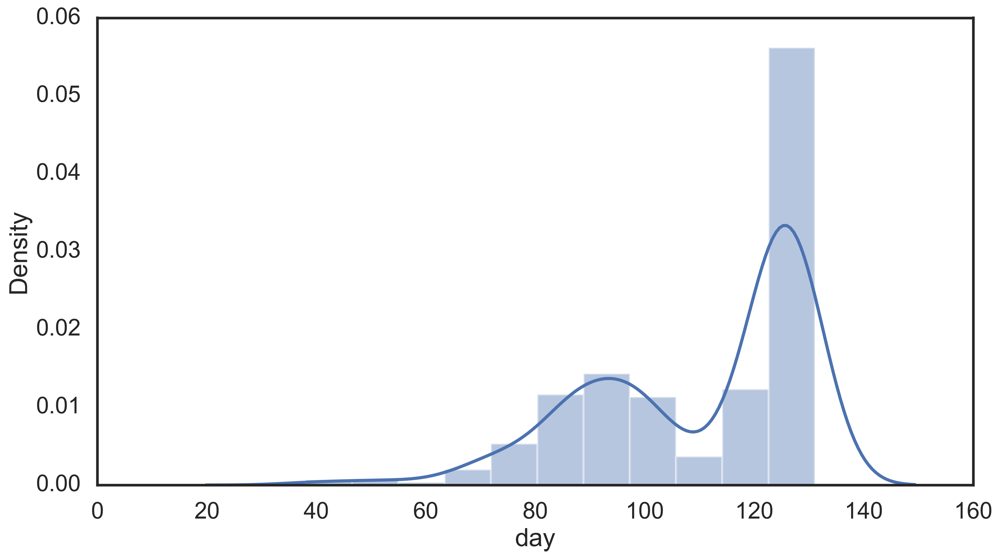

In [17]:
sns.distplot(dfdecline.groupby('experiment_sample')['day'].max()) #.sort_values()

In [18]:

num_params_lst = [
    1,
    3,
    1,
#    2,
#    2,
    2,
#    2,
]
def _compute_score_model(x,m, num_params):
    res = {f'{m}_popt_{i}' : x[f'{m}_popt_{i}'].unique()[0] for i in range(3)}
    if np.isnan(res[f'{m}_popt_0']):
        res.update({
            f'rmse_{m}' : np.NaN,
            #f'rmse_{m}_60' : np.NaN,
            #f'rmse_{m}_5' : np.NaN,
            f'bic_{m}' : np.NaN,
            f'aic_{m}' : np.NaN,
        })
    else:
        #x60 = x.loc[x.day >= 60]
        #x5 = x.loc[x.day <= 5]
        n = x.shape[0]
        
        mse = metrics.mean_squared_error(x['FL'], x[m])
        
        res.update({
            f'rmse_{m}' : np.sqrt(mse),
            #f'rmse_{m}_60' : np.sqrt(metrics.mean_squared_error(x60['FL'], x60[m])) if x60.shape[0]>2 else np.NaN,
            #f'rmse_{m}_5' : np.sqrt(metrics.mean_squared_error(x5['FL'], x5[m])),
            f'bic_{m}' : n * np.log(mse) + num_params * np.log(n),
            f'aic_{m}' : n * np.log(mse) + 2 * num_params,
        })
    return res

def _compute_r2(x):
    res_list = [_compute_score_model(x,m,n) for m,n in zip(models, num_params_lst)]
    res =dict()
    for i in res_list:
        res.update(i)
    return pd.Series(res)
groupcols = ['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture', ]
dfscore = dfdecline.groupby(groupcols).apply(_compute_r2).reset_index()

In [19]:
dfscore.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,weibull_popt_2,rmse_weibull,bic_weibull,aic_weibull,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,rmse_harmonic,bic_harmonic,aic_harmonic
0,"e1, 10A",e1,10A,MIT0604,DE,Co_Culture,0.141021,1.0,1.0,0.464884,...,0.5,0.322152,-174.602362,-176.971810,0.296513,0.5,0.5,0.258618,-204.940841,-209.679737
1,"e1, 10B",e1,10B,MIT0604,DE,Co_Culture,0.142509,0.5,0.5,0.502003,...,1.0,0.327495,-172.003378,-174.372826,0.251377,1.0,1.0,0.292172,-185.666056,-190.404952
2,"e1, 10C",e1,10C,MIT0604,DE,Co_Culture,0.164214,0.5,0.5,0.438341,...,0.5,0.357230,-158.271697,-160.641145,0.339183,0.5,0.5,0.242214,-215.294304,-220.033199
3,"e1, 11A",e1,11A,MED4,DE1,Co_Culture,0.101841,1.0,1.0,0.390940,...,0.5,0.333052,-171.531063,-173.913089,0.281051,0.5,0.5,0.290267,-189.148614,-193.912667
4,"e1, 11B",e1,11B,MED4,DE1,Co_Culture,0.125338,1.0,1.0,0.433475,...,0.5,0.254336,-211.948369,-214.317817,0.352388,0.5,0.5,0.174111,-267.454893,-272.193789


In [20]:
flipmask = dfscore['biexponential_popt_0'] < dfscore['biexponential_popt_1']
dfscore['f'] = dfscore['biexponential_popt_2']
dfscore['a1'] = dfscore['biexponential_popt_0']
dfscore['a2'] = dfscore['biexponential_popt_1']
dfscore.loc[flipmask, 'f'] = 1 - dfscore.loc[flipmask, 'f']
dfscore.loc[flipmask, 'a1'] = dfscore.loc[flipmask, 'biexponential_popt_1']
dfscore.loc[flipmask, 'a2'] = dfscore.loc[flipmask, 'biexponential_popt_0']

In [21]:
def compute_weibull_td(d, a, n):
    return np.power(-np.log(1/np.power(10,d))/a, 1/n)

dfscore['weibull_n'] = dfscore['weibull_popt_1']
dfscore['weibull_a'] = dfscore['weibull_popt_0']
dfscore['weibull_td'] = dfscore.apply(
    lambda x: compute_weibull_td(d=1, a=x['weibull_a'], n=x['weibull_n']), axis=1)
dfscore['weibull_td2'] = dfscore.apply(
    lambda x: compute_weibull_td(d=2, a=x['weibull_a'], n=x['weibull_n']), axis=1)



In [22]:
dfscore.nlargest(10, 'weibull_td')

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,rmse_harmonic,bic_harmonic,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2
85,"e1, 9C",e1,9C,Natl2A,DE,Co_Culture,0.234706,0.5,0.5,1.122694,...,0.839906,-19.798816,-24.612255,0.716439,0.588139,0.003545,0.075386,1.073296,24964.529066,2.457603e+08
84,"e1, 9B",e1,9B,Natl2A,DE,Co_Culture,0.223390,0.5,0.5,1.163430,...,0.868803,-14.251321,-19.064760,0.693144,0.649424,0.005178,0.100899,1.001450,3834.078062,3.691072e+06
14,"e1, 14C",e1,14C,Natl2A,DE1,Co_Culture,0.055246,0.5,0.5,1.074270,...,0.705528,-48.391297,-53.204736,0.694792,0.463138,0.004161,0.150188,0.789420,1245.973194,1.258536e+05
83,"e1, 9A",e1,9A,Natl2A,DE,Co_Culture,0.189229,0.5,0.5,1.193269,...,0.866871,-14.616469,-19.429907,0.626464,0.604114,0.006976,0.177822,0.686907,899.866512,4.436616e+04
45,"e1, 24A",e1,24A,Natl2A,ATCC,Co_Culture,0.022873,1.0,1.0,0.670874,...,0.518546,-100.179033,-105.016715,0.543890,0.359950,0.007186,0.253673,0.428035,759.671511,1.167649e+04
13,"e1, 14B",e1,14B,Natl2A,DE1,Co_Culture,0.027536,1.0,1.0,1.065211,...,0.646336,-62.762069,-67.575508,0.663252,0.544981,0.006225,0.181048,0.707828,675.403069,3.106478e+04
47,"e1, 24C",e1,24C,Natl2A,ATCC,Co_Culture,0.026412,1.0,1.0,0.714253,...,0.469686,-115.119784,-119.933223,1.000000,0.141041,0.057839,0.242417,0.536714,406.469644,7.092739e+03
27,"e1, 19A",e1,19A,Natl2A,BS11,Co_Culture,0.020703,1.0,1.0,0.919868,...,0.715118,-46.823405,-51.661086,0.505135,0.817046,0.009609,0.291966,0.407898,375.397169,4.032134e+03
131,"e3, 25C",e3,25C,MIT0604,ATCC,Co_Culture,0.077745,1.0,1.0,0.194547,...,0.125439,-298.630670,-303.238800,0.752263,0.471900,0.004935,0.166035,0.881868,323.885407,2.105944e+04
12,"e1, 14A",e1,14A,Natl2A,DE1,Co_Culture,0.030155,0.5,0.5,0.803114,...,0.436562,-128.747435,-133.585116,0.700497,0.320191,0.005709,0.230076,0.615633,309.040866,6.286480e+03


In [23]:
dfscore.to_pickle('exponential_decline.pkl.gz')

In [24]:
values = [f'rmse_{m}' for m in models]
#values += [f'bic_{m}' for m in models]
values += [f'aic_{m}' for m in models]
values +=  ['f', 'a1', 'a2',]
values +=  ['weibull_td2', 'weibull_a', 'weibull_n']

dfscorem = dfscore.melt(id_vars=['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture'],
                        value_vars=values +  ['f', 'a1', 'a2',
                                   ], 
                        value_name='RMSE',
                        var_name='model')


In [25]:
dfscorem['s'] = dfscorem['sample'] +', '+ dfscorem.ALT
dfscorem['e'] = dfscorem['experiment'] +', '+ dfscorem.culture
dfscorem['p'] = dfscorem['PRO'] 
dfscorem.loc[dfscorem.culture == 'Axenic', 'p'] =dfscorem.loc[dfscorem.culture == 'Axenic', 'p']+ ' Axenic'



In [26]:
cols = [f'rmse_{m}' for m in models]
dfscore.groupby('culture')[cols].agg(['count', np.mean, np.std])# .describe().T

rmse_exponential                     rmse_biexponential            \
                      count      mean       std              count      mean   
culture                                                                        
Axenic                   13  0.257939  0.110183                 13  0.257944   
Co_Culture              343  0.286259  0.212156                343  0.158581   

                     rmse_weibull                     rmse_harmonic            \
                 std        count      mean       std         count      mean   
culture                                                                         
Axenic      0.110184           13  0.142497  0.079291            13  0.504903   
Co_Culture  0.118097          343  0.179886  0.109168           343  0.191028   

                      
                 std  
culture               
Axenic      0.188740  
Co_Culture  0.134831

In [27]:
cols = ['weibull_td2', 'weibull_a', 'weibull_n']
cols = ['weibull_td2',]
dfscore.loc[dfscore.weibull_td2 < 3001].groupby(['culture','PRO',# 'experiment'
                                                ])[cols].agg(['count', np.mean, np.std, np.median])# .describe().T

weibull_td2                                    
                         count        mean         std      median
culture    PRO                                                    
Axenic     MED4              3   17.814323    1.248159   17.990082
           MIT0604           1    9.320176         NaN    9.320176
           MIT9312           3    7.844961    0.773217    7.464911
           MIT9313           3   11.719806    1.107783   11.463443
           Natl2A            3   14.009951    1.061243   14.491020
Co_Culture MED4             67  192.350371   90.788542  166.462461
           MIT0604          63  324.313293  352.777565  157.784385
           MIT9312          71  284.146138  268.605007  209.885100
           MIT9313          66  251.674912  353.608965  137.814739
           Natl2A           61  554.905238  429.180437  383.692076

In [28]:
Models = [m.capitalize() for m in models ]

Text(0.5, 1, 'Root Mean Square Error per Model')

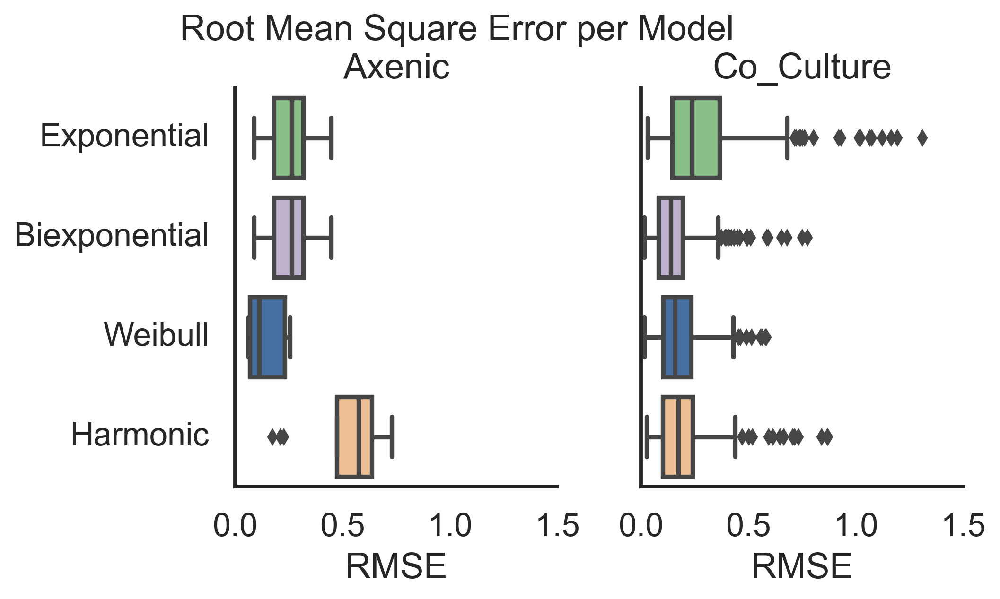

In [29]:
cols = [f'rmse_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols)], 
                y='model', x='RMSE', #hue='PRO', kind='swarm', #aspect=2,
                kind='box',
                order=cols,
                palette=mpalette,
           #palette='cubehelix'
            col='culture', col_order=['Axenic', 'Co_Culture'],
                height=4,
).set_axis_labels('RMSE', '').set(yticklabels=Models, 
    xticks=[0,0.5,1,1.5]
                                     ).set_titles('{col_name}')# .set(font_scale=2)

plt.suptitle('Root Mean Square Error per Model', y=1)


Text(0.5, 1, 'AIC per Model')

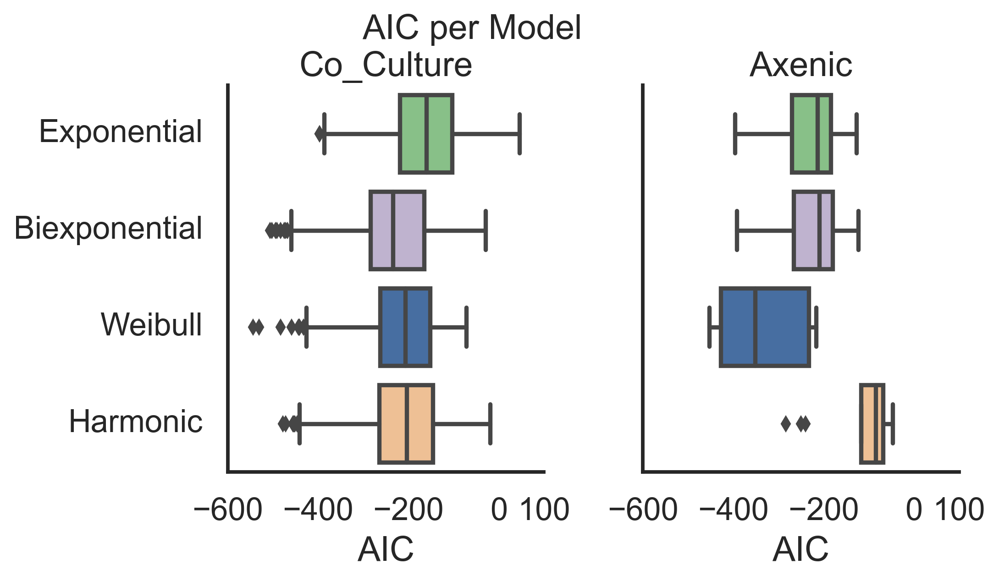

In [30]:
cols = [f'aic_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols)], 
                y='model', x='RMSE', #hue='PRO', kind='swarm', #aspect=2,
                kind='box',
                palette=mpalette,
                height=4,
            col='culture',
).set_axis_labels('AIC','').set(xticks=[-600, -400, -200, 0, 100], yticklabels=Models, 
                                     ).set_titles('{col_name}')# .set(font_scale=2)

#g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('AIC per Model', y=1)

Text(0.5, 1, 'Root Mean Square Error per PRO (co-cultures)')

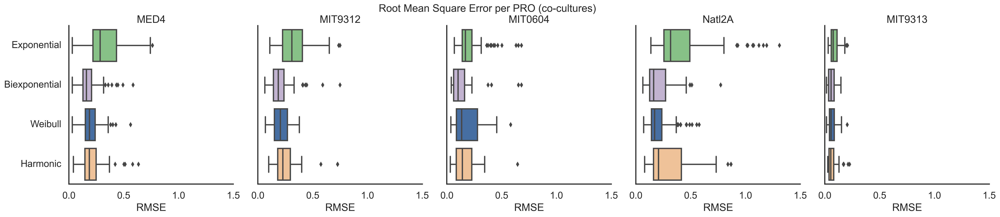

In [31]:
cols = [f'rmse_{m}' for m in models]
sns.set_context('talk')
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & dfscorem.culture.isin(['Axenic', 'Co_Culture'])]
                , y='model', x='RMSE', 
                col='PRO', col_order=porder,# palette=ppallete,
                kind='box', #aspect=2,
                #height=3, aspect=1,
                palette=mpalette,
).set_axis_labels('RMSE','').set(xticks=[0,0.5,1,1.5], yticklabels=Models, 
                                     ).set_titles('{col_name}')# .set(font_scale=2)
#g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('Root Mean Square Error per PRO (co-cultures)', y=1)

Text(0.5, 1, 'AIC per model')

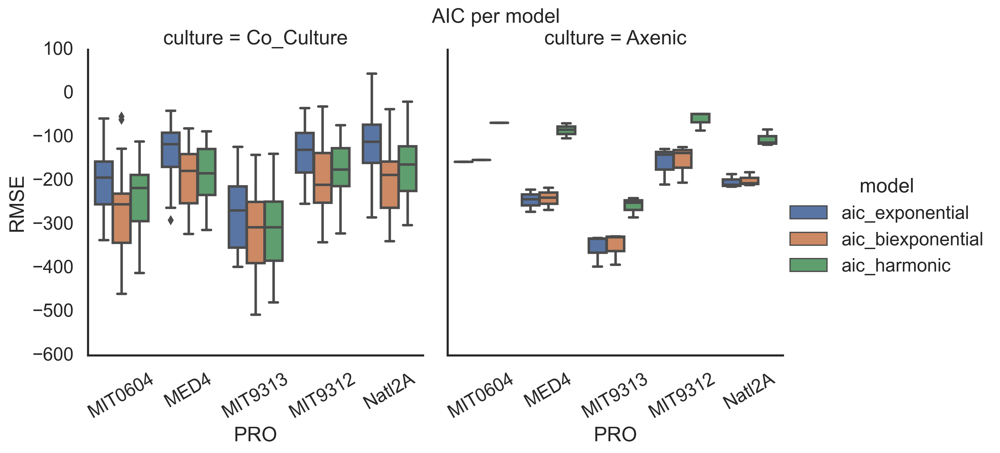

In [32]:
cols=['aic_exponential',# 'rmse_hyperbolic', 
                                    'aic_biexponential',
      'aic_harmonic'
      
      #'rmse_harmonic', 
      #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60',
      #'mse_exponential_5', 'mse_hyperbolic_5', 'mse_harmonic_5'
] 

g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & dfscorem.culture.isin(['Axenic', 'Co_Culture'])]
                , hue='model', y='RMSE', x='PRO',
                kind='box', #aspect=2,
           #palette='cubehelix'
            col='culture',
           )
g.set_xticklabels(rotation=30)
#plt.xticks(rotation=45)
plt.suptitle('AIC per model', y=1)

In [33]:
dfscorem.model.value_counts()

a2                    712
f                     712
a1                    712
rmse_weibull          356
weibull_n             356
aic_harmonic          356
rmse_exponential      356
aic_weibull           356
weibull_td2           356
aic_biexponential     356
weibull_a             356
aic_exponential       356
rmse_biexponential    356
rmse_harmonic         356
Name: model, dtype: int64

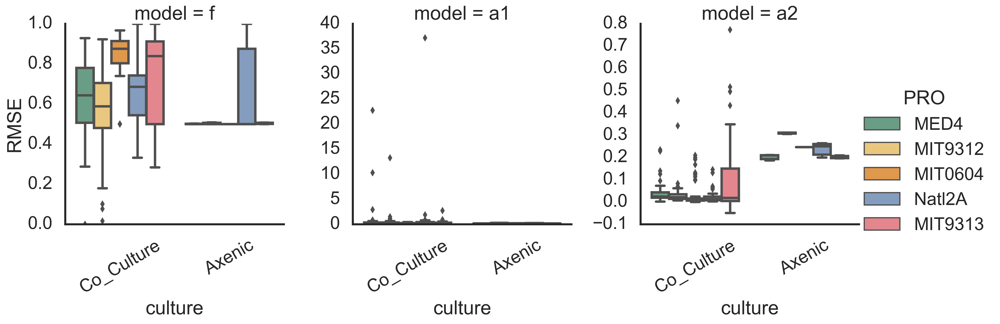

In [34]:
sns.set_context('poster')
cols= ['f', 'a1', 'a2']
g = sns.catplot(data=dfscorem.loc[dfscorem.model.isin(cols) & 
                                  dfscorem.culture.isin(['Axenic', 'Co_Culture'])],
                col='model',
                y='RMSE', #x='PRO',
                kind='box', #aspect=1,
            x='culture',
                #height=5, 
                             hue='PRO', hue_order=porder, palette=ppallete,
             #s=10,
             #   style='PRO', style_order=porder, markers=pmarkers,
            #    size='PRO', size_order=porder, sizes=psizes,
                sharey=False,
                #facet_kws={'sharey': False}
                aspect=1

           )
g.set_xticklabels(rotation=30)
#g.set_ylabels('rotation=30')

#plt.xticks(rotation=45)
#plt.suptitle('fraction of persistor cells', y=1)

In [35]:
dfscore.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,rmse_harmonic,bic_harmonic,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2
0,"e1, 10A",e1,10A,MIT0604,DE,Co_Culture,0.141021,1.0,1.0,0.464884,...,0.258618,-204.940841,-209.679737,0.863408,0.374863,0.008879,0.259722,0.896868,37.725443,544.100668
1,"e1, 10B",e1,10B,MIT0604,DE,Co_Culture,0.142509,0.5,0.5,0.502003,...,0.292172,-185.666056,-190.404952,0.843629,0.380370,0.009144,0.264545,0.838354,45.567042,625.988060
2,"e1, 10C",e1,10C,MIT0604,DE,Co_Culture,0.164214,0.5,0.5,0.438341,...,0.242214,-215.294304,-220.033199,0.869769,0.365484,0.008610,0.235531,1.007286,33.456743,634.710276
3,"e1, 11A",e1,11A,MED4,DE1,Co_Culture,0.101841,1.0,1.0,0.390940,...,0.290267,-189.148614,-193.912667,0.824206,0.170692,0.021516,0.549802,0.342589,31.987654,112.851280
4,"e1, 11B",e1,11B,MED4,DE1,Co_Culture,0.125338,1.0,1.0,0.433475,...,0.174111,-267.454893,-272.193789,0.500000,0.125335,0.125335,0.458725,0.503584,27.484170,124.541516


In [36]:
dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])].groupby('culture')['f'].describe()

,count,mean,std,min,25%,50%,75%,max
culture,,,,,,,,
Axenic,13.0,0.540238,0.138173,4.999390e-01,0.5,0.500075,0.503906,1.0
Co_Culture,343.0,0.687331,0.193039,9.128377e-09,0.5,0.705375,0.854955,1.0


In [37]:
dfscore.loc[dfscore.culture.isin(['Co_Culture'])].groupby('experiment')['f'].describe()

,count,mean,std,min,25%,50%,75%,max
experiment,,,,,,,,
e1,73.0,0.673671,0.168786,2.348212e-01,0.505135,0.693144,0.839246,1.000000
e3,69.0,0.696325,0.160396,3.970819e-01,0.550282,0.705375,0.811017,0.956613
e4,72.0,0.786872,0.157379,4.677703e-01,0.687896,0.853180,0.903480,1.000000
e5,64.0,0.628730,0.232361,9.128377e-09,0.500000,0.593192,0.830025,1.000000
e6,65.0,0.640566,0.204981,1.660156e-02,0.500000,0.668933,0.769468,0.986052


In [38]:
dfscore.loc[dfscore.culture.isin(['Co_Culture']) & (dfscore.f <0.9)].nlargest(10, 'a1')


,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,rmse_harmonic,bic_harmonic,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2
251,"e5, 19A",e5,19A,Natl2A,BS11,Co_Culture,0.026368,0.5,0.5,0.467425,...,0.414535,-88.851072,-92.865738,0.338387,37.191371,0.016414,0.555556,0.144639,145.705433,507.375577
254,"e5, 1C",e5,1C,MED4,1A3,Co_Culture,0.149385,0.5,0.5,0.161139,...,0.099334,-90.900243,-92.989288,0.357205,22.713781,0.094721,0.628991,0.346988,20.262794,60.994632
43,"e1, 23B",e1,23B,MIT9312,ATCC,Co_Culture,0.024483,1.0,1.0,0.387189,...,0.337431,-169.355335,-174.168773,0.234821,13.251643,0.018553,0.677884,0.086727,126.108172,350.603498
345,"e6, 6A",e6,6A,MED4,DE,Co_Culture,0.165374,0.5,0.5,0.483532,...,0.265728,-90.849175,-94.071010,0.643035,10.289626,0.027478,0.327419,0.672246,42.957059,356.809274
294,"e6, 11A",e6,11A,MED4,DE1,Co_Culture,0.076173,0.5,0.5,0.193177,...,0.140405,-122.579817,-125.572833,0.427508,2.935521,0.042349,0.509595,0.342392,42.093714,164.036867
284,"e5, 7C",e5,7C,MIT9313,DE,Co_Culture,0.033858,0.5,0.5,0.046343,...,0.038544,-324.242798,-328.106449,0.283887,2.739833,0.023488,0.618971,0.136714,95.797603,293.558067
332,"e6, 24C",e6,24C,Natl2A,ATCC,Co_Culture,0.074156,0.5,0.5,0.234769,...,0.140657,-122.461518,-125.454533,0.447590,1.880387,0.037608,0.486567,0.346123,49.137369,204.217501
126,"e3, 23B",e3,23B,MIT9312,ATCC,Co_Culture,0.046248,1.0,1.0,0.447226,...,0.282315,-173.567921,-178.121253,0.537388,1.508681,0.018820,0.390007,0.399723,89.094805,526.877813
314,"e6, 18A",e6,18A,MIT9312,BS11,Co_Culture,0.041190,1.0,1.0,0.108091,...,0.140793,-149.459586,-152.837345,0.100789,1.161273,0.037574,0.894774,0.060324,58.578508,127.107091
329,"e6, 23C",e6,23C,MIT9312,ATCC,Co_Culture,0.062342,0.5,0.5,0.398029,...,0.248379,-87.657714,-90.710435,0.491692,1.157812,0.035020,0.448589,0.406040,47.867193,224.438520


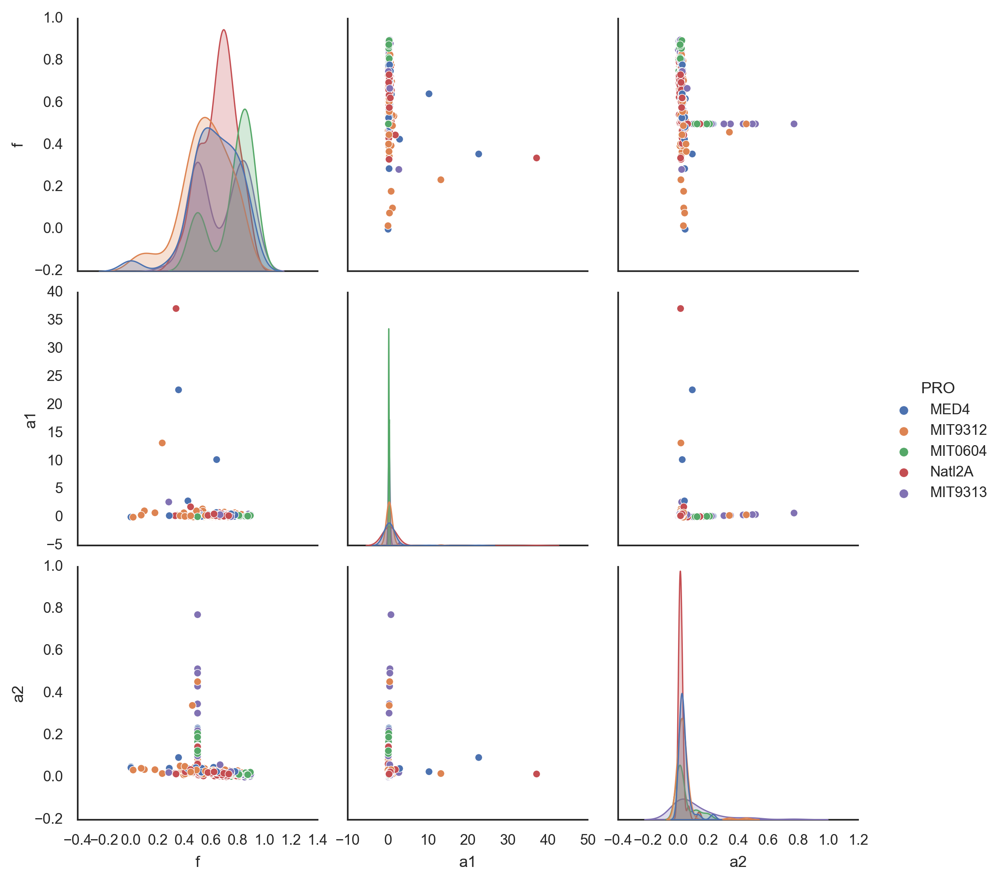

In [39]:
sns.set_context('paper')
sns.pairplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])& (dfscore.f <0.9)], 
             vars=['f', 'a1', 'a2'],
            hue='PRO', hue_order=porder)

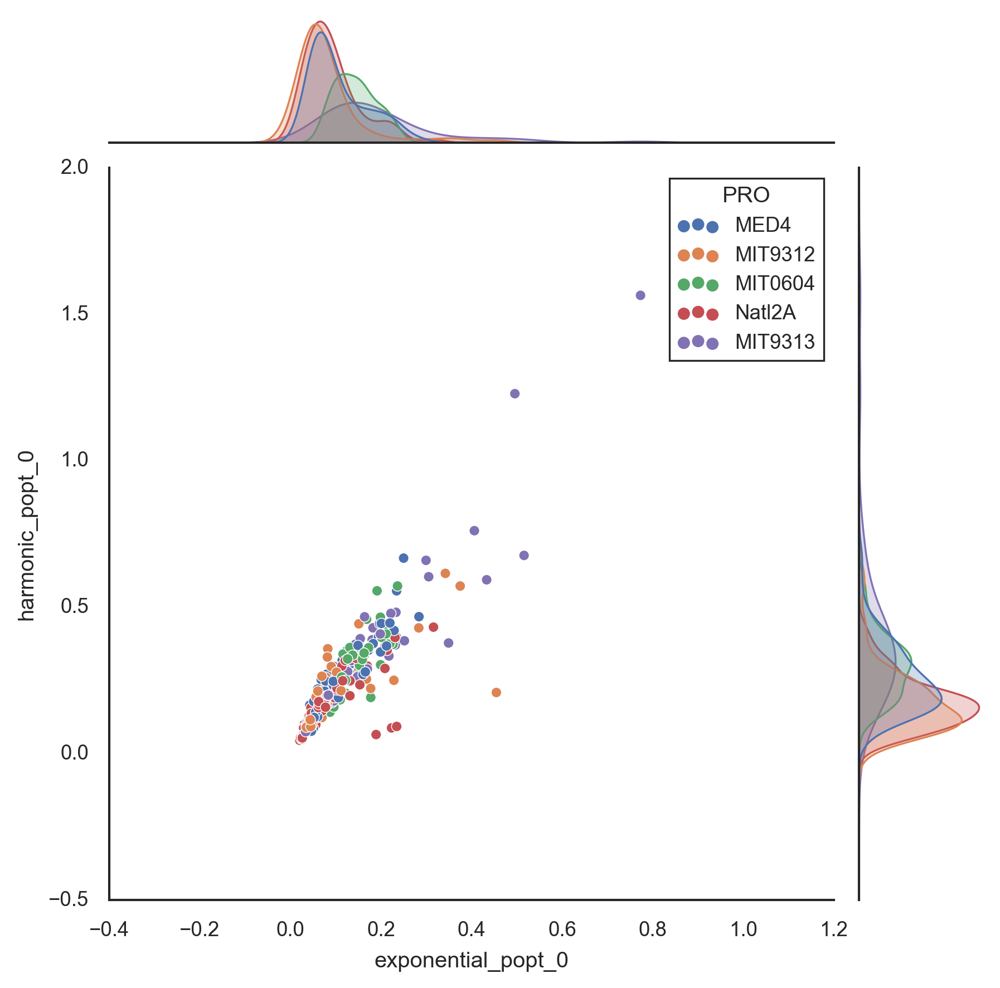

In [40]:
sns.set_context('paper')
sns.jointplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])& (dfscore.f <0.9)], 
             y='harmonic_popt_0', x='exponential_popt_0',
            hue='PRO', hue_order=porder)

In [41]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'rmse_exponential', 'bic_exponential', 'aic_exponential',
       'biexponential_popt_0', 'biexponential_popt_1', 'biexponential_popt_2',
       'rmse_biexponential', 'bic_biexponential', 'aic_biexponential',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2', 'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'f',
       'a1', 'a2', 'weibull_n', 'weibull_a', 'weibull_td', 'weibull_td2'],
      dtype='object')

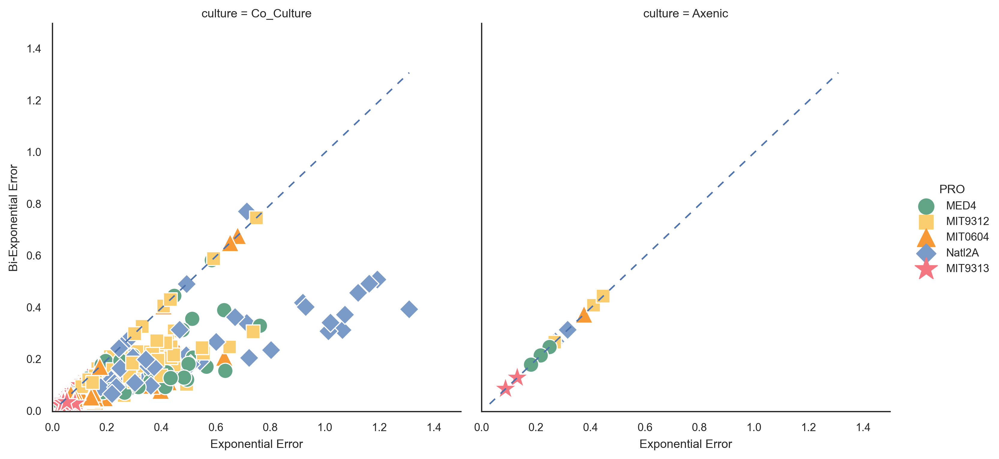

In [42]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



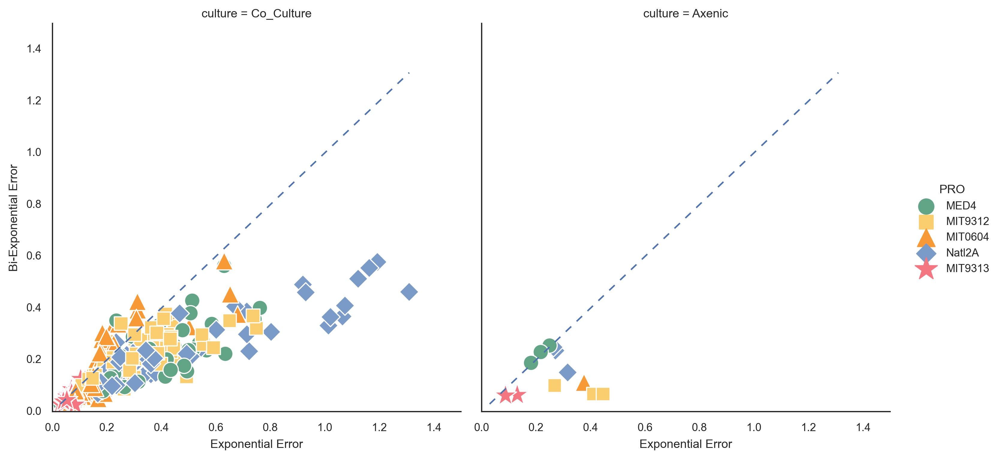

In [43]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



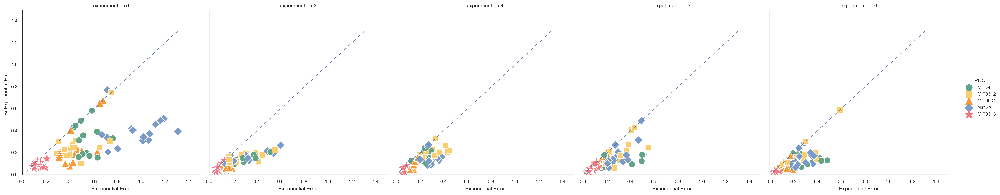

In [44]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([ 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                #col='culture',
                col='experiment',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\wosnat\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


Text(0.5, 1, 'RMSE co-culture')

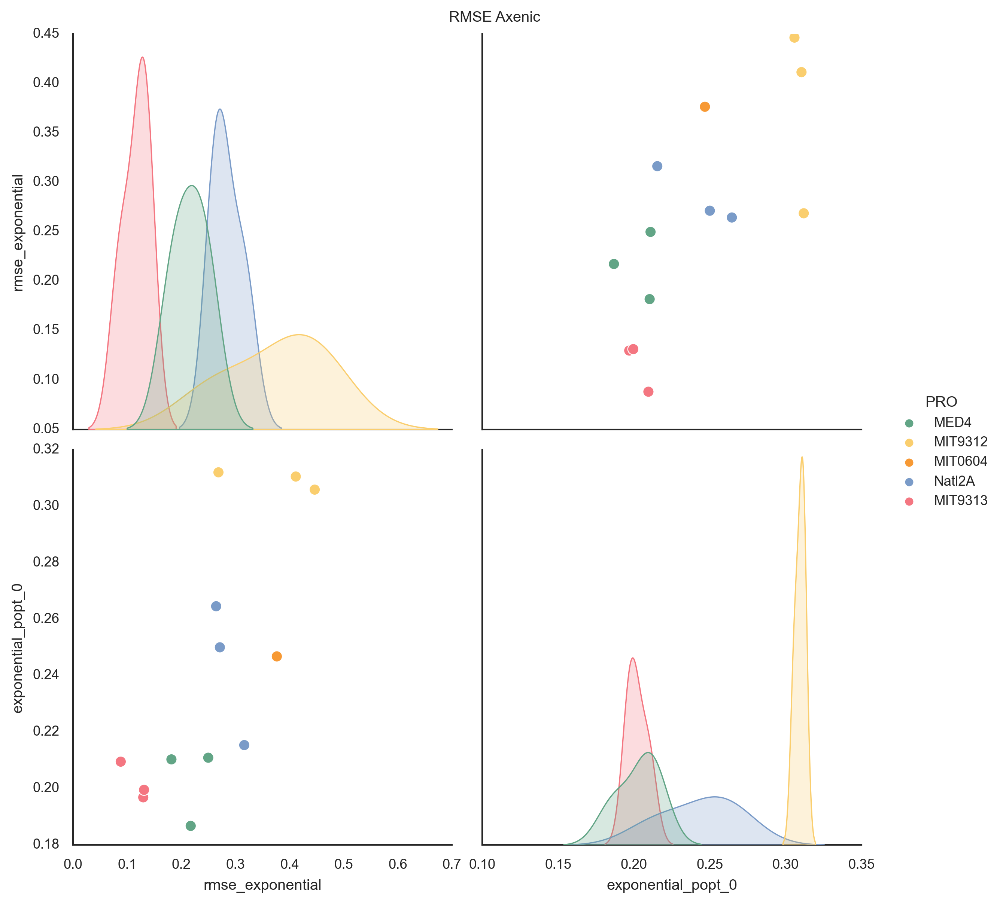

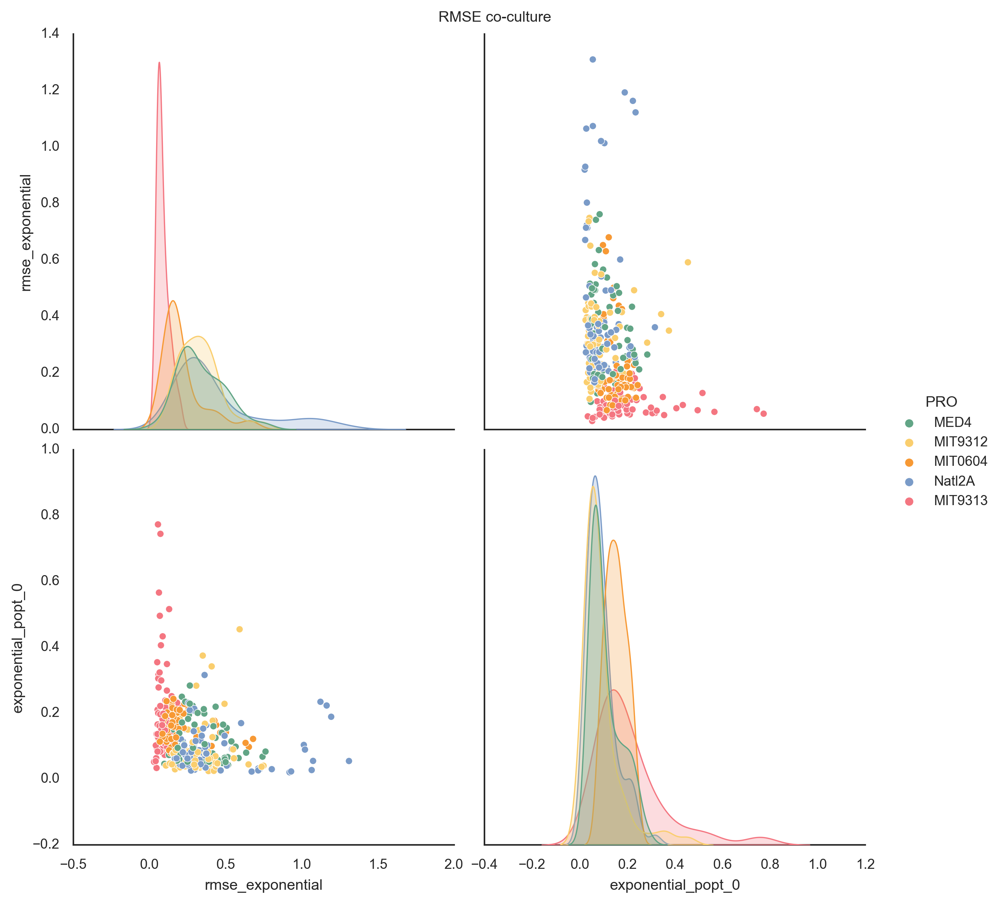

In [45]:
sns.pairplot(dfscore.loc[dfscore.culture == 'Axenic'], 
             vars=['rmse_exponential', #'rmse_hyperbolic', 
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             plot_kws={"s": 50},
             #kind='reg'
            )
plt.suptitle('RMSE Axenic', y=1)
sns.pairplot(dfscore.loc[dfscore.culture == 'Co_Culture'], 
             vars=['rmse_exponential', #'rmse_hyperbolic',
                   'exponential_popt_0',
                            #'rmse_exponential_60', 'rmse_hyperbolic_60', 'rmse_harmonic_60'
                            #'rmse_exponential_5', 'rmse_hyperbolic_5', 'rmse_harmonic_5',
                           ],
             height=4, 
             plot_kws={"s": 20},
             hue='PRO', hue_order=porder, palette=ppallete,
             #kind='reg'
            )
plt.suptitle('RMSE co-culture', y=1)


<AxesSubplot:xlabel='model', ylabel='culture-experiment'>

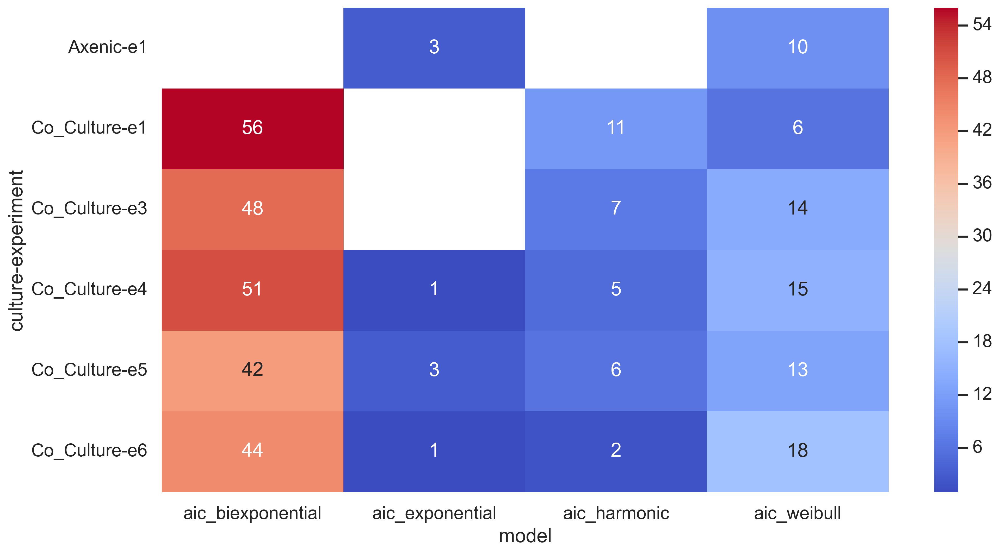

In [46]:
cols = [f'aic_{m}' for m in models]

best_model_df = dfscorem.loc[dfscorem.model.isin(cols)
                            ].sort_values('RMSE', ascending=True).drop_duplicates([
    'experiment_sample', ])
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(
    index=['culture',  'experiment'],columns=['model'], values='sample', aggfunc='count')
sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')
#best_model_df

In [47]:
dict(zip(cols,models))

{'aic_exponential': 'exponential',
 'aic_biexponential': 'biexponential',
 'aic_weibull': 'weibull',
 'aic_harmonic': 'harmonic'}

Text(0.5, 1.0, 'best model (lowest aic)')

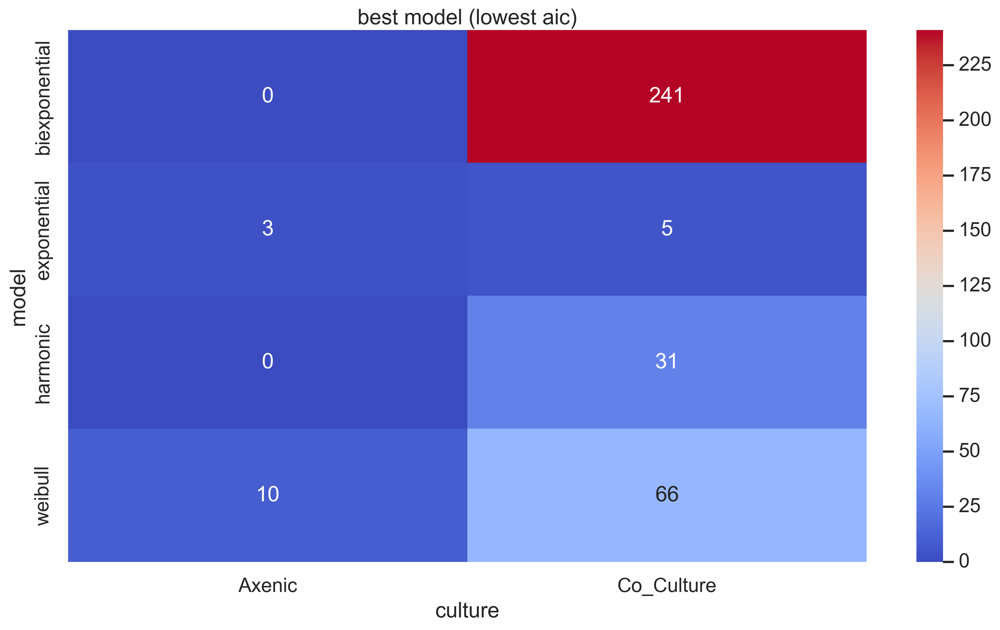

In [48]:
#best_model_df = dfscorem.loc[dfscorem.model.isin(['aic_exponential', #'aic_harmonic',
#                                                  'aic_biexponential',])
#                            ].sort_values('RMSE', ascending=True).drop_duplicates([
#    'experiment_sample', ])
cols = [f'aic_{m}' for m in models]
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture'],columns=['model'], values='sample', aggfunc='count')
t.rename(columns=dict(zip(cols, models)), inplace=True)
t.fillna(0, inplace=True)
for i in t.columns:
    t[i] = t[i].astype(int)
sns.set_context('talk')
sns.heatmap(t.T, annot=True, cmap='coolwarm', fmt='d')
plt.title('best model (lowest aic)')

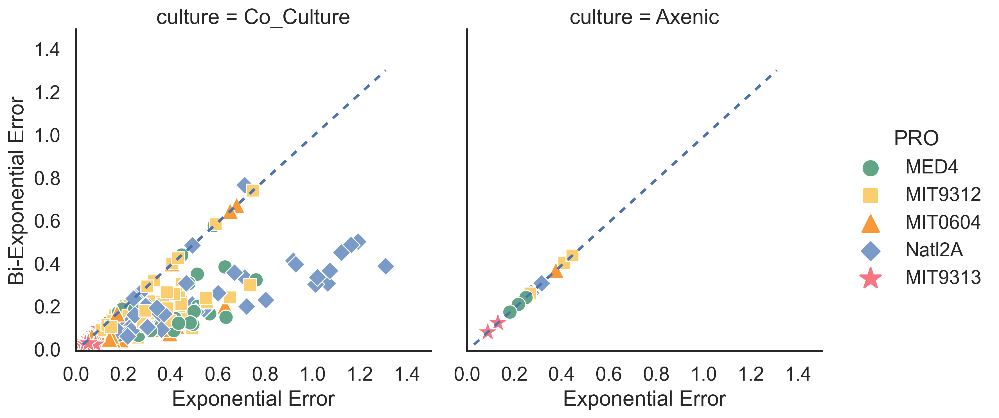

In [49]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



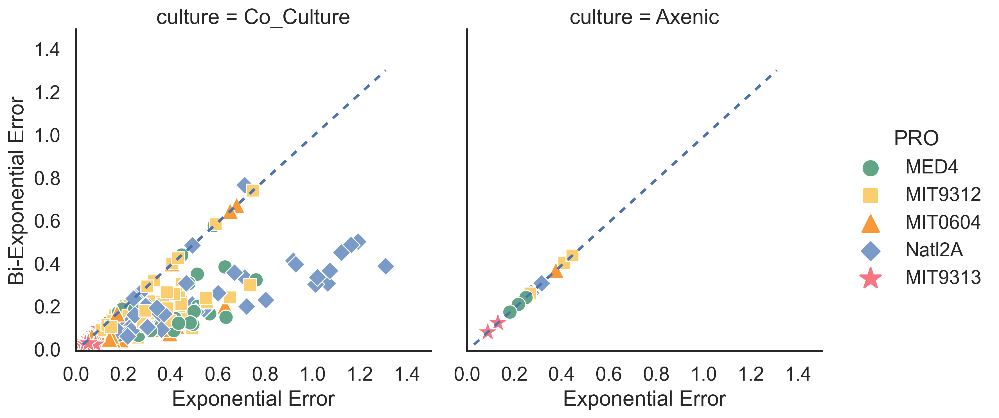

In [50]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin(['Axenic', 'Co_Culture'])], 
             x='rmse_exponential', y='rmse_biexponential',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             s=50,
                col='culture',
             #kind='reg'
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=psizes,
                facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Exponential Error', 'Bi-Exponential Error')



(0.7424568247089471, 1.4508070530397733e-63)

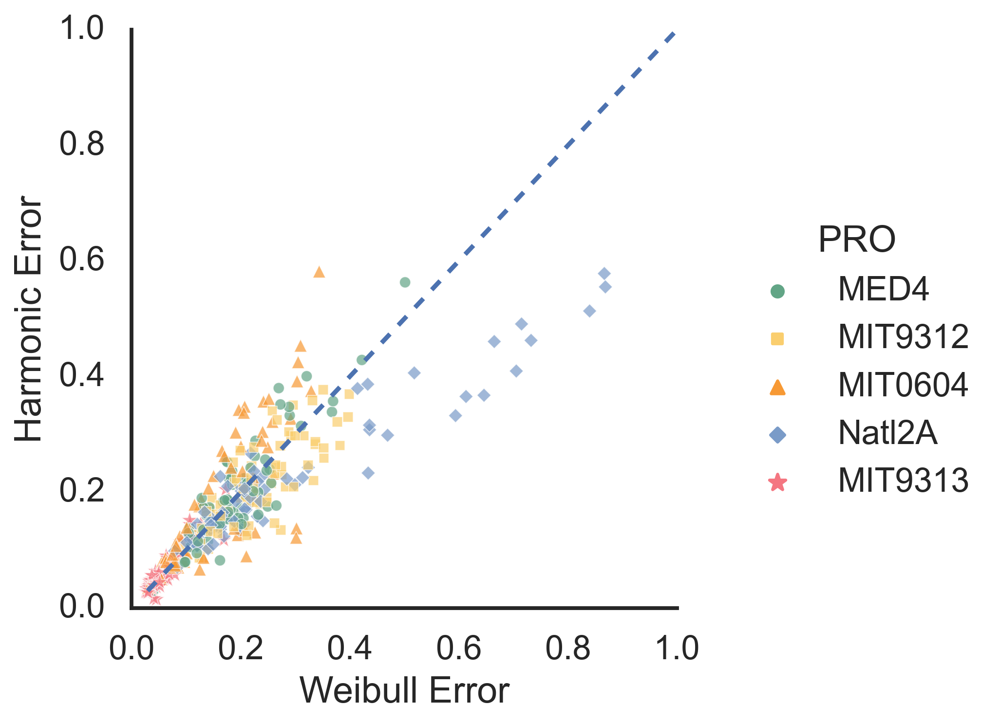

In [51]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
             x='rmse_harmonic', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s/5 for s in psizes],
                facet_kws=dict(ylim=(0,1), xlim=(0,1))
            )
g.map(sns.lineplot, x=dfscore['rmse_exponential'], y=dfscore['rmse_exponential'], linestyle='dashed' )
g.set_axis_labels('Weibull Error', 'Harmonic Error')
stats.pearsonr(dfscore.rmse_harmonic, dfscore.rmse_weibull, )


Text(0.5, 1.1, 'Weibull vs Harmonic Error (co-cultures)')

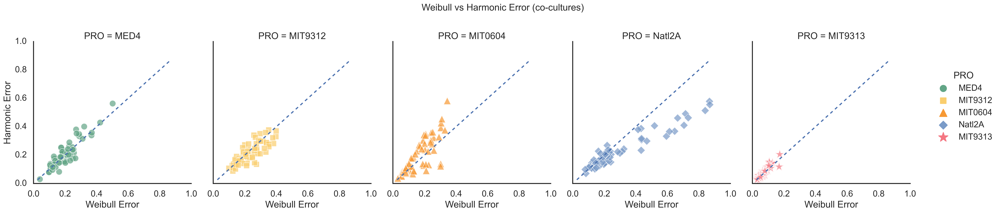

In [52]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
                col='PRO', col_order=porder,
             x='rmse_harmonic', y='rmse_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s for s in psizes],
                facet_kws=dict(ylim=(0,1), xlim=(0,1))
            )
g.map(sns.lineplot, x=dfscore['rmse_harmonic'], y=dfscore['rmse_harmonic'], linestyle='dashed' )
g.set_axis_labels('Weibull Error', 'Harmonic Error')
plt.suptitle('Weibull vs Harmonic Error (co-cultures)', y=1.1)


Text(0.5, 1.1, 'Weibull vs Harmonic AIC (co-cultures)')

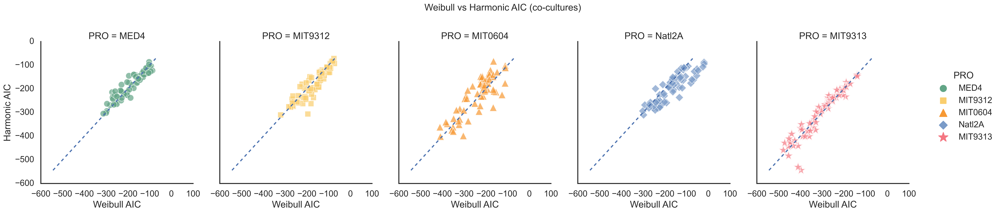

In [53]:
g = sns.relplot(data=dfscore.loc[dfscore.culture.isin([#'Axenic', 
    'Co_Culture'])], 
                col='PRO', col_order=porder,
             x='aic_harmonic', y='aic_weibull',
             #height=4, 
             hue='PRO', hue_order=porder, palette=ppallete,
             #s=2, 
                alpha=0.7,
    #            col='culture',
             #kind='reg',
            #col='experiment', col_wrap=2, col_order=['e1', 'e2', 'e4', 'e5'], 
                style='PRO', style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder, sizes=[s for s in psizes],
                #facet_kws=dict(ylim=(0,1.5), xlim=(0,1.5))
            )
g.map(sns.lineplot, x=dfscore['aic_weibull'], y=dfscore['aic_weibull'], linestyle='dashed' )
g.set_axis_labels('Weibull AIC', 'Harmonic AIC')
plt.suptitle('Weibull vs Harmonic AIC (co-cultures)', y=1.1)


Text(0.5, 1.0, 'best model fit')

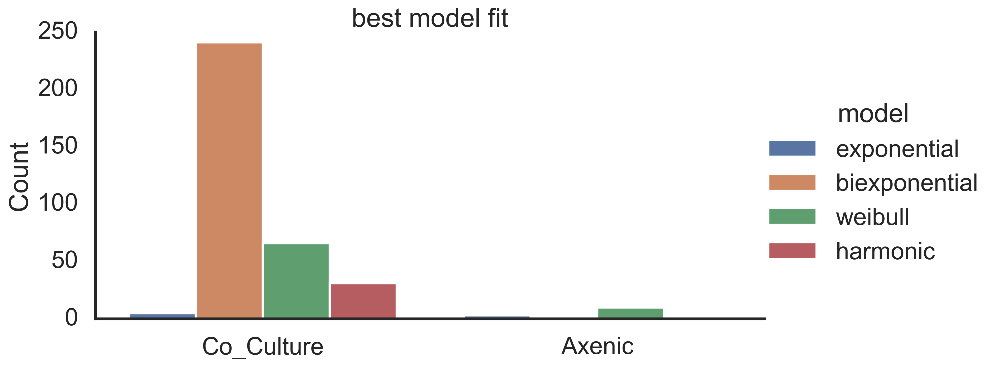

In [54]:
sns.set_context('poster')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))
#best_model_df.model = best_model_df.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
sns.catplot(data=b, x='culture', hue='model', kind='count', aspect=2, hue_order=models
            #hue_order=['exponential', 'harmonic']
).set_axis_labels('', 'Count')
#.set(xticklabels=models, 
    #yticks=[0,0.5,1,1.5]
#                                     ).set_titles('{col_name}')# .set(font_scale=2)

plt.title("best model fit")

<AxesSubplot:xlabel='model', ylabel='culture-PRO'>

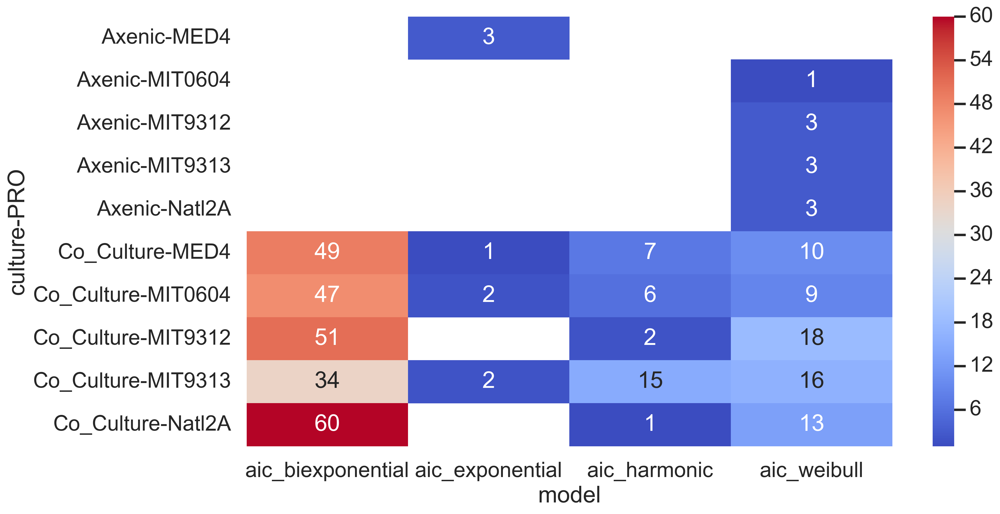

In [55]:
t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])].pivot_table(index=['culture',  'PRO', ],columns=[#'experiment', 
                                                                                                                             'model', ], values='sample', aggfunc='count')
#sns.set_context('talk')
sns.heatmap(t, annot=True, cmap='coolwarm')


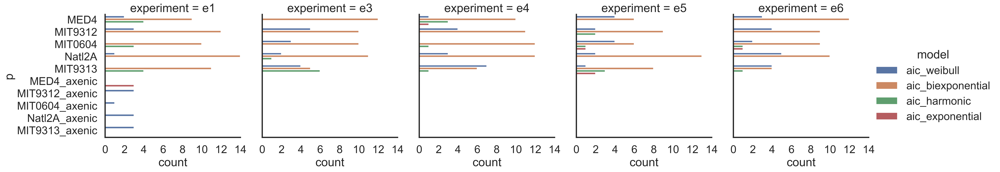

In [56]:
best_model_df['p'] = best_model_df['PRO']
best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=best_model_df, y='p', hue='model', kind='count', col='experiment',
           order=['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313', #'all', 'allP',
                     'MED4_axenic', 'MIT9312_axenic', 'MIT0604_axenic', 'Natl2A_axenic', 'MIT9313_axenic'
                     ],
            col_order=eorder,
           )


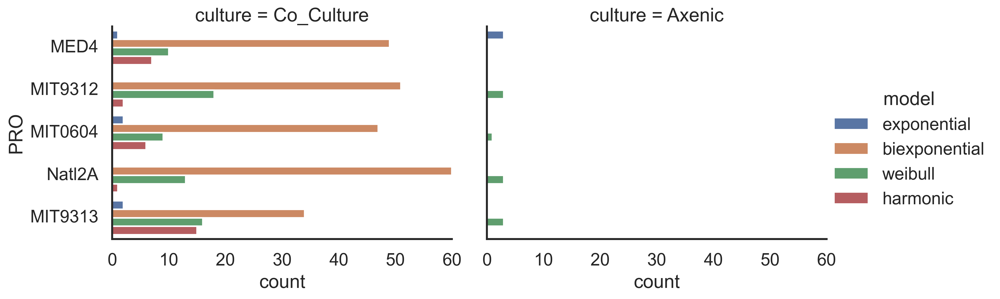

In [57]:
sns.set_context('talk')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))

#best_model_df['p'] = best_model_df['PRO']
#best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=b,
            y='PRO', hue='model', kind='count', col='culture',
           order=porder, hue_order=models,
            col_order=['Co_Culture', 'Axenic'],
            aspect=1.4, height=4
            #col_order=eorder,
           )


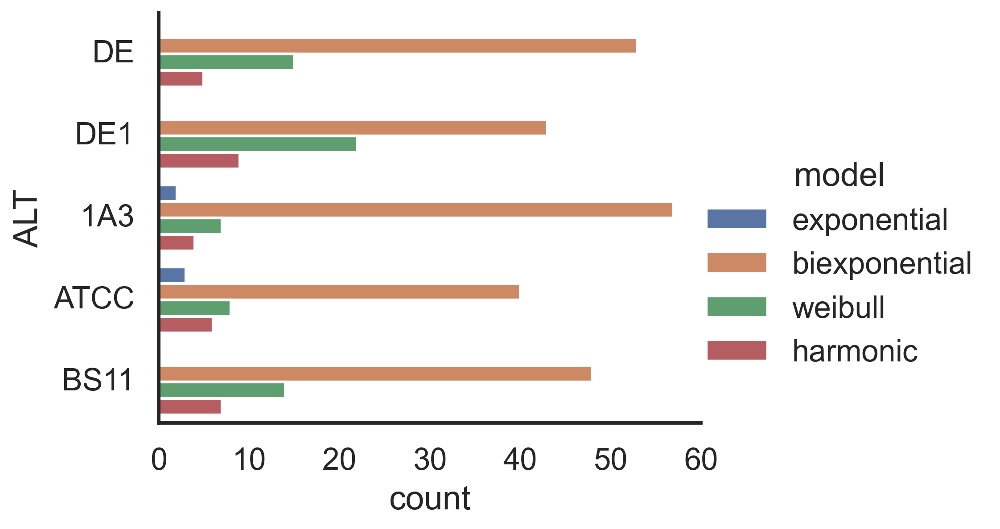

In [58]:
sns.set_context('talk')
b = best_model_df.copy()
b.model = b.model.map(dict(zip([f'aic_{m}'for m in models], models)))

#best_model_df['p'] = best_model_df['PRO']
#best_model_df.loc[best_model_df.culture == 'Axenic','p'] = best_model_df.loc[best_model_df.culture == 'Axenic','p'] + '_axenic'
sns.catplot(data=b,
            y='ALT', hue='model', kind='count', #col='culture',
           order=aorder, hue_order=models,
            #col_order=['Co_Culture', 'Axenic'],
            #row='experiment'
            aspect=1.4, height=4
            #col_order=eorder,
           )


In [59]:
best_model_df.p.unique()

array(['MIT9313', 'MIT0604', 'MIT9313_axenic', 'MIT9312_axenic',
       'MIT0604_axenic', 'MIT9312', 'Natl2A', 'MED4', 'Natl2A_axenic',
       'MED4_axenic'], dtype=object)

In [60]:
porder

['MED4', 'MIT9312', 'MIT0604', 'Natl2A', 'MIT9313']

In [61]:
best_model_df.head()

,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2297,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,aic_weibull,-544.074565,"12A, DE1","e4, Co_Culture",MIT9313
2298,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,aic_weibull,-530.704825,"12B, DE1","e4, Co_Culture",MIT9313
1912,"e3, 2A",e3,2A,MIT9313,1A3,Co_Culture,aic_biexponential,-502.090744,"2A, 1A3","e3, Co_Culture",MIT9313
1958,"e4, 17C",e4,17C,MIT9313,BS11,Co_Culture,aic_biexponential,-494.063488,"17C, BS11","e4, Co_Culture",MIT9313
1975,"e4, 22B",e4,22B,MIT9313,ATCC,Co_Culture,aic_biexponential,-491.166518,"22B, ATCC","e4, Co_Culture",MIT9313


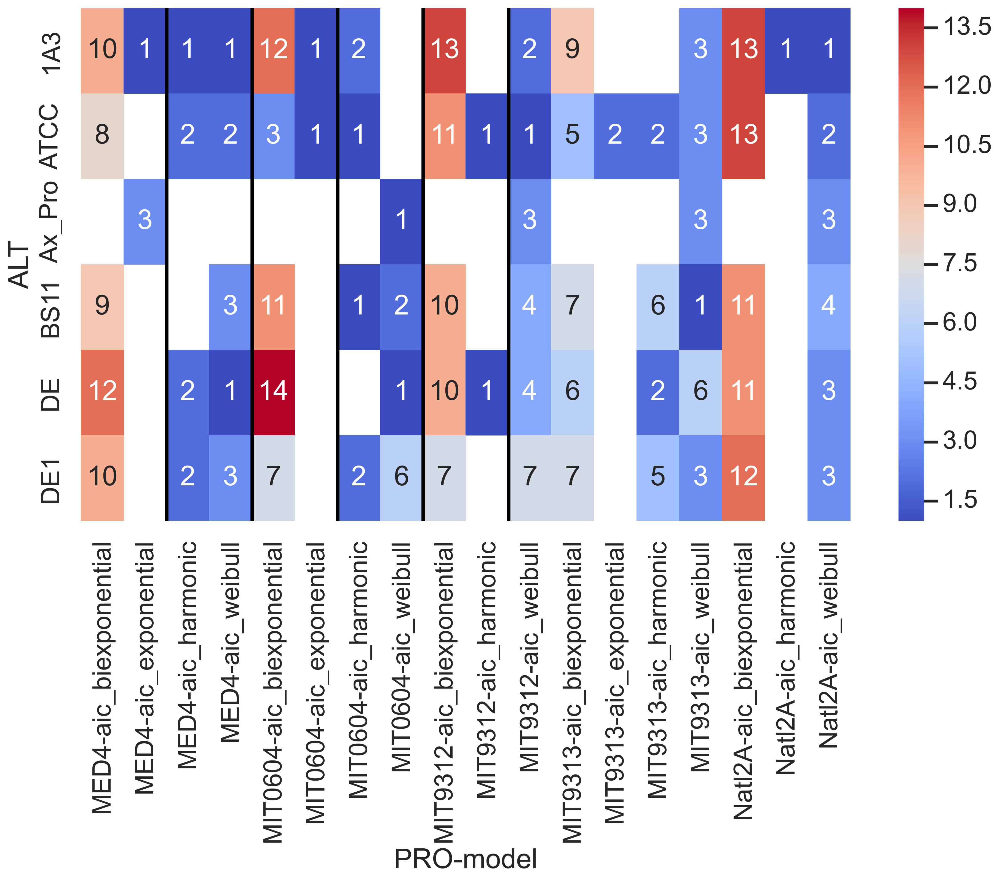

In [62]:

t = best_model_df.loc[best_model_df.culture.isin(['Axenic', 'Co_Culture'])
                     ].pivot_table(index=['ALT'], columns=['PRO','model', ], values='sample', aggfunc='count')
sns.set_context('poster')
sns.heatmap(t, annot=True, cmap='coolwarm' )
for i in [2,4,6,8,10]:
    plt.axvline(i, color='black',)


In [63]:
best_model_df['model'].value_counts()


aic_biexponential    241
aic_weibull           76
aic_harmonic          31
aic_exponential        8
Name: model, dtype: int64

In [64]:
best_model_df.head()


,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2297,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,aic_weibull,-544.074565,"12A, DE1","e4, Co_Culture",MIT9313
2298,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,aic_weibull,-530.704825,"12B, DE1","e4, Co_Culture",MIT9313
1912,"e3, 2A",e3,2A,MIT9313,1A3,Co_Culture,aic_biexponential,-502.090744,"2A, 1A3","e3, Co_Culture",MIT9313
1958,"e4, 17C",e4,17C,MIT9313,BS11,Co_Culture,aic_biexponential,-494.063488,"17C, BS11","e4, Co_Culture",MIT9313
1975,"e4, 22B",e4,22B,MIT9313,ATCC,Co_Culture,aic_biexponential,-491.166518,"22B, ATCC","e4, Co_Culture",MIT9313


In [65]:
dfscore.describe()

,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,bic_exponential,aic_exponential,biexponential_popt_0,biexponential_popt_1,biexponential_popt_2,rmse_biexponential,...,rmse_harmonic,bic_harmonic,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2
count,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,356.000000,3.560000e+02,356.000000,...,356.000000,356.000000,356.000000,3.560000e+02,356.000000,356.000000,356.000000,356.000000,3.560000e+02,3.560000e+02
mean,0.132459,0.740169,0.740169,0.285225,-168.718303,-170.772603,0.379282,0.219409,5.108605e-01,0.162209,...,0.202490,-204.969206,-209.077808,6.819600e-01,0.547380,0.051310,0.568416,0.459267,1.420989e+02,1.631729e+29
std,0.098983,0.250158,0.250158,0.209286,89.433347,89.513203,2.364740,0.741396,2.653160e-01,0.119142,...,0.148976,90.904336,91.118447,1.931531e-01,2.454171,0.090184,0.451399,0.315538,1.338346e+03,3.078740e+30
min,0.020703,0.500000,0.500000,0.029888,-394.882608,-397.131103,-0.048352,-0.001389,1.010077e-07,0.014439,...,0.026233,-473.582112,-478.079103,9.128377e-09,0.025937,-0.048352,0.006733,0.002474,1.128500e-13,4.572698e+00
25%,0.063553,0.500000,0.500000,0.145926,-218.668637,-220.619286,0.020321,0.019150,3.135528e-01,0.084943,...,0.104845,-259.290449,-263.794532,5.000000e-01,0.170649,0.010417,0.339969,0.249164,2.734536e+01,1.222953e+02
50%,0.104735,0.500000,0.500000,0.241412,-160.906561,-162.911260,0.139769,0.098665,5.000000e-01,0.138840,...,0.177176,-199.388191,-203.302145,6.959583e-01,0.266058,0.019926,0.462176,0.406009,4.139831e+01,2.030292e+02
75%,0.177287,1.000000,1.000000,0.365301,-104.224975,-106.104674,0.289037,0.277953,7.299206e-01,0.198583,...,0.248161,-137.292182,-140.552696,8.504652e-01,0.370584,0.036451,0.601750,0.618155,6.474344e+01,3.874546e+02
max,0.773035,1.000000,1.000000,1.310051,48.145187,45.750738,37.191371,13.251643,1.000000e+00,0.773667,...,0.868803,-14.251321,-19.064760,1.000000e+00,37.191371,0.772994,3.745487,2.814410,2.496453e+04,5.808954e+31


In [66]:
sns.set_context('poster')

In [67]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'rmse_exponential', 'bic_exponential', 'aic_exponential',
       'biexponential_popt_0', 'biexponential_popt_1', 'biexponential_popt_2',
       'rmse_biexponential', 'bic_biexponential', 'aic_biexponential',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2', 'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'f',
       'a1', 'a2', 'weibull_n', 'weibull_a', 'weibull_td', 'weibull_td2'],
      dtype='object')

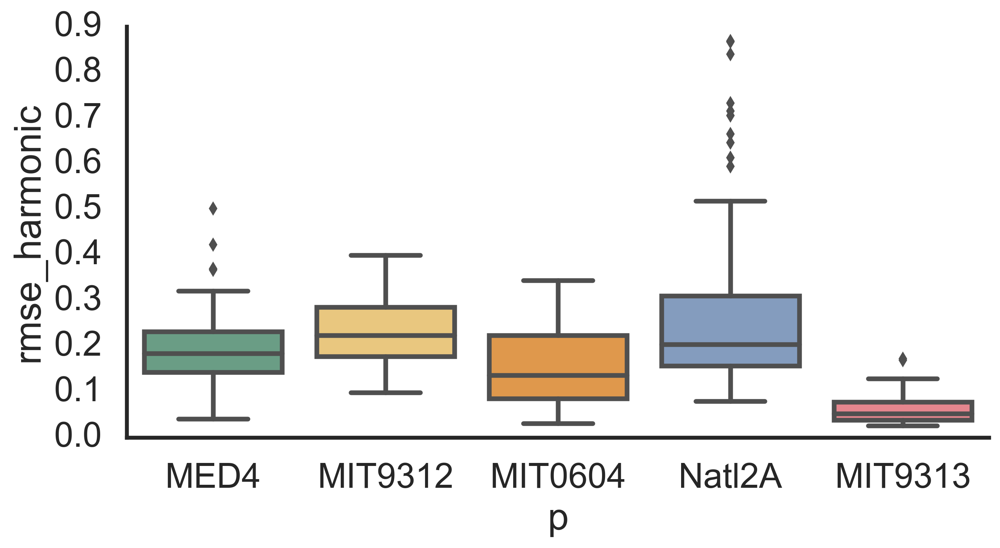

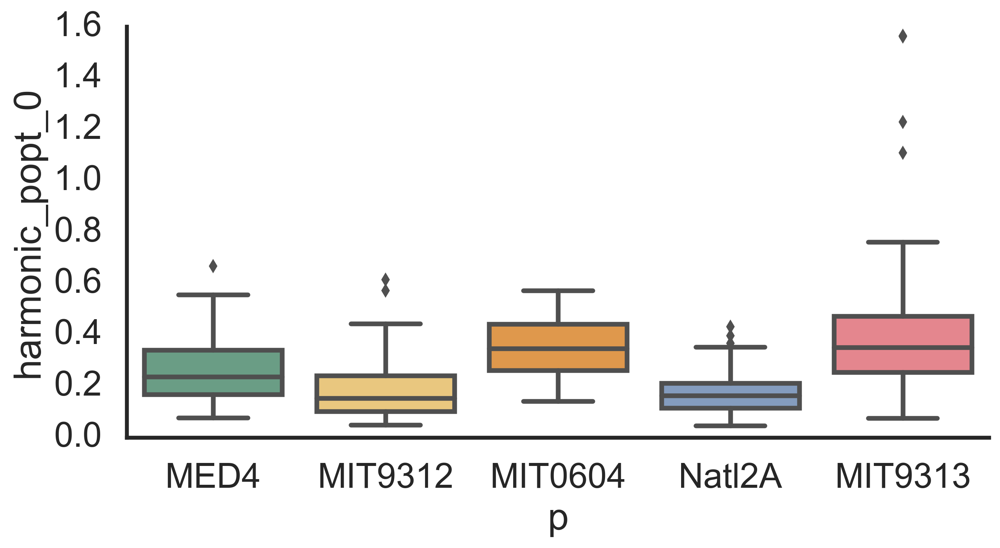

In [68]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture=='Axenic','p'] = dfscore.loc[dfscore.culture=='Axenic','p'] + '_Axenic'

for i in ['rmse_harmonic', 'harmonic_popt_0', ]:
    sns.catplot(data=dfscore.loc[dfscore.culture =='Co_Culture'], 
                x='p', y=i, kind='box',
           order=porder, palette=ppallete,
           aspect=1.8)


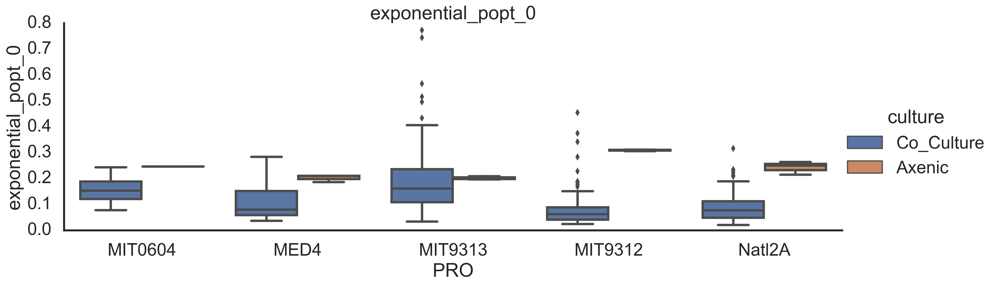

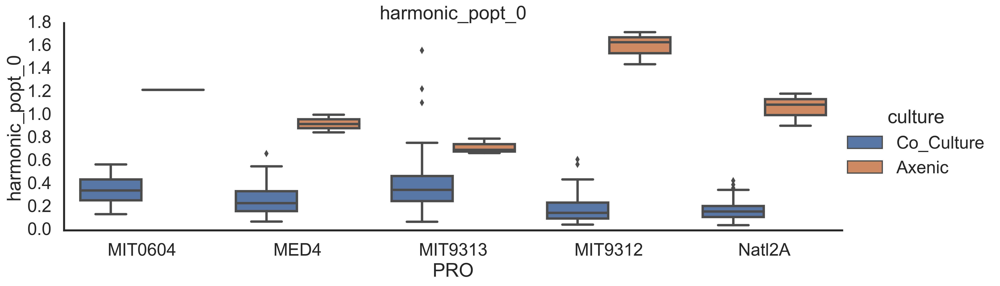

In [69]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])], 
                x='PRO', y=i, kind='box',
                hue='culture',
           #order=porder, palette=ppallete,
           aspect=3)
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    plt.title(i)


(0.0, 1.4)

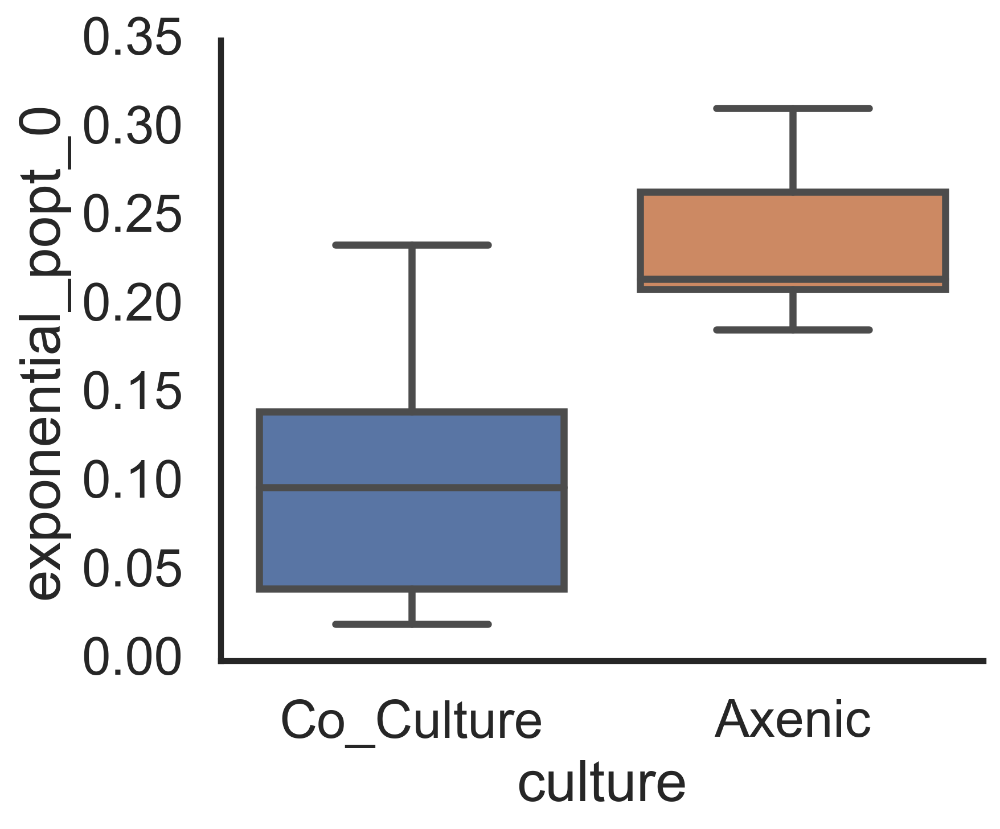

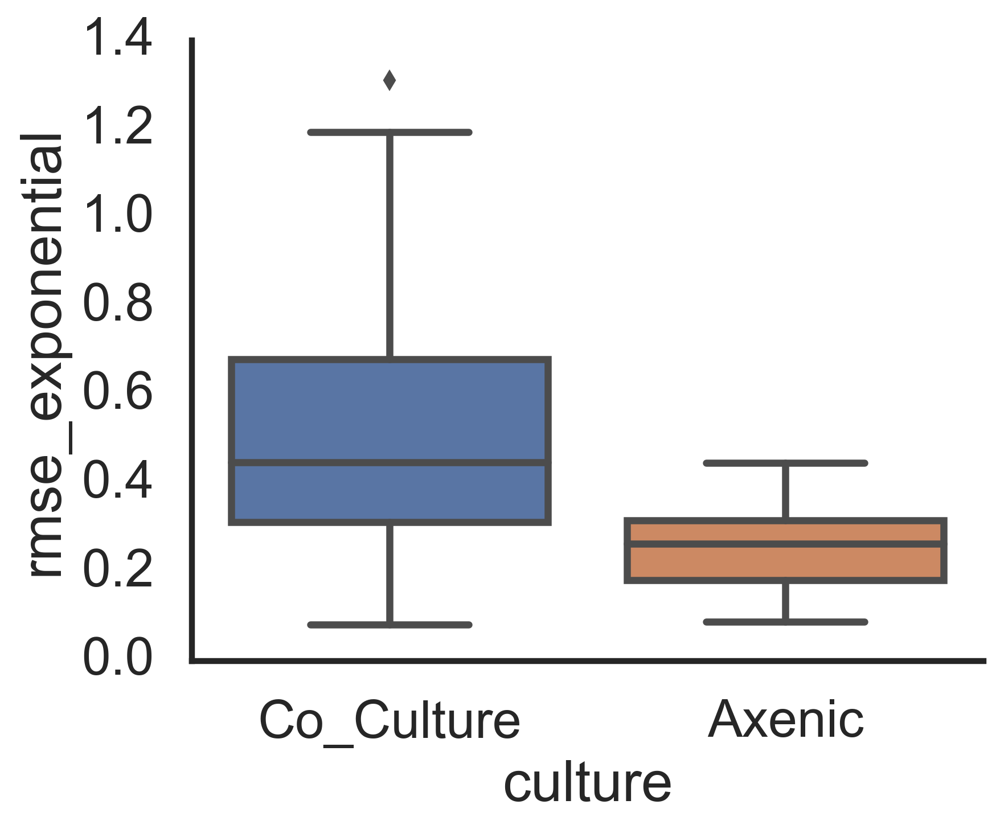

In [70]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='exponential_popt_0', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,0.35)

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                             dfscore.experiment.isin(['e1'])], 
            #x='PRO', 
            y='rmse_exponential', kind='box',
            x='culture',
       aspect=1.2
            
           )
plt.ylim(0,1.4)



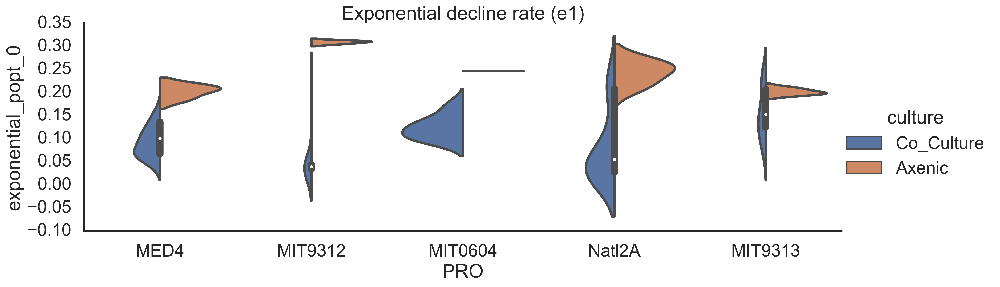

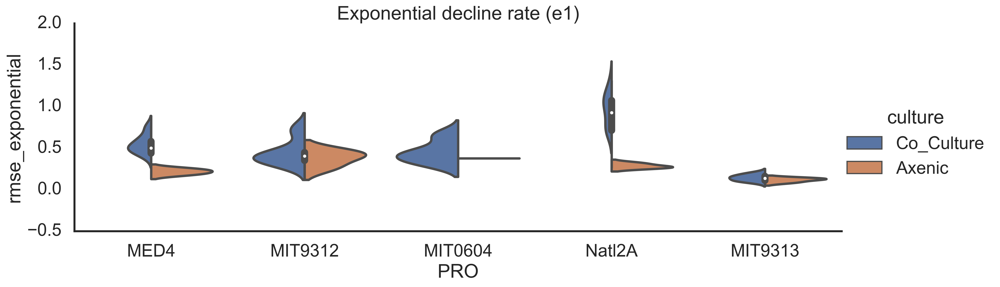

In [71]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                                 dfscore.experiment.isin(['e1'])], 
                x='PRO', 
                y=i, kind='violin',
                hue='culture',
                split=True,
           order=porder, #palette=ppallete,
           aspect=3
               )
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('Exponential decline rate (e1)')


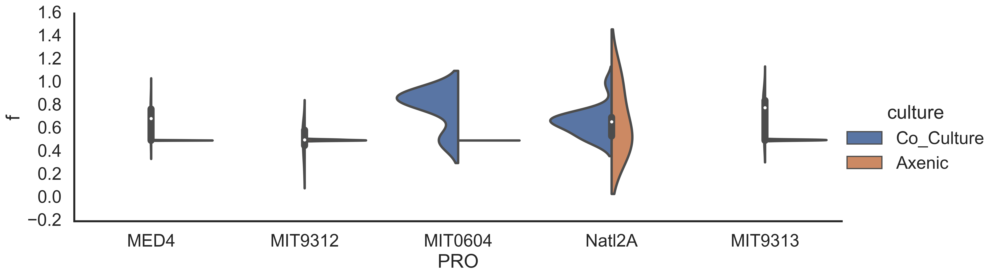

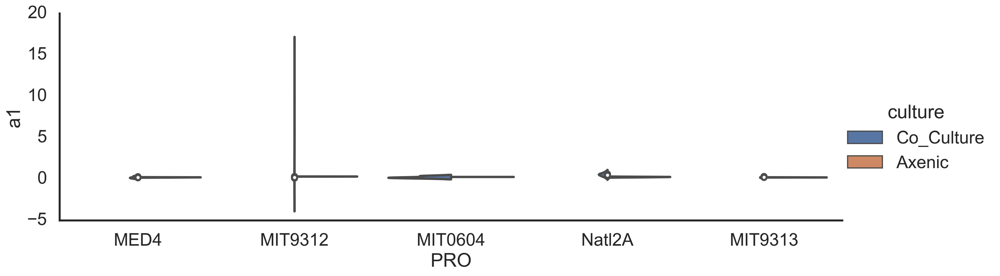

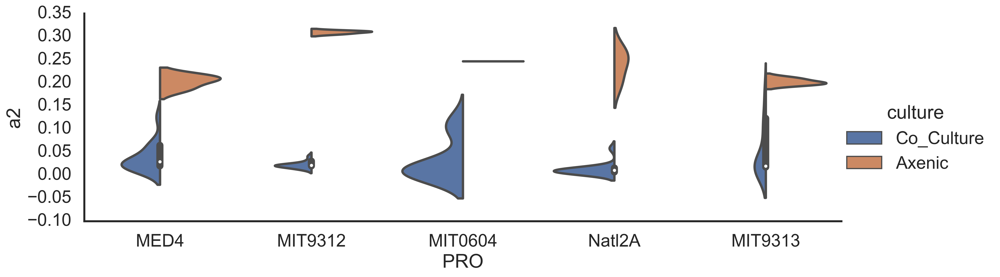

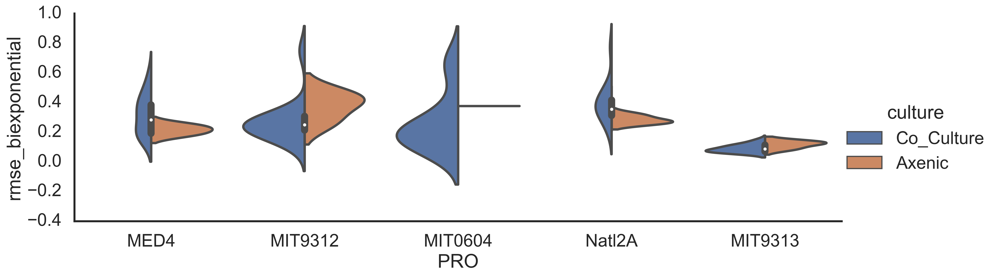

In [72]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['f', 'a1', 'a2', 'rmse_biexponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                                 dfscore.experiment.isin(['e1'])], 
                x='PRO', 
                y=i, kind='violin',
                hue='culture',
                split=True,
           order=porder, #palette=ppallete,
           aspect=3
               )
    #plt.yscale('log')
    #plt.xticks(rotation=30)
    #plt.title(i)
    #plt.title('Exponential decline rate (e1)')


(0.0, 1.4)

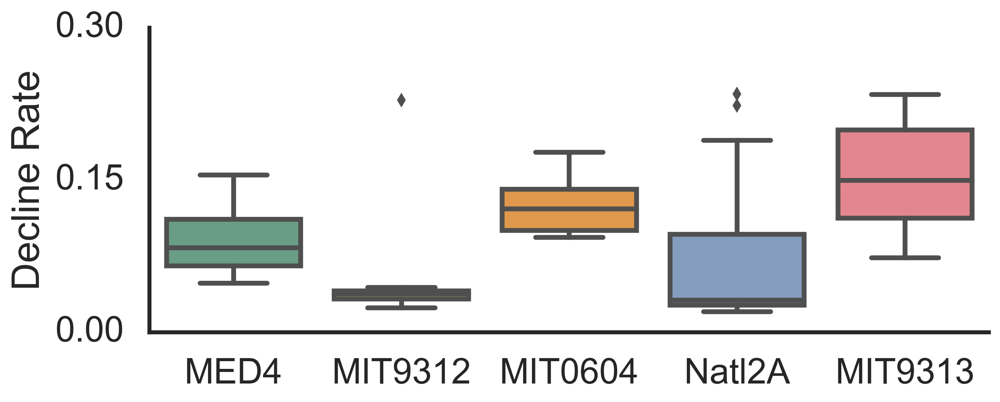

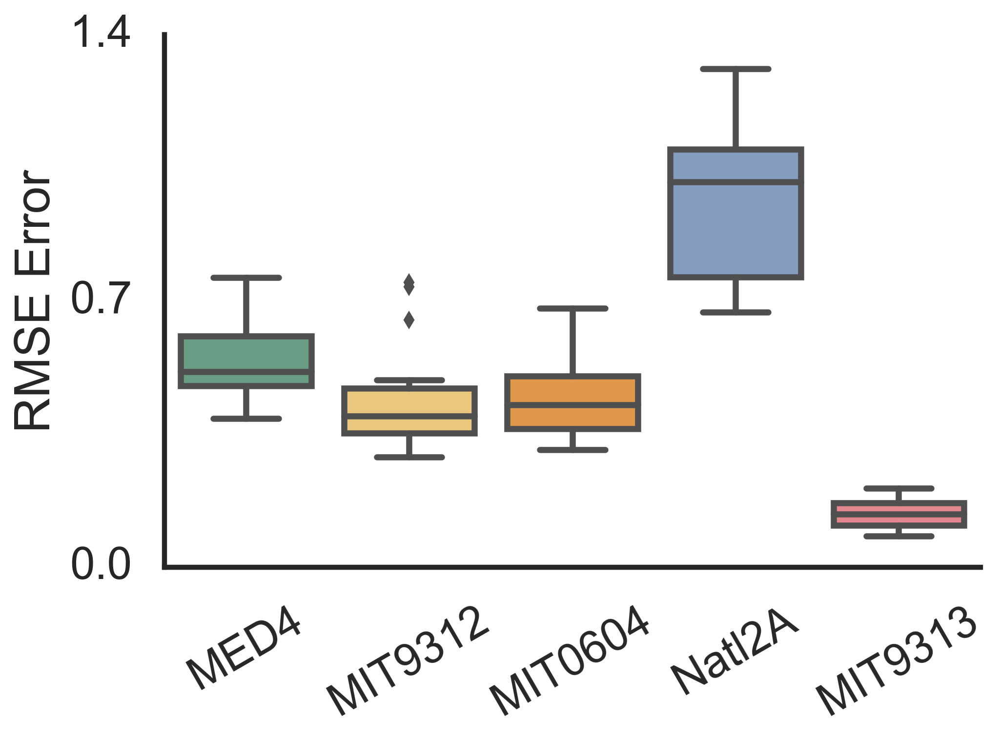

In [73]:
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=1.4, height=5
           ).set(yticks=[0,0.7,1.4]).set_axis_labels('','RMSE Error')
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


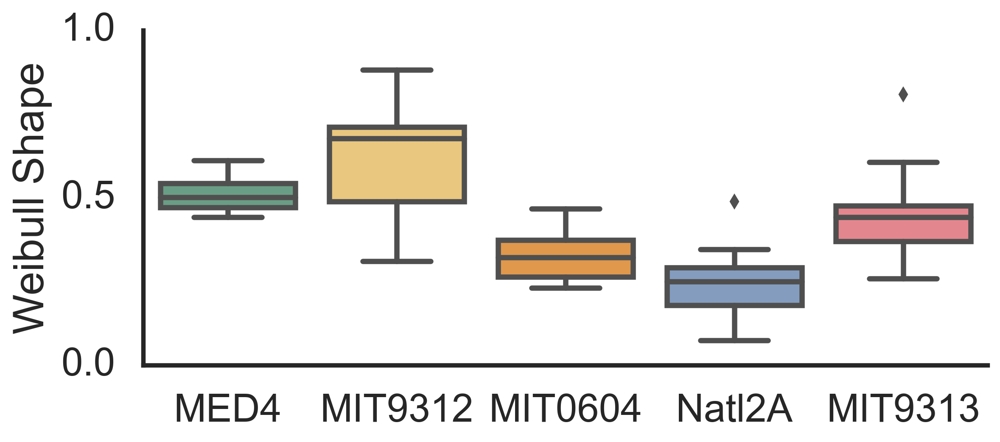

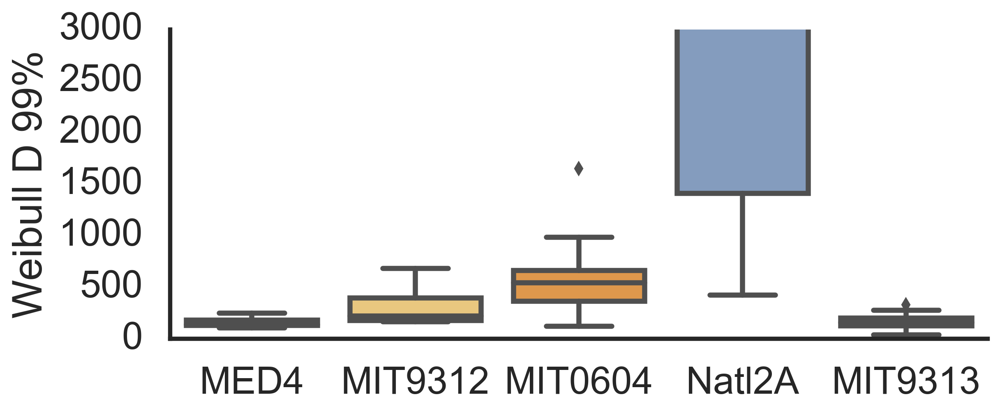

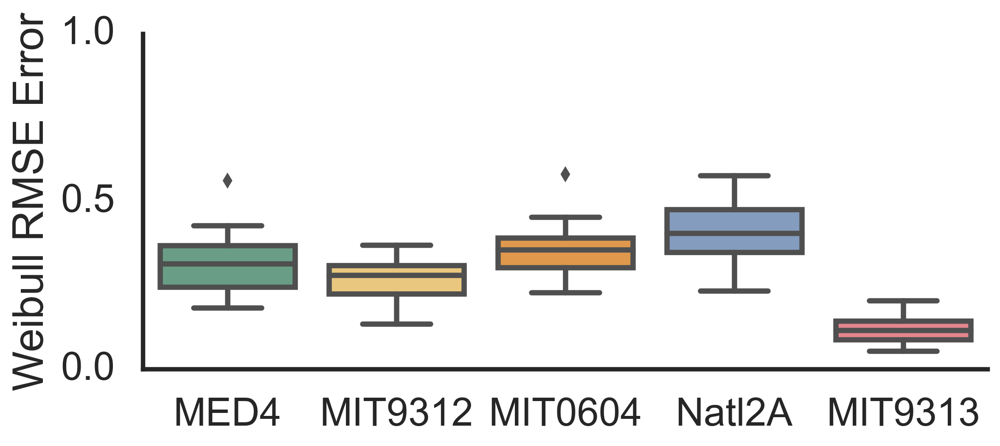

In [74]:
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='weibull_n', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2, height=4,
           ).set(yticks=[0,0.5,1]).set_axis_labels('','Weibull Shape')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='weibull_td2', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2, height=4,
           ).set(ylim=(0,3000)#yticks=[0,0.15,0.3]
                ).set_axis_labels('','Weibull D 99%')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='PRO', 
            y='rmse_weibull', kind='box',
            #col='culture',
       order=porder, palette=ppallete,
       aspect=2, height=4,
           ).set(yticks=[0,0.5,1]).set_axis_labels('','Weibull RMSE Error')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,1.4)


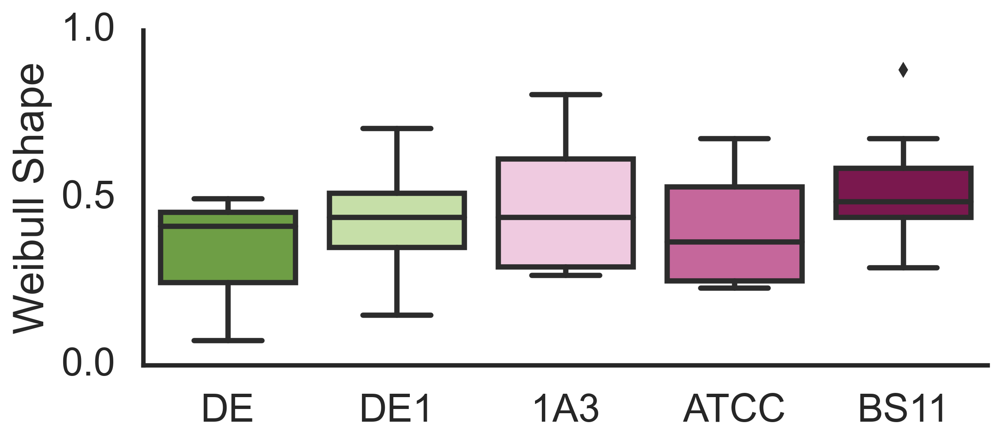

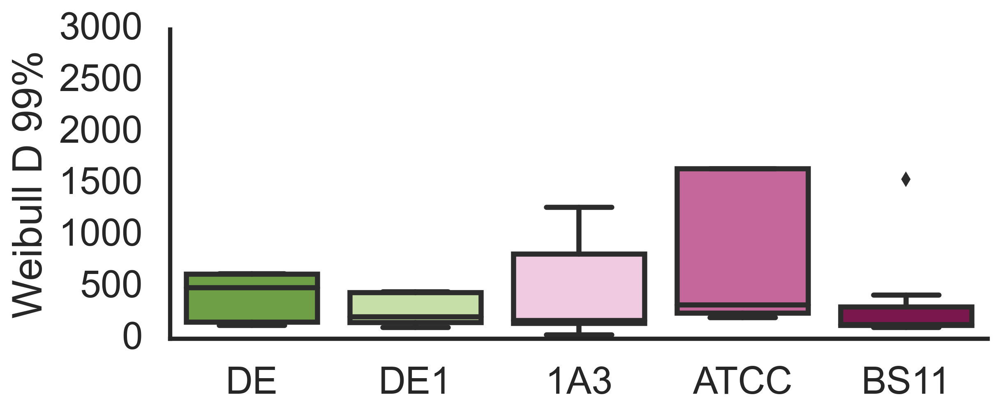

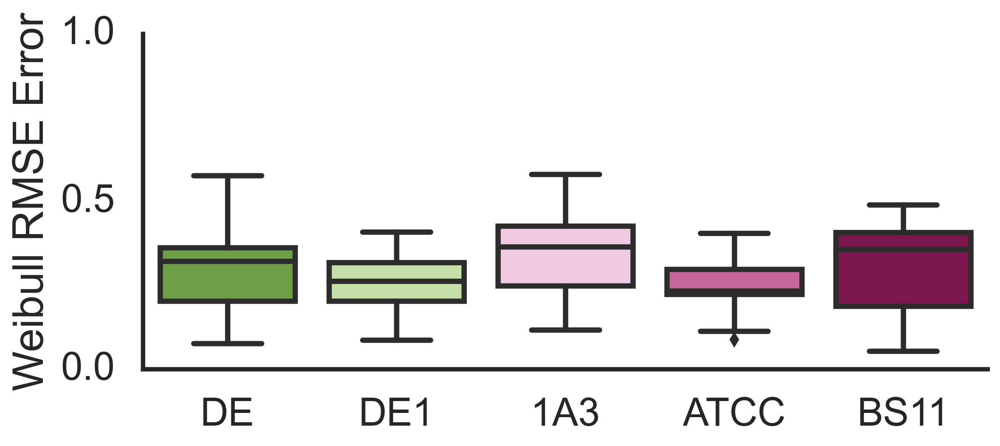

In [75]:
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='weibull_n', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2, height=4,
           ).set(yticks=[0,0.5,1]).set_axis_labels('','Weibull Shape')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='weibull_td2', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2, height=4,
           ).set(ylim=(0,3000)#yticks=[0,0.15,0.3]
                ).set_axis_labels('','Weibull D 99%')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='rmse_weibull', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2, height=4,
           ).set(yticks=[0,0.5,1]).set_axis_labels('','Weibull RMSE Error')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,1.4)


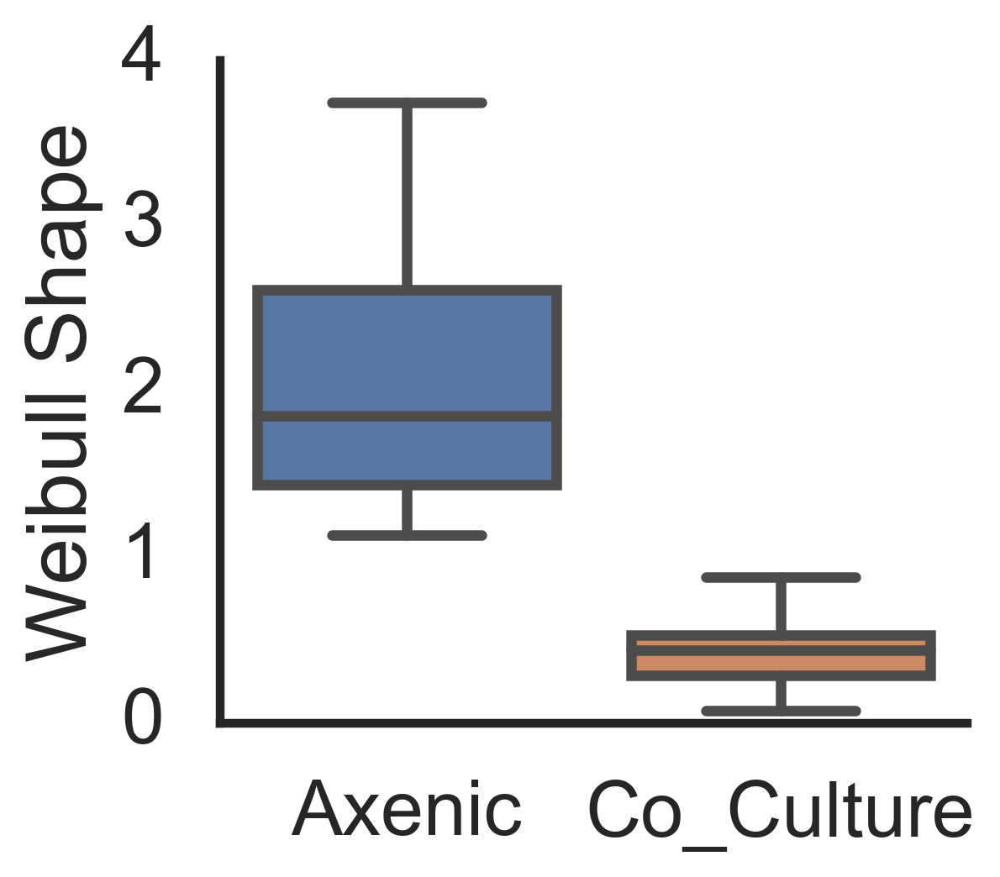

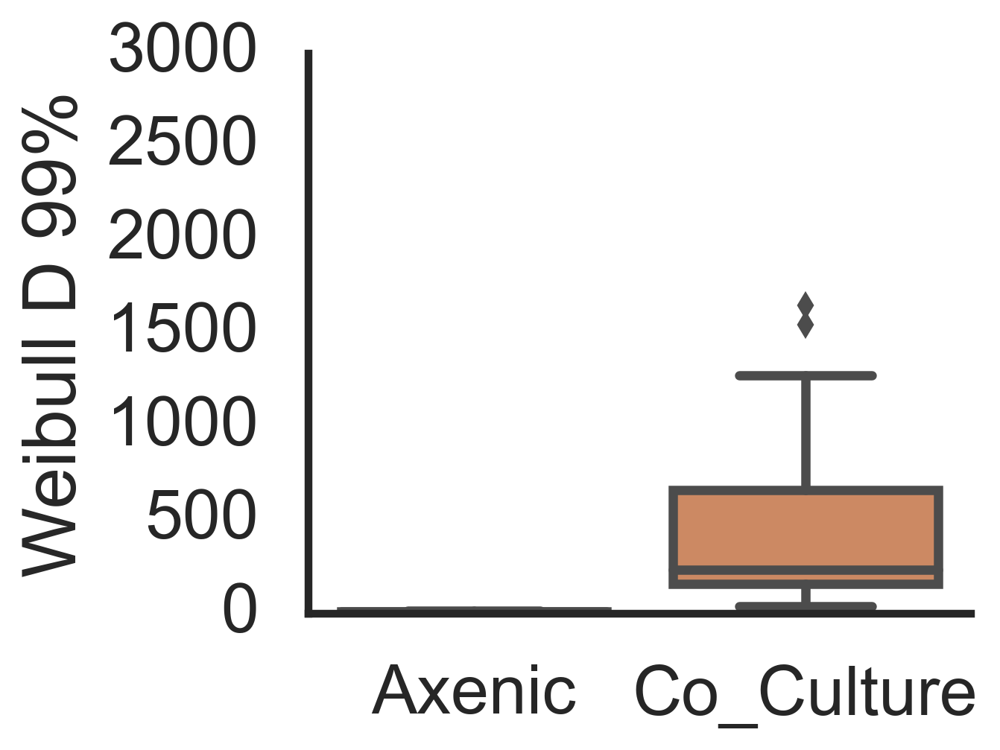

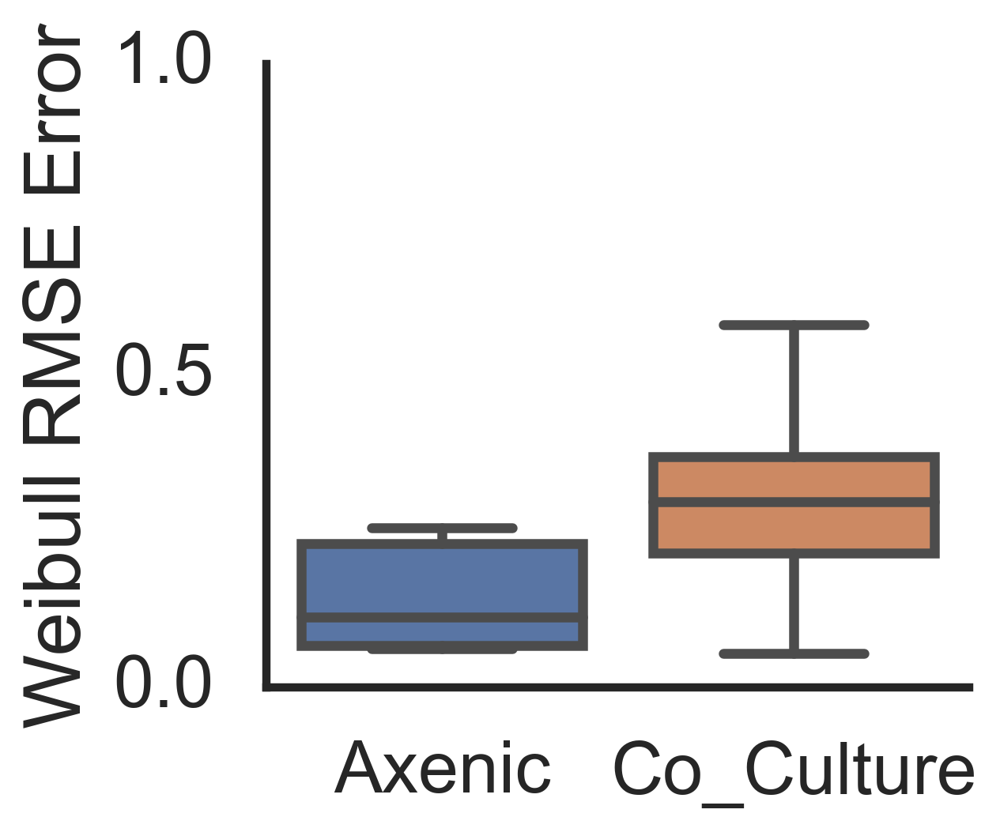

In [76]:
corder = ['Axenic','Co_Culture', ]
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(corder) & 
                             dfscore.experiment.isin(['e1'])], 
            x='culture', 
            y='weibull_n', kind='box',
            #col='culture',
       order=corder, #palette=apallete,
       aspect=1.1, height=4,
           ).set(yticks=[0,1,2,3,4]).set_axis_labels('','Weibull Shape')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.set(context='poster', style='white', font_scale=1)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(corder) & 
                             dfscore.experiment.isin(['e1'])], 
            x='culture', 
            y='weibull_td2', kind='box',
            #col='culture',
       order=corder, #palette=apallete,
       aspect=1.1, height=4,
           ).set(ylim=(0,3000)#yticks=[0,0.15,0.3]
                ).set_axis_labels('','Weibull D 99%')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(corder) & 
                             dfscore.experiment.isin(['e1'])], 
            x='culture', 
            y='rmse_weibull', kind='box',
            #col='culture',
       order=corder,# palette=apallete,
       aspect=1.1, height=4,
           ).set(yticks=[0,0.5,1]).set_axis_labels('','Weibull RMSE Error')
#plt.yscale('log')
#plt.xticks(rotation=30)
#plt.ylim(0,1.4)


(0.0, 1.4)

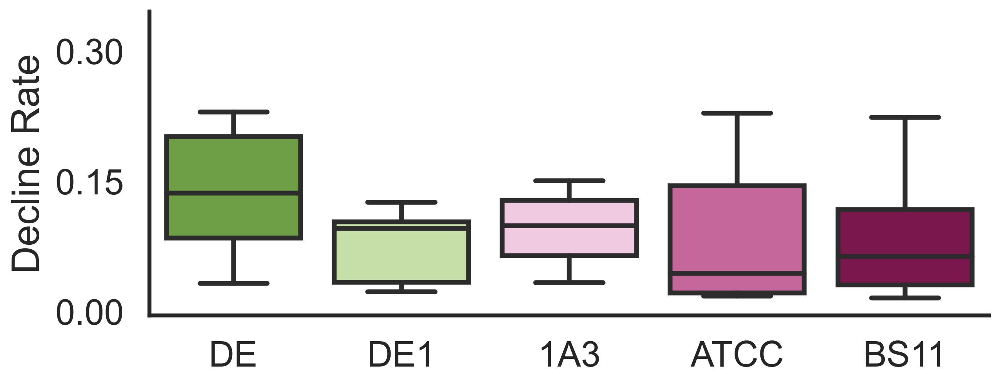

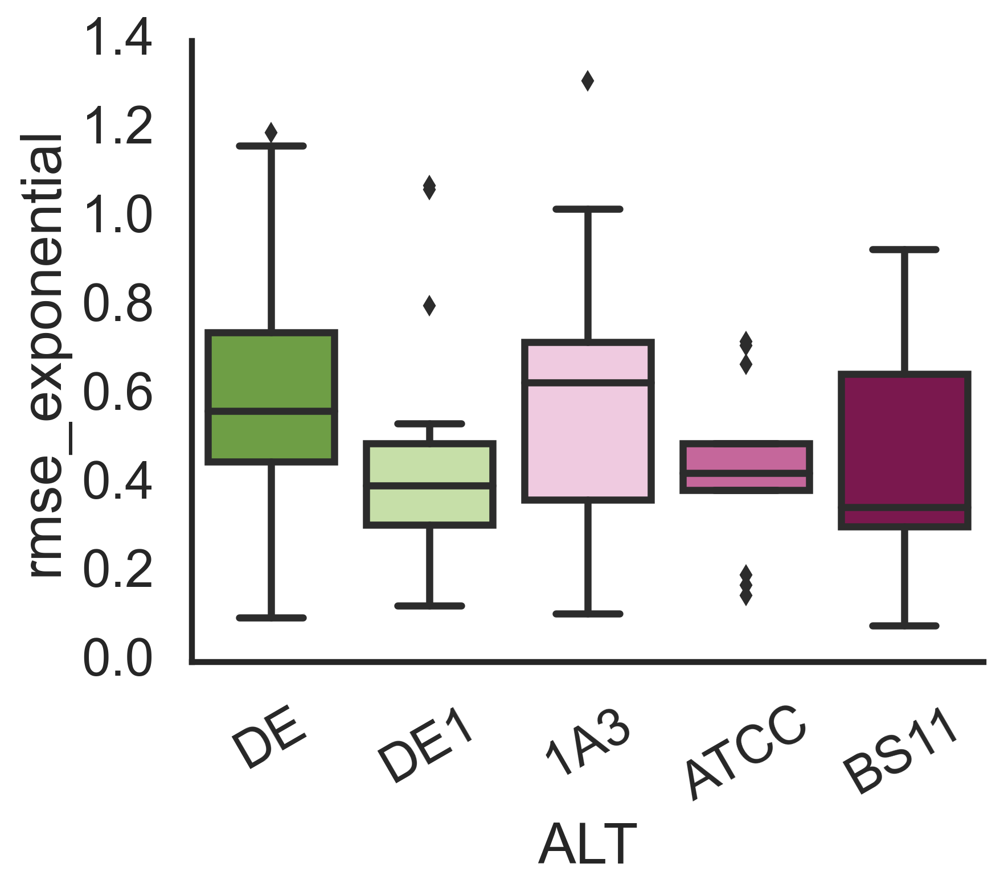

In [77]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='exponential_popt_0', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=2.2, height=4,
           ).set(yticks=[0,0.15,0.3]).set_axis_labels('','Decline Rate')
#plt.yscale('log')
#plt.xticks(rotation=30)
plt.ylim(0,0.35)
#plt.title(i)
sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                             dfscore.experiment.isin(['e1'])], 
            x='ALT', 
            y='rmse_exponential', kind='box',
            #col='culture',
       order=aorder, palette=apallete,
       aspect=1.2
           )
#plt.yscale('log')
plt.xticks(rotation=30)
plt.ylim(0,1.4)


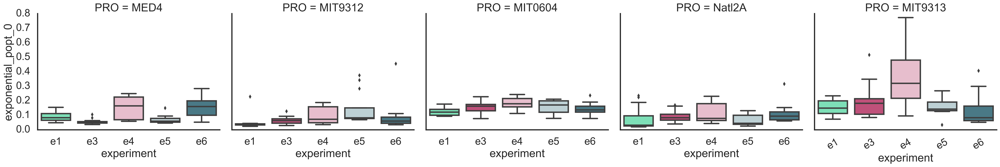

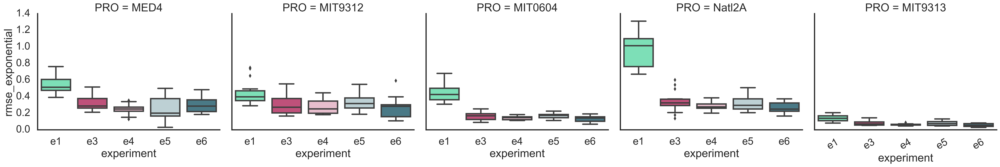

In [78]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='PRO', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=porder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


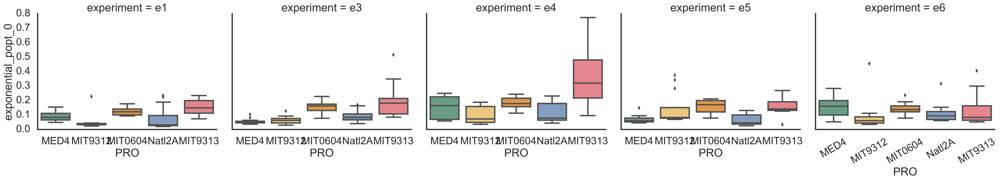

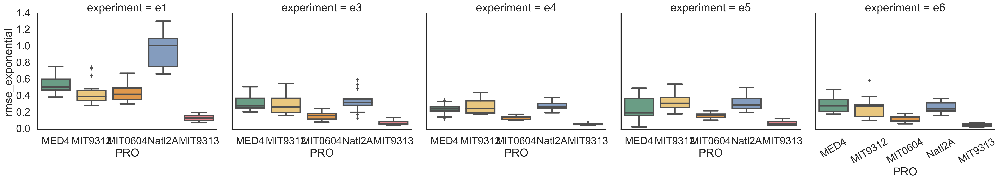

In [79]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='experiment', 
                x='PRO',
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
                col_order=eorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


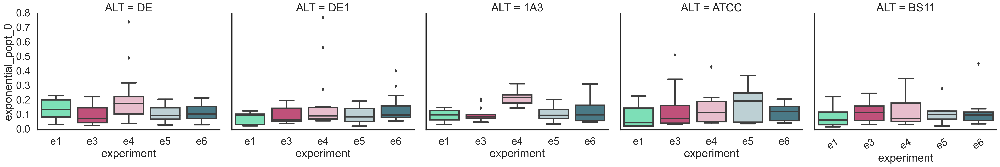

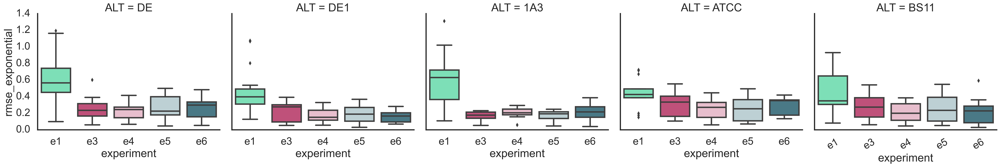

In [80]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                col='ALT', 
                x='experiment',
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
                col_order=aorder,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


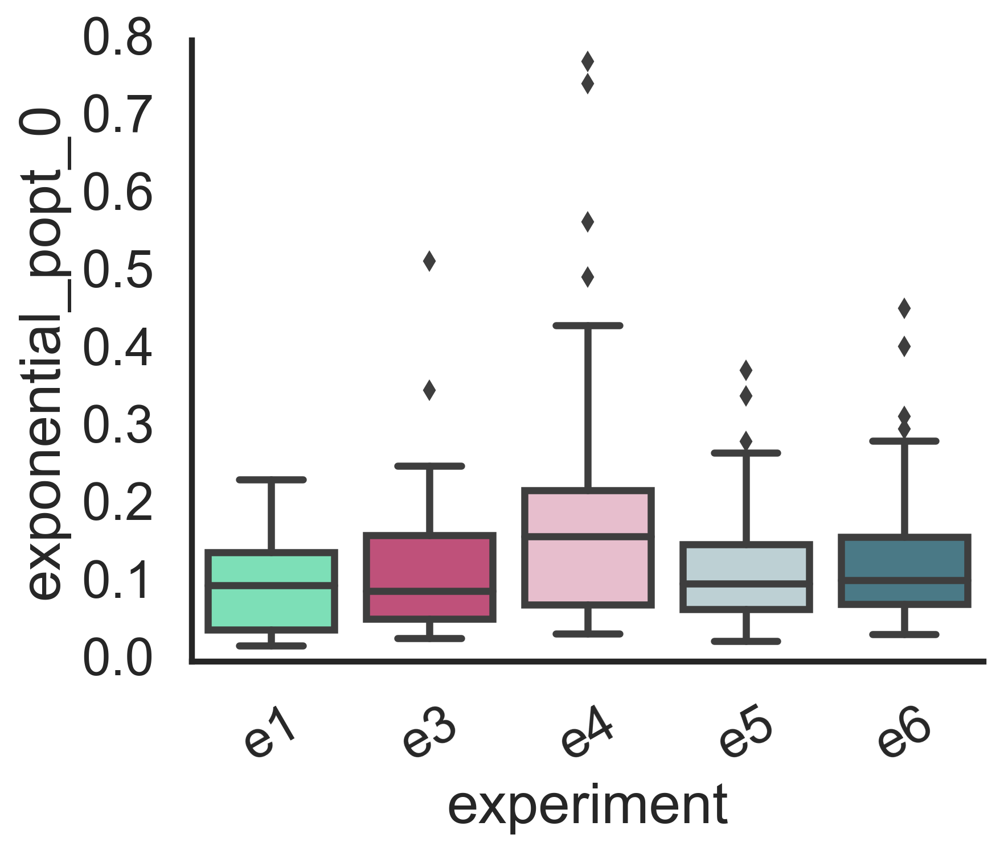

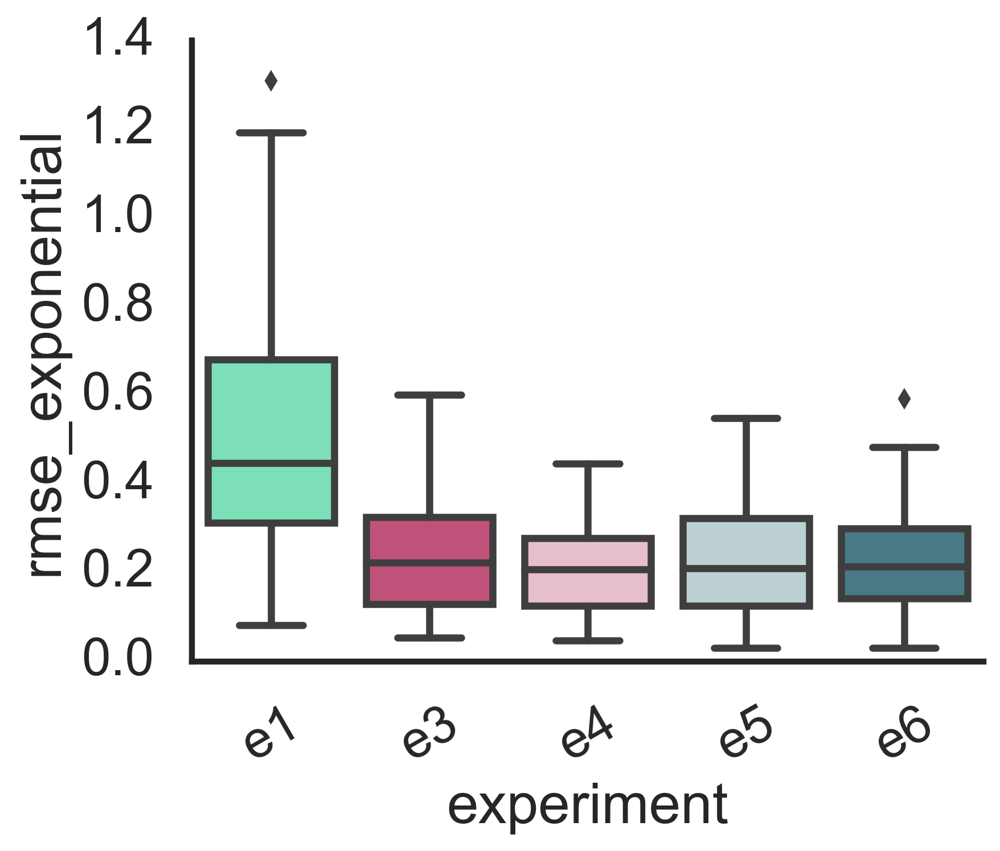

In [81]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='experiment', 
                y=i, kind='box',
                #col='culture',
           order=eorder, palette=epallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)


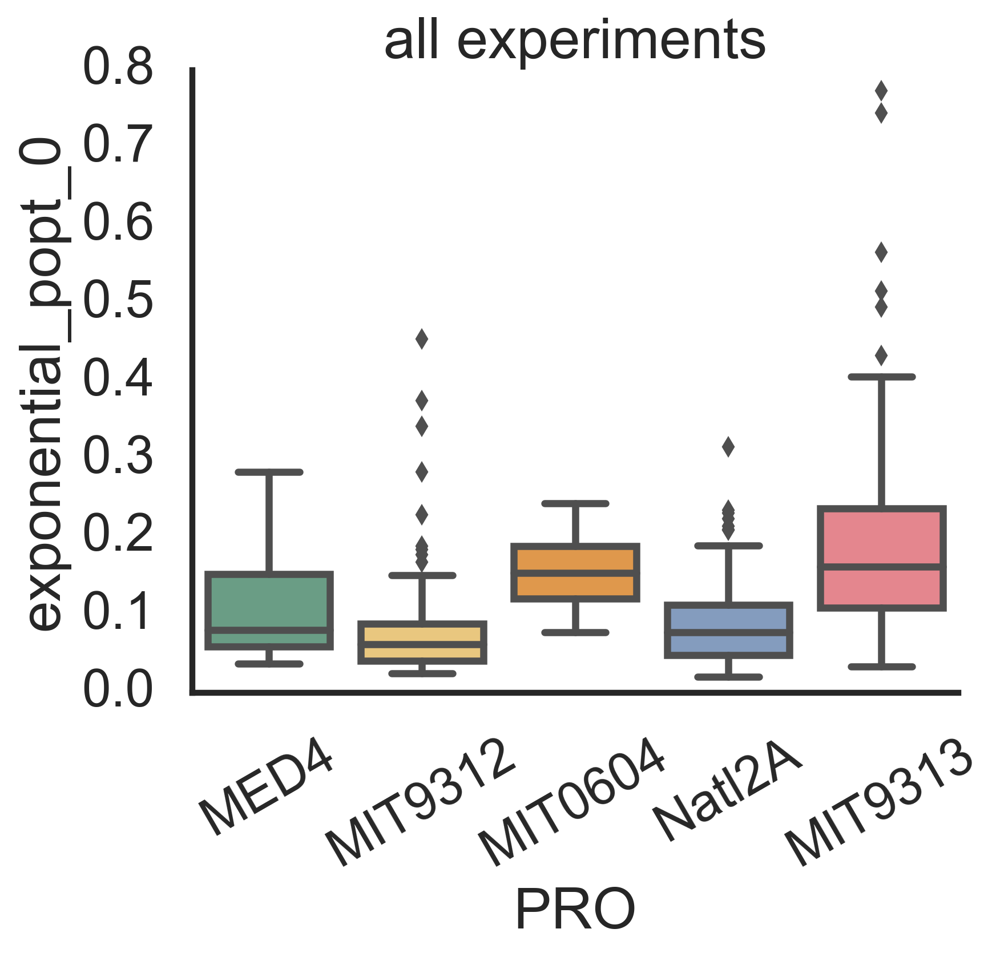

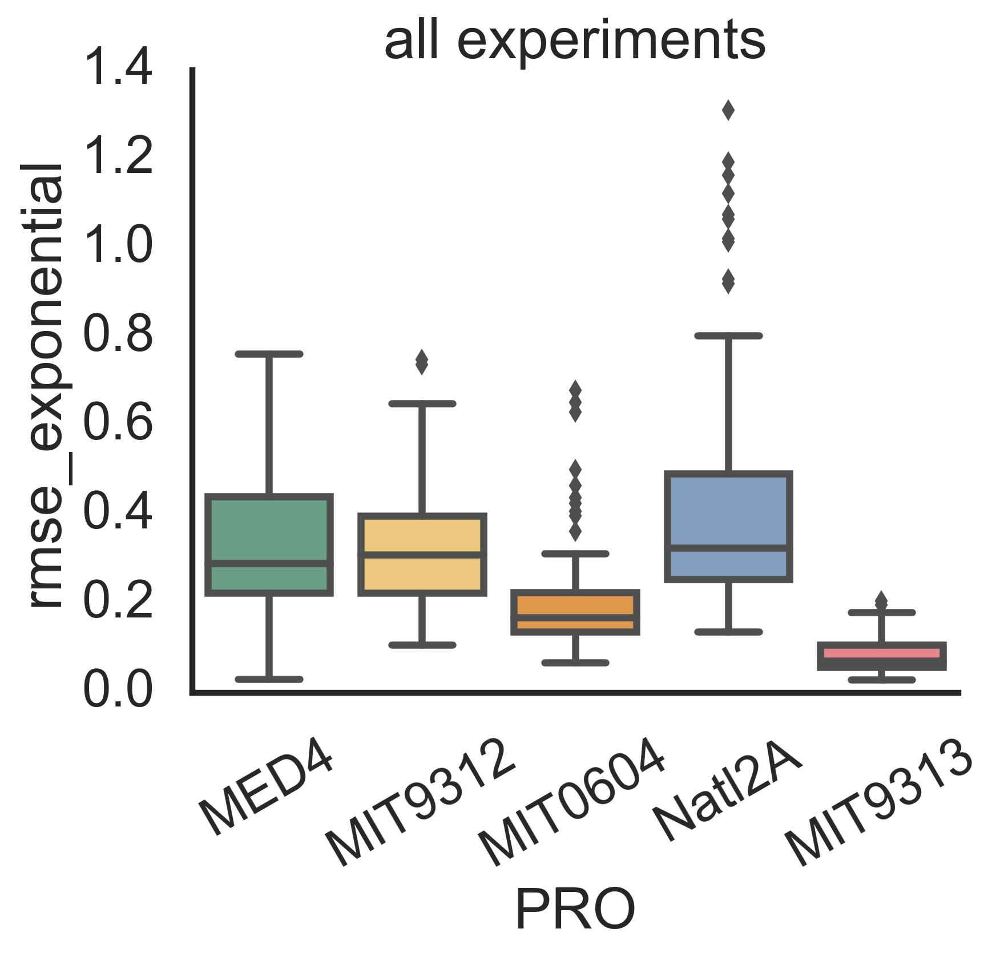

In [82]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('all experiments')


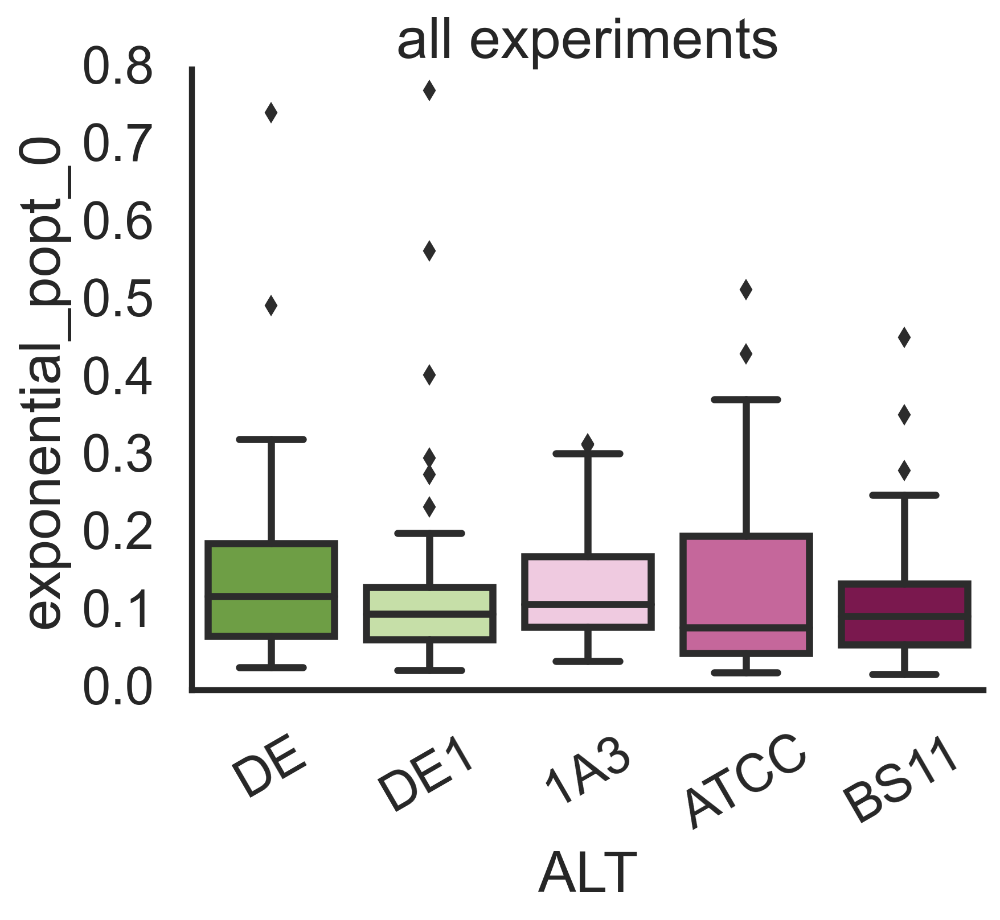

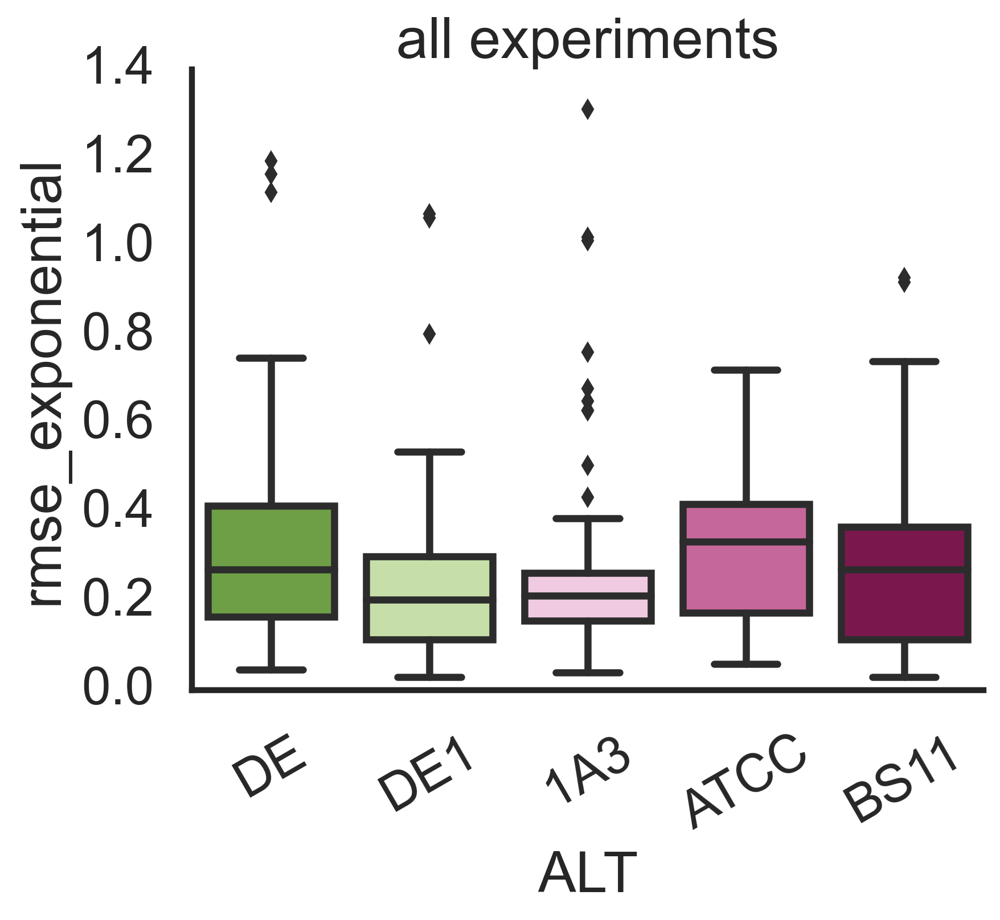

In [83]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('all experiments')


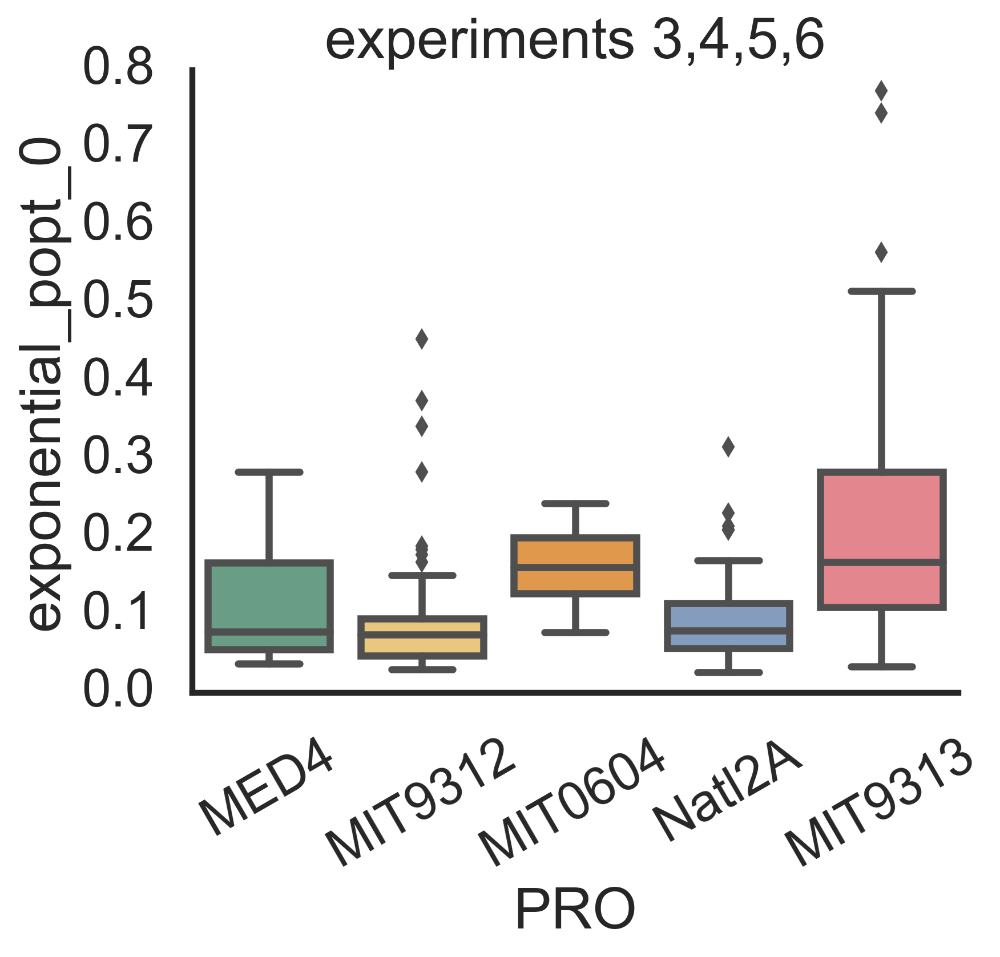

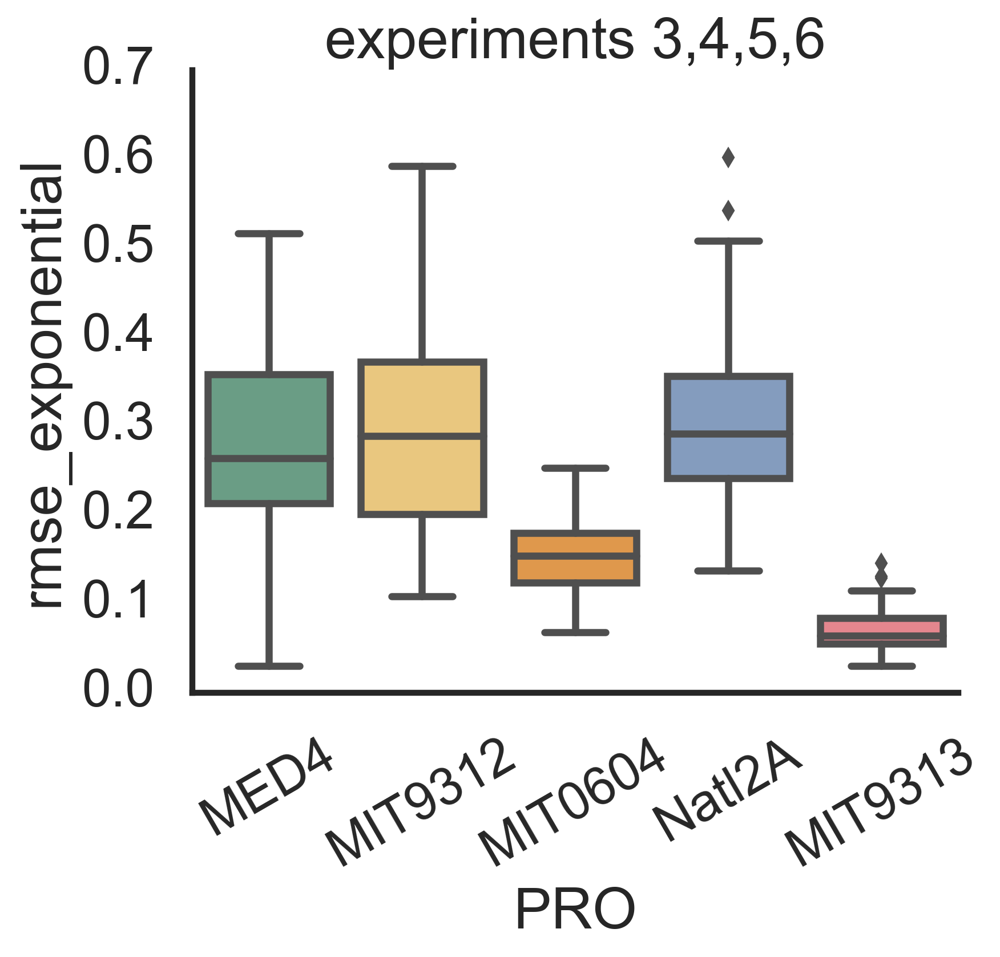

In [84]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='PRO', 
                y=i, kind='box',
                #col='culture',
           order=porder, palette=ppallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    plt.title('experiments 3,4,5,6')


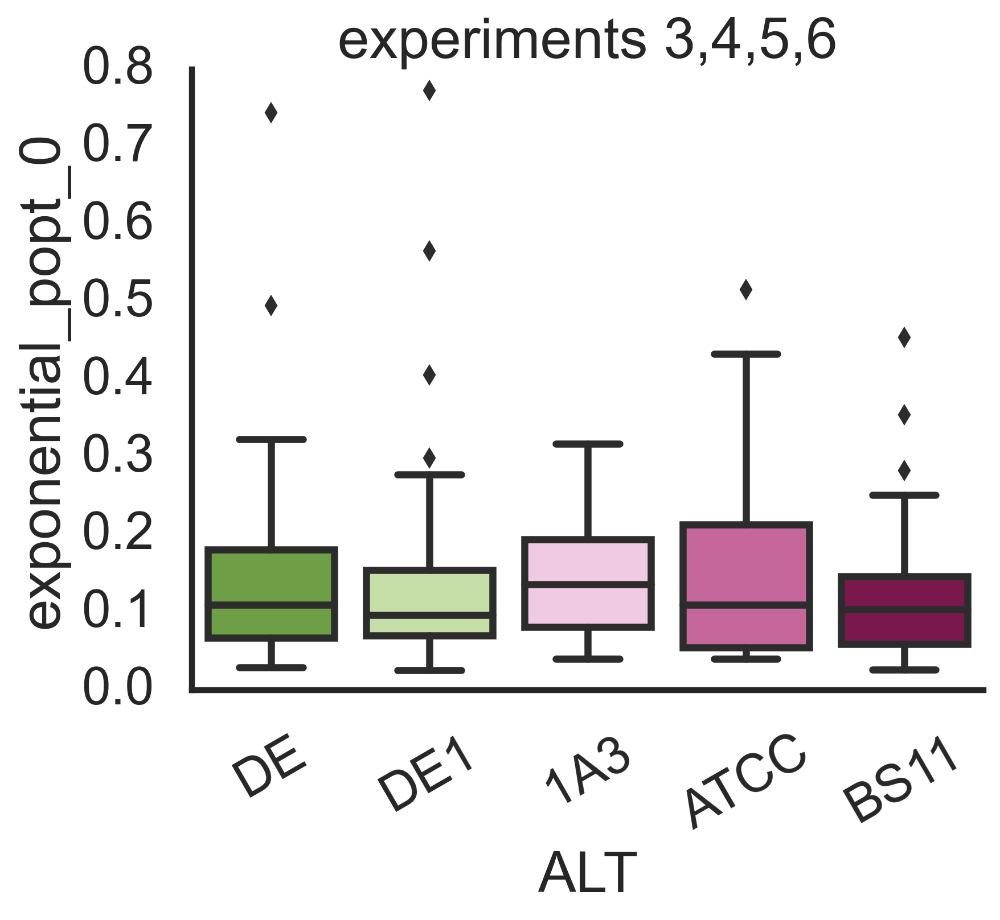

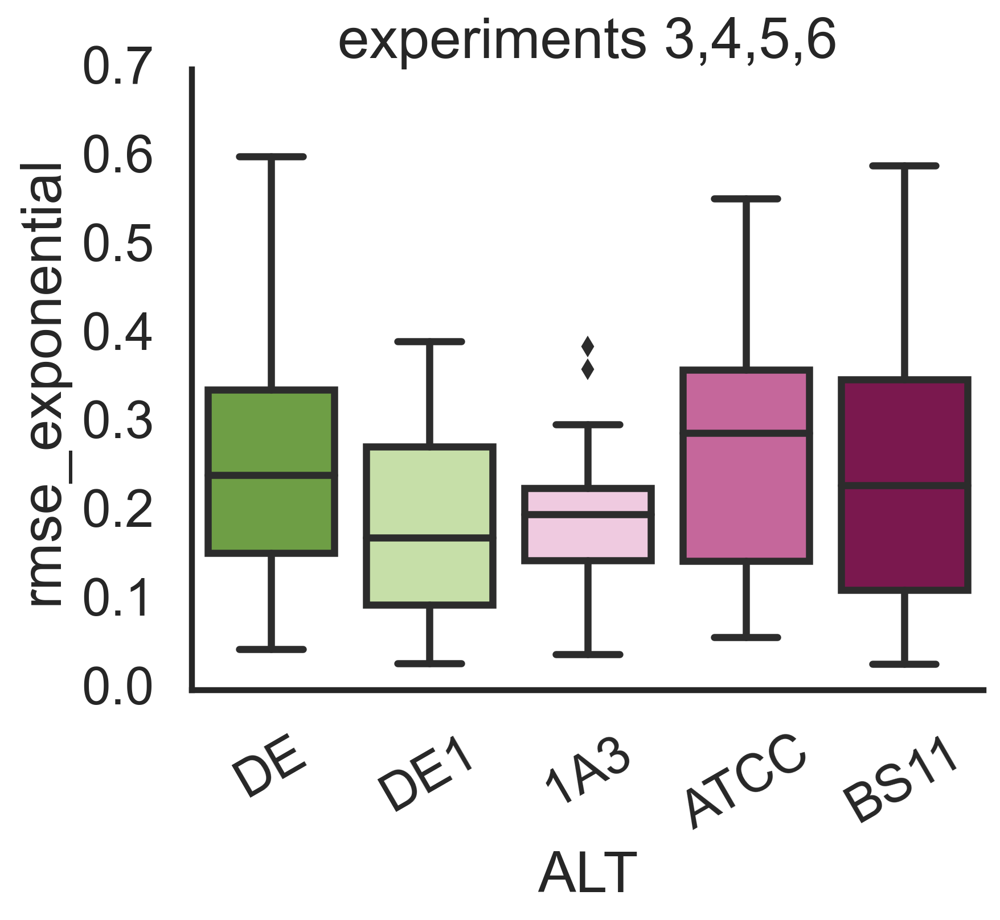

In [85]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0', 'rmse_exponential', #'harmonic_popt_0'
         ]:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & (~dfscore.experiment.isin(['e1'])) ], 
                x='ALT', 
                y=i, kind='box',
                #col='culture',
           order=aorder, palette=apallete,
           aspect=1.2
               )
    #plt.yscale('log')
    plt.xticks(rotation=30)
    #plt.title(i)
    plt.title('experiments 3,4,5,6')


In [86]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.358
Model:                            OLS   Adj. R-squared:                  0.321
Method:                 Least Squares   F-statistic:                     9.492
Date:                Wed, 17 Mar 2021   Prob (F-statistic):           3.71e-06
Time:                        22:24:37   Log-Likelihood:                 115.65
No. Observations:                  73   AIC:                            -221.3
Df Residuals:                      68   BIC:                            -209.8
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.0920      0.01

In [87]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('exponential_popt_0 ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:     exponential_popt_0   R-squared:                       0.125
Model:                            OLS   Adj. R-squared:                  0.074
Method:                 Least Squares   F-statistic:                     2.431
Date:                Wed, 17 Mar 2021   Prob (F-statistic):             0.0558
Time:                        22:24:37   Log-Likelihood:                 104.33
No. Observations:                  73   AIC:                            -198.7
Df Residuals:                      68   BIC:                            -187.2
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.0998      0.016      6.

In [88]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.806
Model:                            OLS   Adj. R-squared:                  0.795
Method:                 Least Squares   F-statistic:                     70.70
Date:                Wed, 17 Mar 2021   Prob (F-statistic):           1.69e-23
Time:                        22:24:37   Log-Likelihood:                 44.745
No. Observations:                  73   AIC:                            -79.49
Df Residuals:                      68   BIC:                            -68.04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept             0.5465      0.03

In [89]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])]

mod = ols('rmse_exponential ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'exponential_popt_0 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'exponential_popt_0 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:       rmse_exponential   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     1.096
Date:                Wed, 17 Mar 2021   Prob (F-statistic):              0.366
Time:                        22:24:37   Log-Likelihood:                -12.859
No. Observations:                  73   AIC:                             35.72
Df Residuals:                      68   BIC:                             47.17
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.5887      0.077      7.

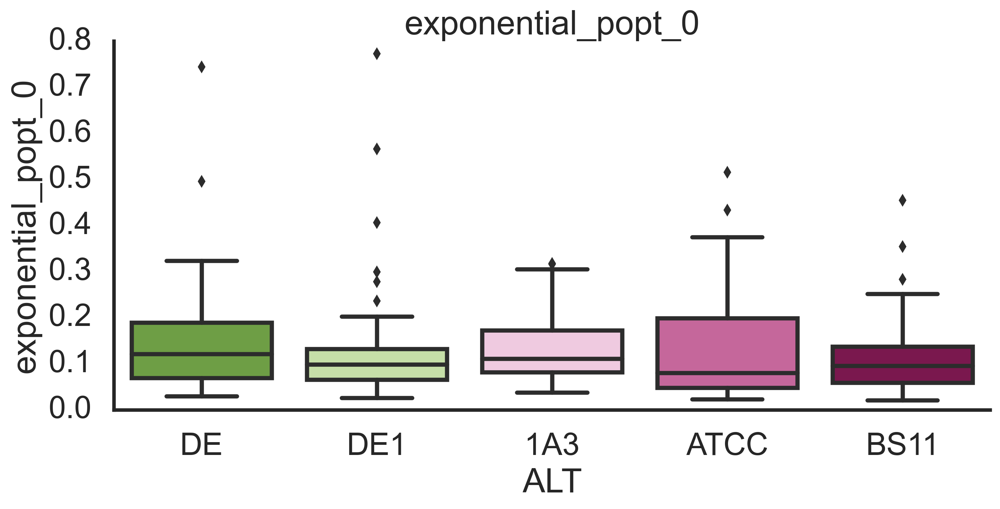

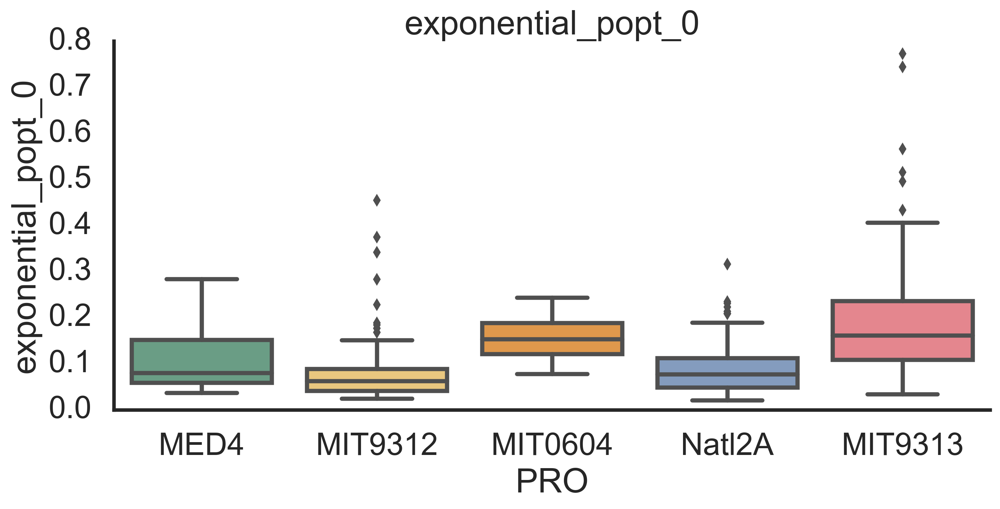

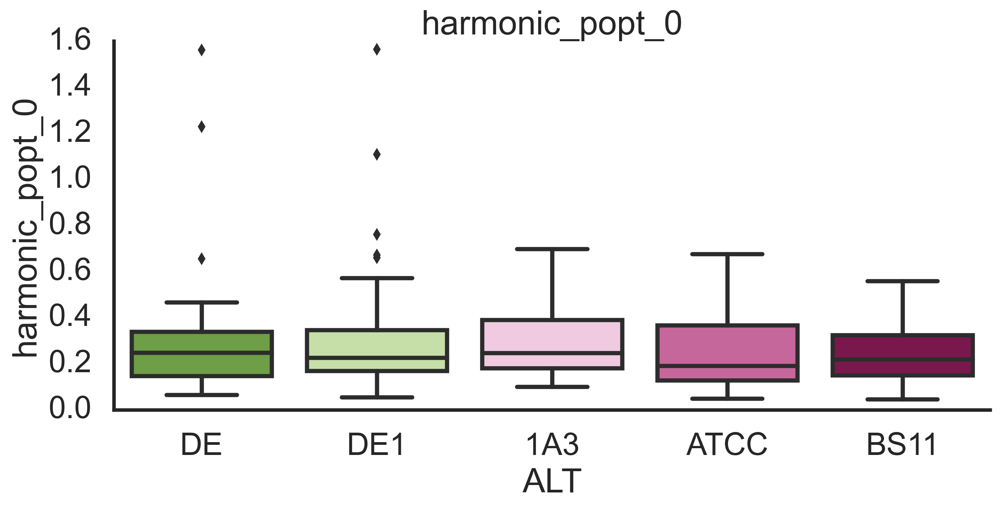

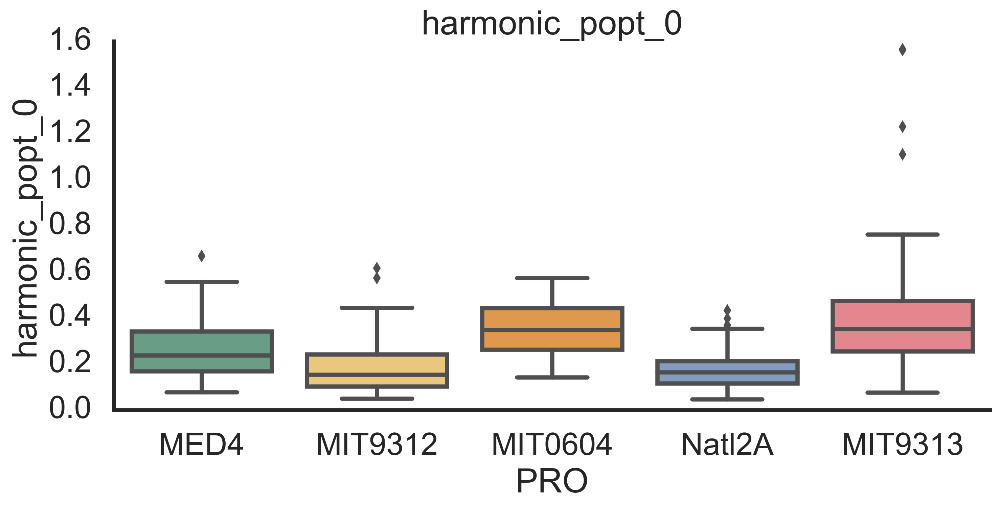

In [90]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0',  'harmonic_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='ALT', y=i, kind='box',
                #hue='culture',
           order=aorder, palette=apallete,
                aspect=2,
           )
    plt.title(i)

    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box',
                #hue='culture',
           order=porder, palette=ppallete,
                aspect=2,
           )
    plt.title(i)
    

(0.0, 0.6)

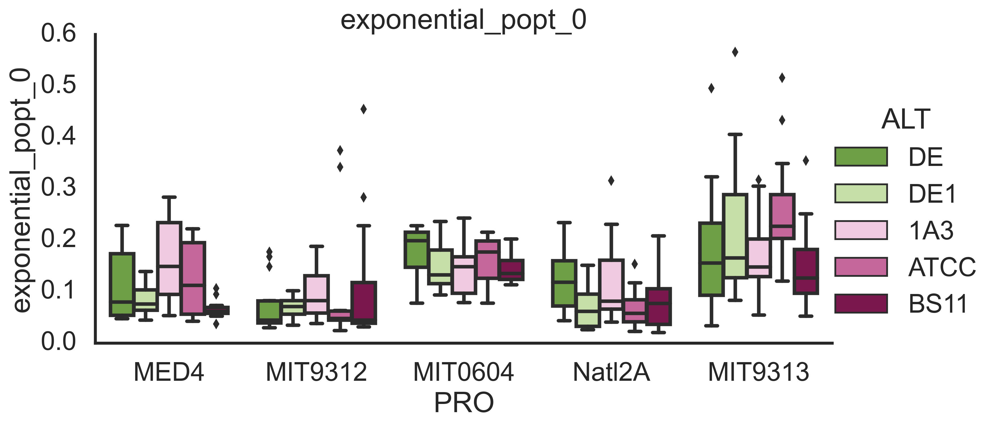

In [91]:
dfscore['p'] = dfscore.PRO
dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] = dfscore.loc[dfscore.culture.isin(['Axenic']),'p'] + '_Axenic'

for i in ['exponential_popt_0']:
    sns.catplot(data=dfscore.loc[dfscore.culture.isin(['Co_Culture'])], 
                x='PRO', y=i, kind='box', hue='ALT',
                #hue='culture',
           hue_order=aorder, palette=apallete,
                order=porder,
                aspect=2,
           )
    plt.title(i)
plt.ylim(0,0.6)

In [92]:
best_model_df.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'model', 'RMSE', 's', 'e', 'p'],
      dtype='object')

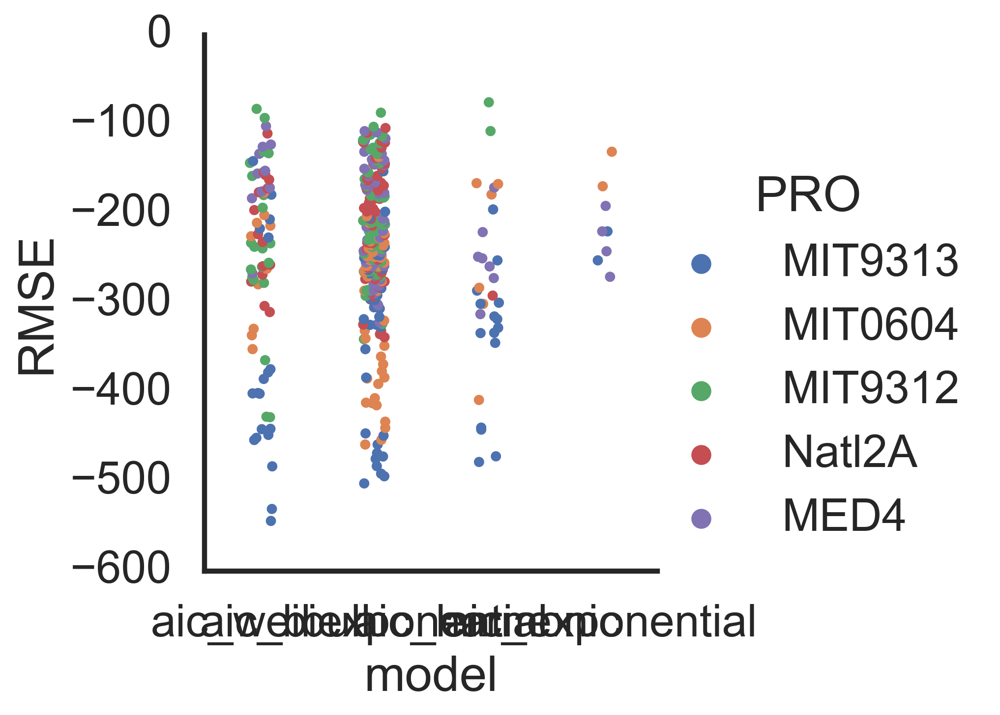

In [93]:
sns.catplot(data=best_model_df, x='model', y='RMSE', hue='PRO')

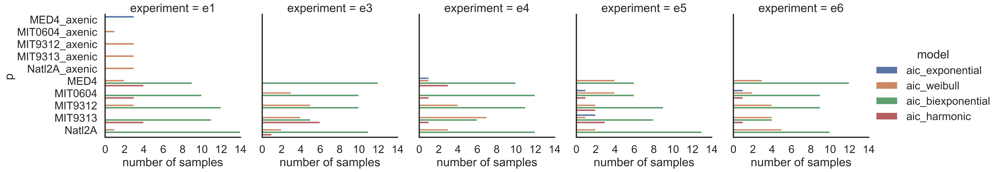

In [94]:
df_best_count = best_model_df.groupby(['culture','p', 'experiment',  'model'])['sample'].count().reset_index()
#df_best_count.model =df_best_count.model.map({'bic_exponential': 'exponential', 'bic_harmonic': 'harmonic'})
df_best_count.rename(columns={'sample': 'number of samples'}, inplace=True)

sns.catplot(data=df_best_count,y='p', hue='model', x='number of samples', #row='culture',
            col='experiment', kind='bar')

In [95]:
dfdecline.head()

,experiment_sample,day,FL,experiment,sample,PRO,ALT,culture,exponential,exponential_popt_0,...,biexponential_popt_1,biexponential_popt_2,harmonic,harmonic_popt_0,harmonic_popt_1,harmonic_popt_2,weibull,weibull_popt_0,weibull_popt_1,weibull_popt_2
0,"e1, 10A",0.000000,5.621,e1,10A,MIT0604,DE,Co_Culture,5.621000,0.141021,...,0.008879,0.863408,5.621000,0.296513,0.5,0.5,5.621000,0.896868,0.259722,0.5
1,"e1, 10A",0.893056,4.045,e1,10A,MIT0604,DE,Co_Culture,4.955857,0.141021,...,0.008879,0.863408,4.444171,0.296513,0.5,0.5,2.352798,0.896868,0.259722,0.5
2,"e1, 10A",1.991667,2.749,e1,10A,MIT0604,DE,Co_Culture,4.244581,0.141021,...,0.008879,0.863408,3.533985,0.296513,0.5,0.5,1.923026,0.896868,0.259722,0.5
3,"e1, 10A",4.697222,2.924,e1,10A,MIT0604,DE,Co_Culture,2.898240,0.141021,...,0.008879,0.863408,2.349141,0.296513,0.5,0.5,1.471309,0.896868,0.259722,0.5
4,"e1, 10A",5.700000,2.519,e1,10A,MIT0604,DE,Co_Culture,2.516052,0.141021,...,0.008879,0.863408,2.089493,0.296513,0.5,0.5,1.373101,0.896868,0.259722,0.5


In [96]:
dfdecline['exponential_error'] = dfdecline['FL'] - dfdecline['exponential']
dfdecline['harmonic_error'] = dfdecline['FL'] - dfdecline['harmonic']
dfdecline['biexponential_error'] = dfdecline['FL'] - dfdecline['harmonic']
dfdecline['weibull_error'] = dfdecline['FL'] - dfdecline['weibull']


In [97]:
value_vars = [ 'FL'] + models
# 'exponential_error','biexponential_error','harmonic_error',
id_vars = ['experiment_sample', 'day',  'experiment', 'sample', 'PRO', 'ALT',
       'culture', ]      
dfresm = dfdecline.melt(value_vars=value_vars, id_vars=id_vars )

In [98]:
value_vars = [ f'{m}_error' for m in models]
# 'exponential_error','biexponential_error','harmonic_error',
id_vars = ['experiment_sample', 'day',  'experiment', 'sample', 'PRO', 'ALT',
       'culture', ]      
dferrm = dfdecline.melt(value_vars=value_vars, id_vars=id_vars )

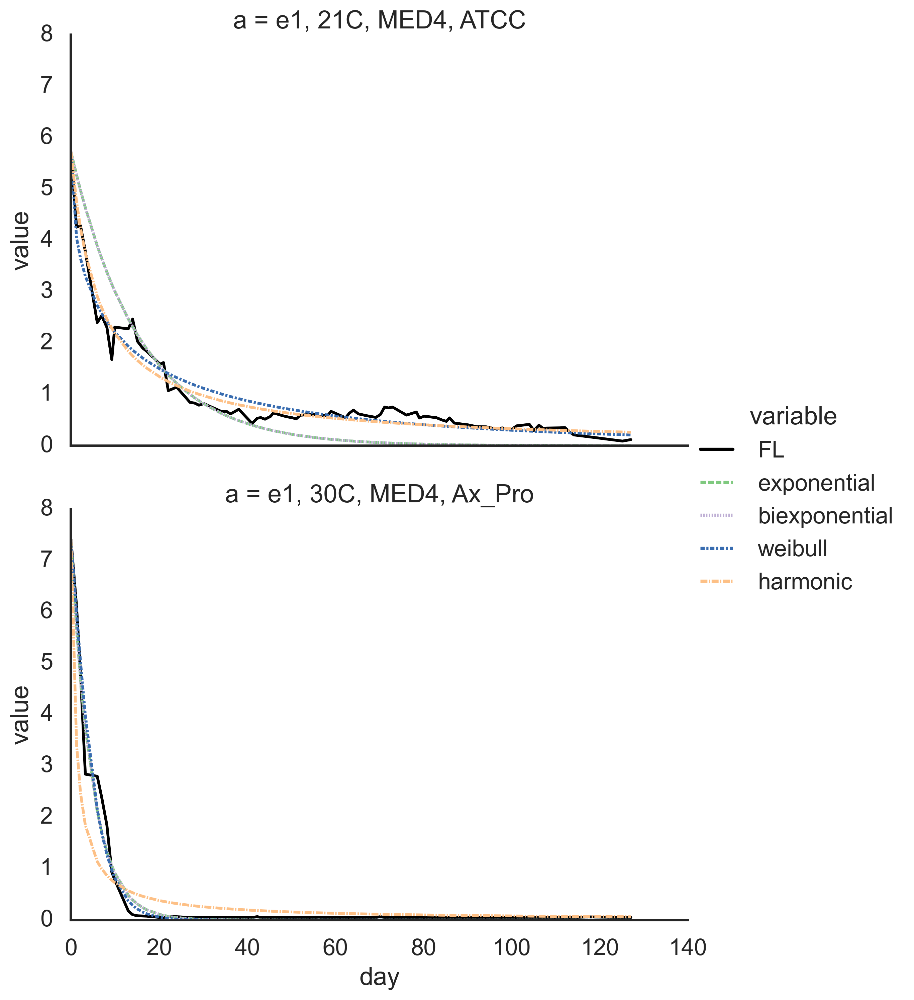

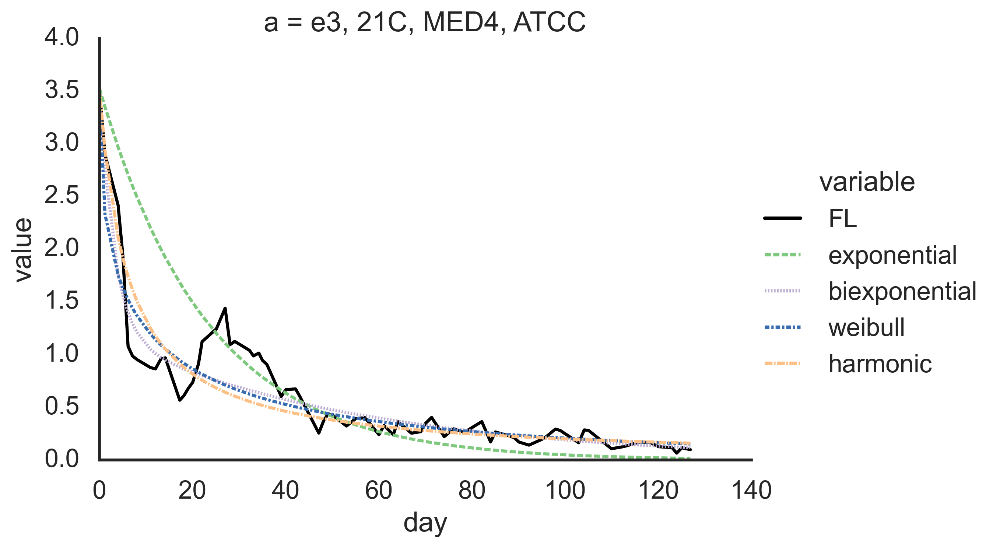

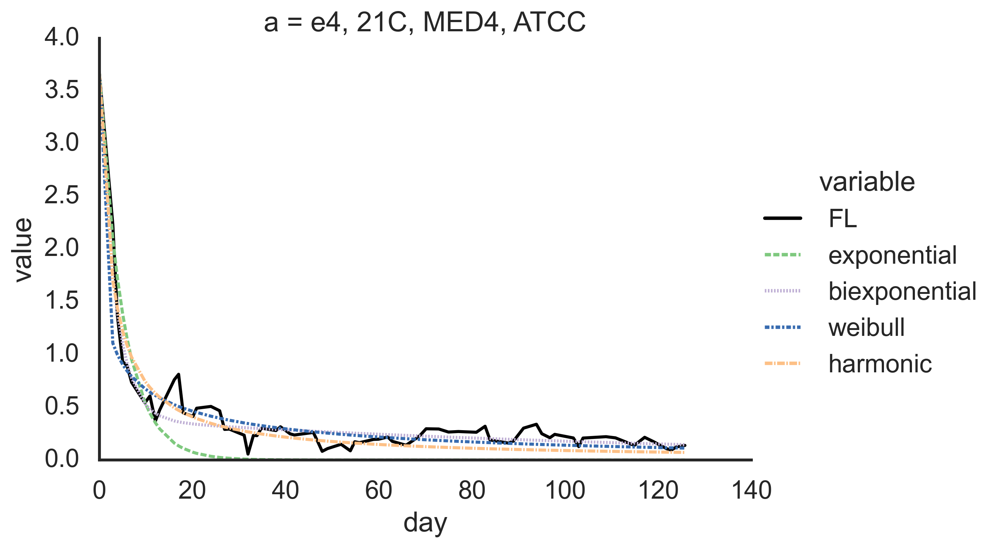

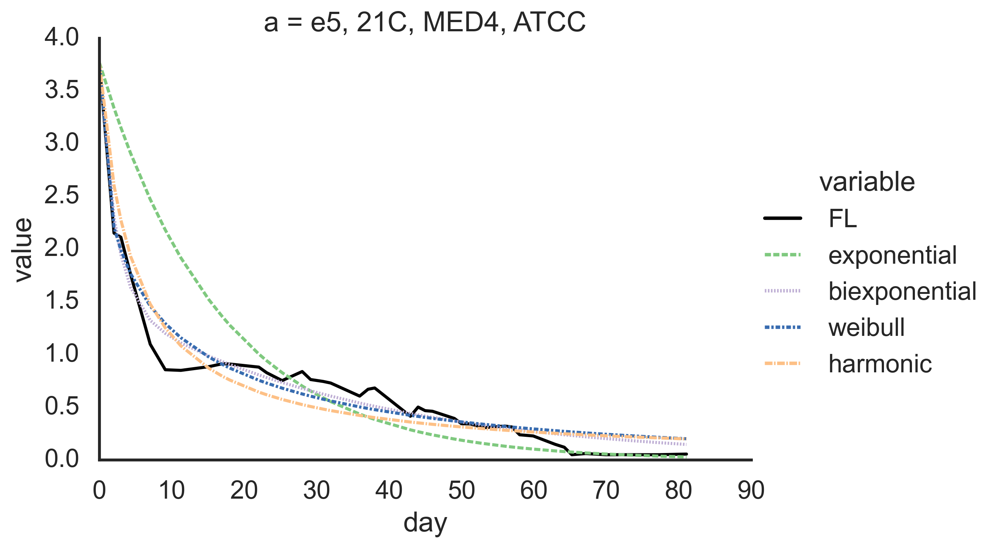

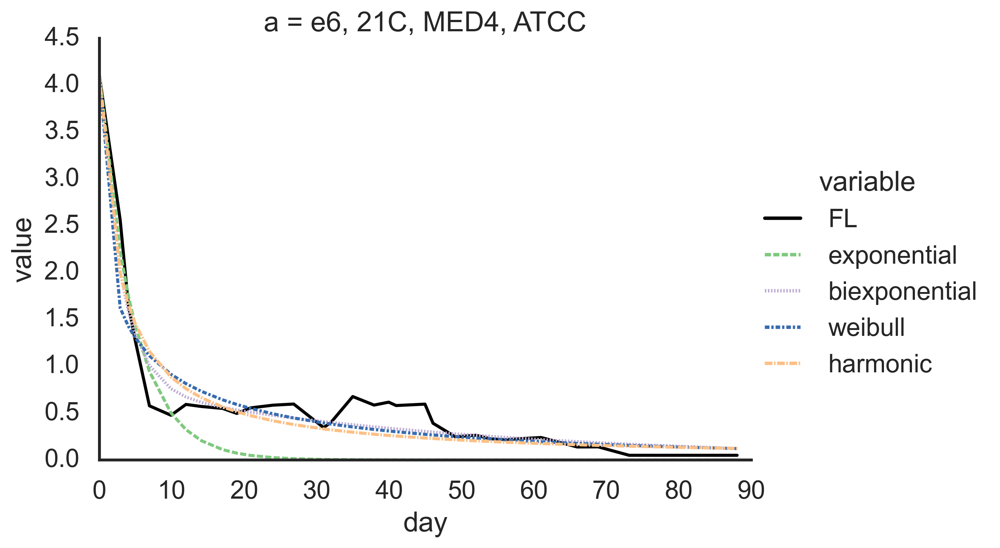

In [99]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for p in ['Natl2A']:
    for e in eorder: #['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & #(dfresm.PRO == p) &
                                   (dfresm['sample'].isin(['21C', '30C']))], 
                x='day',
                y='value',
                hue='variable',
                style='variable',
                    
                row='a',
                #col_wrap=6,
                kind='line',
                    lw=2,
                    aspect=1.4,
                    palette=['black'] + mpalette,
               )
        #plt.suptitle(f'fitting, experiment MED4 - axenic vs coculture', y=1.05)
        plt.show()

In [100]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

for a in ['Ax_Pro']:
    for e in ['e1']:
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.ALT.isin(aorder + ['Ax_Pro'])) &
                                    (dfresm['sample'].str.endswith('C'))
                                   #(dfresm['sample'].isin(['21C', '30C']))
                                   ], 
                x='day',
                y='value',
                hue='variable',
                col='PRO',
                    row='ALT',
                    row_order=aorder+ ['Ax_Pro'],
                    col_order=porder ,
                #col_wrap=5,
                kind='line',
                    aspect=1.4
               )
        plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
        plt.show()

In [101]:
best_model_df.loc[(best_model_df.experiment == 'e1') & (best_model_df.ALT.isin(['1A3'])) &
                            (best_model_df['sample'].str.endswith('B')) ]


,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
1840,"e1, 2B",e1,2B,MIT9313,1A3,Co_Culture,aic_biexponential,-246.264056,"2B, 1A3","e1, Co_Culture",MIT9313
1846,"e1, 3B",e1,3B,MIT9312,1A3,Co_Culture,aic_biexponential,-212.739457,"3B, 1A3","e1, Co_Culture",MIT9312
2564,"e1, 5B",e1,5B,MIT0604,1A3,Co_Culture,aic_harmonic,-178.630733,"5B, 1A3","e1, Co_Culture",MIT0604
1849,"e1, 4B",e1,4B,Natl2A,1A3,Co_Culture,aic_biexponential,-144.148219,"4B, 1A3","e1, Co_Culture",Natl2A
1811,"e1, 1B",e1,1B,MED4,1A3,Co_Culture,aic_biexponential,-138.085748,"1B, 1A3","e1, Co_Culture",MED4


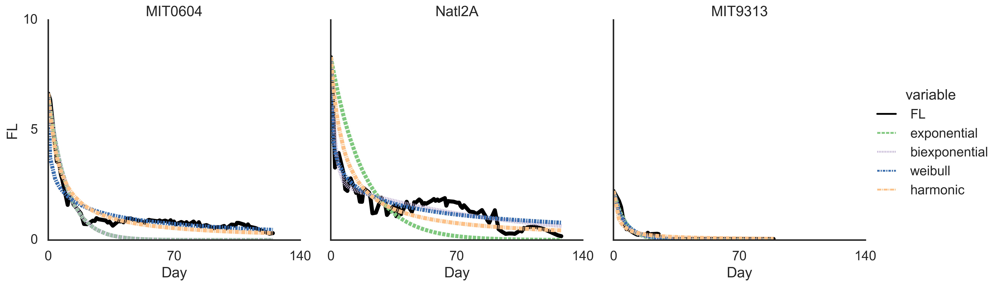

In [102]:

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=['MIT0604', 'Natl2A', 'MIT9313'],
        col_wrap=3,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(yticks=[0,5,10], xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

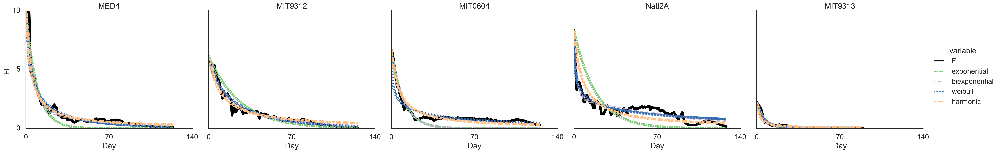

In [103]:

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
           # col_order=['MIT0604', 'Natl2A', 'MIT9313'],
            col_order=porder,
        #col_wrap=3,
        kind='line',
            #facet_kws=dict(margin_titles=True),
            linewidth=6,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1.2,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(#yscale='log',ylim=(1e-2,10),
                                         yticks=[0,5,10],
                                         xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
#plt.yscale('log')
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

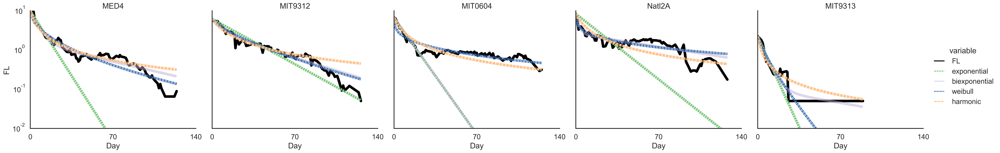

In [104]:

sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) 
                            #(dfresm['variable'].isin(['FL', 'exponential', 'biexponential'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
           # col_order=['MIT0604', 'Natl2A', 'MIT9313'],
            col_order=porder,
        #col_wrap=3,
        kind='line',
            #facet_kws=dict(margin_titles=True),
            linewidth=6,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1.2,
            palette=['black'] + mpalette,
            #col_wrap=3,
            #legend=False,
       ).set_axis_labels('Day','FL').set(yscale='log',ylim=(1e-2,10),
                                         #yticks=[0,5,10],
                                         xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)

#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
#plt.yscale('log')
plt.show()


# N0* exp(-at)
# N0*(f*exp(-a1*t) + (1-f)*exp(-a2*t))

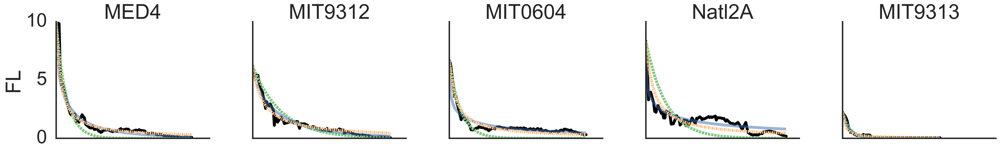

In [105]:
order_list = ['FL', 'exponential', 'weibull', 'harmonic']
sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
            palette=['black', mpalette[0], mpalette[2], mpalette[3]] ,
            
            legend=False
       ).set_axis_labels('','FL').set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

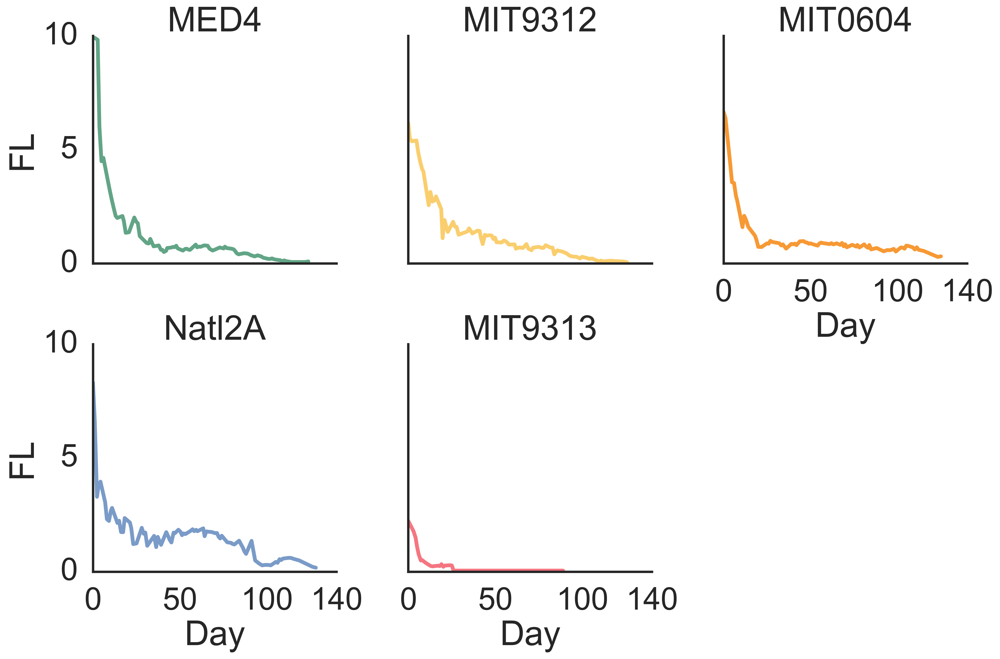

In [106]:
sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['FL'])) 
                           ], 
        x='day',
        y='value',
        #hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            col_wrap=3,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=4,
            hue='PRO',
            hue_order=porder,
            #style_order=['FL','exponential'],
            aspect=1,
            palette=ppallete,
            #col_wrap=3,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,5,10], xticks=[0,50,100,140]
                                     ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [107]:
dfscore.nlargest(6
                 , 'weibull_td')[['experiment', 'sample', 'PRO', 'ALT', 
                                  'weibull_n', 'weibull_a',
        'weibull_td', 'weibull_td2','rmse_weibull',
        'aic_weibull',]]

,experiment,sample,PRO,ALT,weibull_n,weibull_a,weibull_td,weibull_td2,rmse_weibull,aic_weibull
85,e1,9C,Natl2A,DE,0.075386,1.073296,24964.529066,2.457603e+08,0.513756,-107.224985
84,e1,9B,Natl2A,DE,0.100899,1.001450,3834.078062,3.691072e+06,0.555443,-94.430177
14,e1,14C,Natl2A,DE1,0.150188,0.789420,1245.973194,1.258536e+05,0.409954,-144.240601
83,e1,9A,Natl2A,DE,0.177822,0.686907,899.866512,4.436616e+04,0.578551,-87.745474
45,e1,24A,Natl2A,ATCC,0.253673,0.428035,759.671511,1.167649e+04,0.406680,-147.354801
13,e1,14B,Natl2A,DE1,0.181048,0.707828,675.403069,3.106478e+04,0.368048,-161.924926


In [108]:
dfscore.nsmallest(10, 'weibull_td')

,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,bic_harmonic,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2,p
161,"e4, 12A",e4,12A,MIT9313,DE1,Co_Culture,0.773035,1.0,1.0,0.055706,...,-392.261100,-396.609875,0.500000,0.772994,0.772994,0.006733,2.814410,1.128500e-13,5.808954e+31,MIT9313
124,"e3, 22C",e3,22C,MIT9313,ATCC,Co_Culture,0.515939,1.0,1.0,0.129059,...,-296.493205,-300.990195,0.500000,0.515945,0.515945,1.939836,0.241334,3.198816e+00,4.572698e+00,MIT9313
220,"e4, 7C",e4,7C,MIT9313,DE,Co_Culture,0.744416,0.5,0.5,0.071860,...,-351.964892,-356.344201,0.965427,0.829420,-0.000749,0.868590,0.778912,3.482926e+00,7.736016e+00,MIT9313
218,"e4, 7A",e4,7A,MIT9313,DE,Co_Culture,0.495667,0.5,0.5,0.067954,...,-325.463242,-329.842552,0.500000,0.495675,0.495659,1.763538,0.220034,3.786405e+00,5.609493e+00,MIT9313
205,"e4, 2C",e4,2C,MIT9313,1A3,Co_Culture,0.305405,0.5,0.5,0.057499,...,-373.421535,-377.860551,0.500000,0.305405,0.305405,1.826402,0.121150,5.014476e+00,7.329036e+00,MIT9313
204,"e4, 2A",e4,2A,MIT9313,1A3,Co_Culture,0.317597,1.0,1.0,0.058898,...,-354.074533,-358.483918,0.999958,0.317604,0.309937,1.825450,0.110131,5.287832e+00,7.730097e+00,MIT9313
219,"e4, 7B",e4,7B,MIT9313,DE,Co_Culture,0.323614,1.0,1.0,0.066410,...,-349.450783,-353.860168,1.000000,0.323578,0.207666,1.787874,0.114509,5.358063e+00,7.895524e+00,MIT9313
162,"e4, 12B",e4,12B,MIT9313,DE1,Co_Culture,0.566138,1.0,1.0,0.062220,...,-405.831537,-410.180311,0.924660,0.937709,0.006817,0.119108,1.883956,5.390676e+00,1.815534e+03,MIT9313
53,"e1, 28A",e1,28A,MIT9312,Ax_Pro,Axenic,0.310476,1.0,1.0,0.411461,...,-42.032639,-46.796692,0.500000,0.310478,0.310478,3.348832,0.005822,5.963866e+00,7.335318e+00,MIT9312_Axenic
55,"e1, 28C",e1,28C,MIT9312,Ax_Pro,Axenic,0.311959,1.0,1.0,0.268673,...,-79.936345,-84.700399,0.508089,0.311974,0.311961,1.858888,0.081955,6.015959e+00,8.734655e+00,MIT9312_Axenic


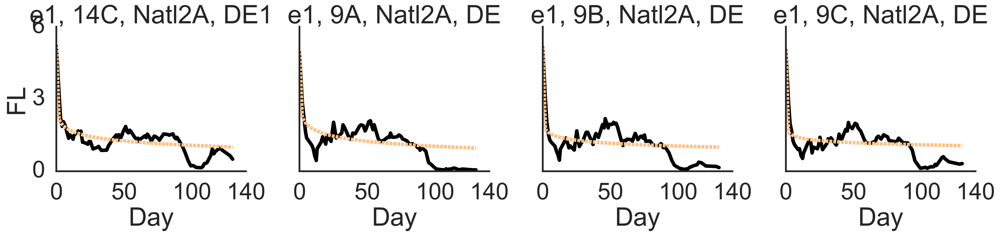

In [109]:
sample_list = ['e1, 9C', 'e1, 9B', 'e1, 14C', 'e1, 9A', 
               #'e4, 12A', 'e3, 22C'
              ]
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,3,6], xticks=[0,50, 100, 140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

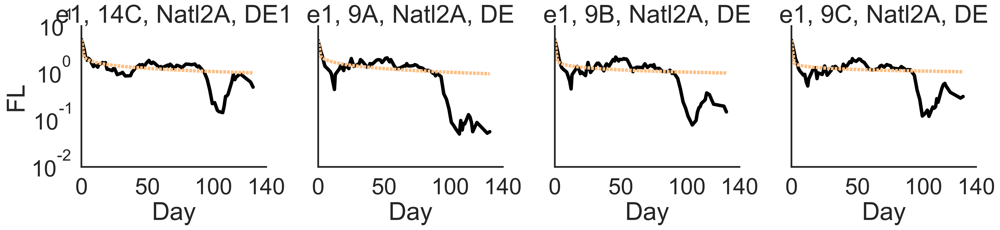

In [110]:
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(#yticks=[0,3,6], 
    yscale='log',
    xticks=[0,50,100,140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [111]:
models

['exponential', 'biexponential', 'weibull', 'harmonic']

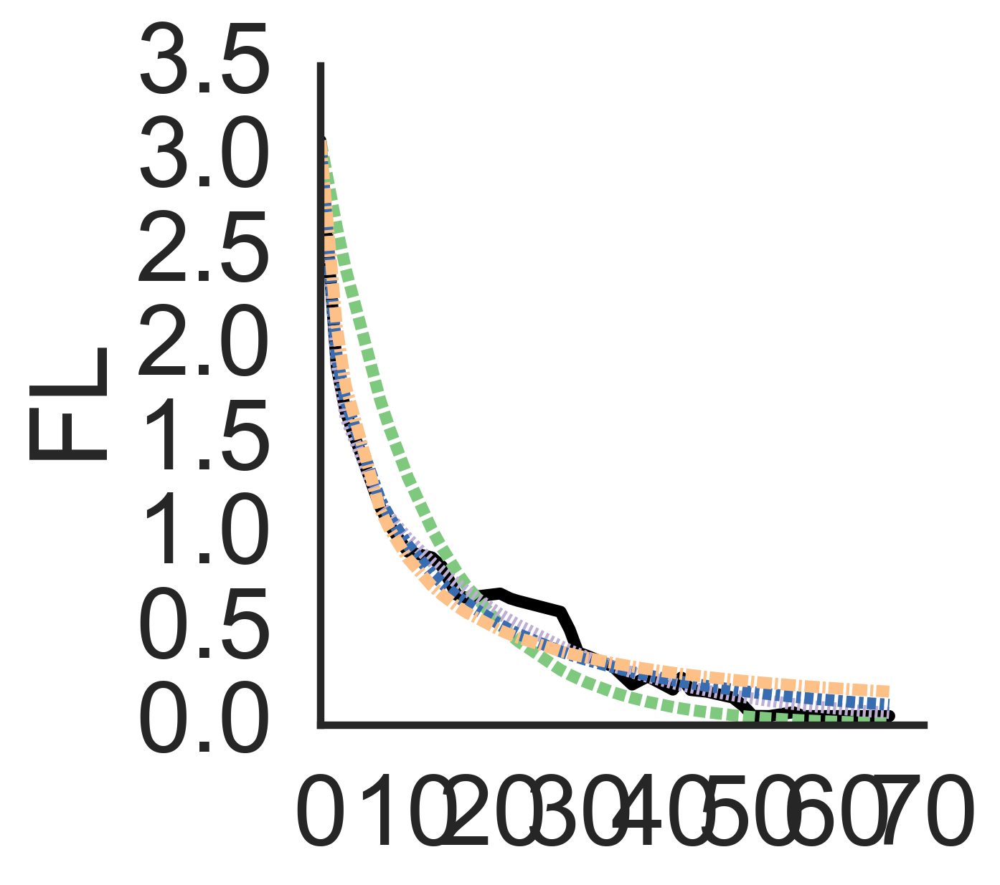

In [112]:
#sns.set(style='white',context='paper')
#['e5, 13B']
sns.relplot(data=dfresm.loc[(dfresm.experiment_sample == 'e5, 13B')  #&
                            #(dfresm['variable'].isin(['FL', #'exponential', 'biexponential', 'harmonic',  
                            #                          'logistic', 'weibull'])) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        kind='line',
            linewidth=4,
            hue_order=['FL'] + models,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            #aspect=1,
            palette=['black']+mpalette,
            #col_wrap=3,
            legend=False
       ).set_axis_labels('','FL') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [113]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'rmse_exponential', 'bic_exponential', 'aic_exponential',
       'biexponential_popt_0', 'biexponential_popt_1', 'biexponential_popt_2',
       'rmse_biexponential', 'bic_biexponential', 'aic_biexponential',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2', 'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'f',
       'a1', 'a2', 'weibull_n', 'weibull_a', 'weibull_td', 'weibull_td2', 'p'],
      dtype='object')

Text(0.5, 1.0, 'Weibull shape parameter n')

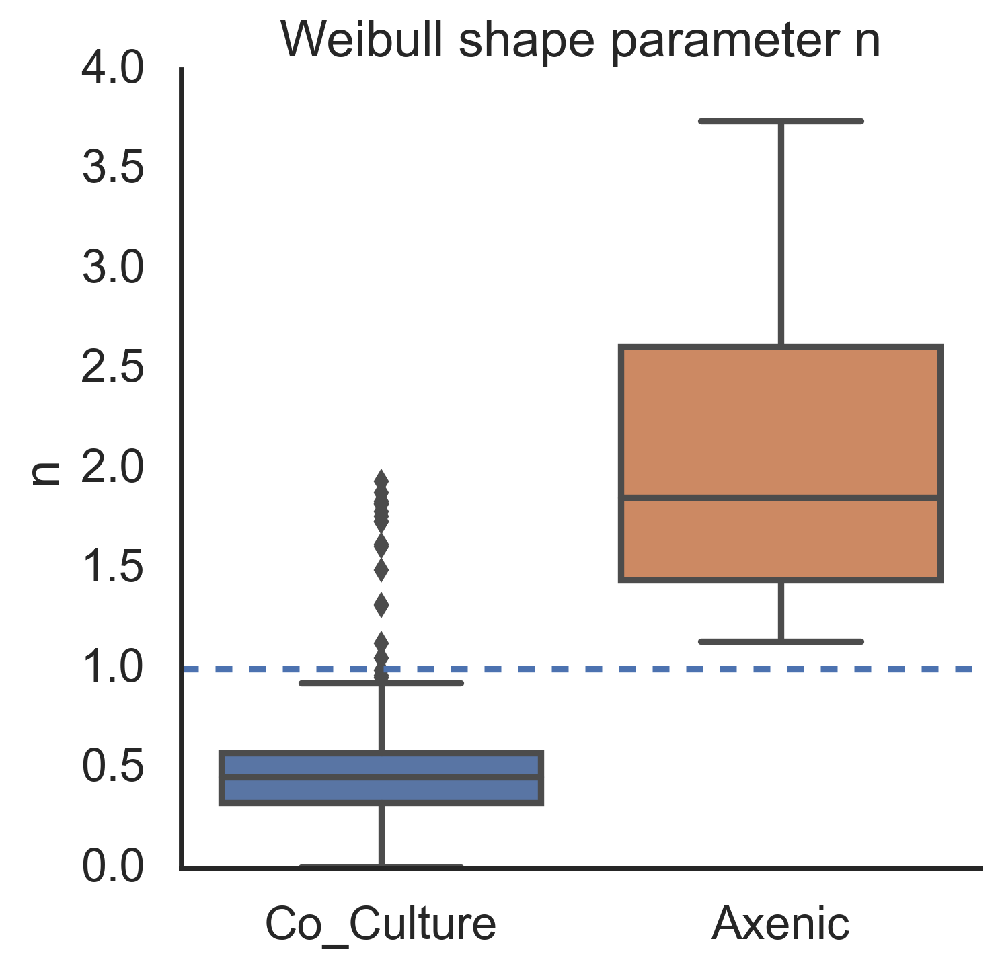

In [157]:
sns.set(style='white',context='talk')

sns.catplot(data = dfscore
            , y='weibull_n', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.title('Weibull shape parameter n')

Text(0.5, 0.98, 'Weibull n')

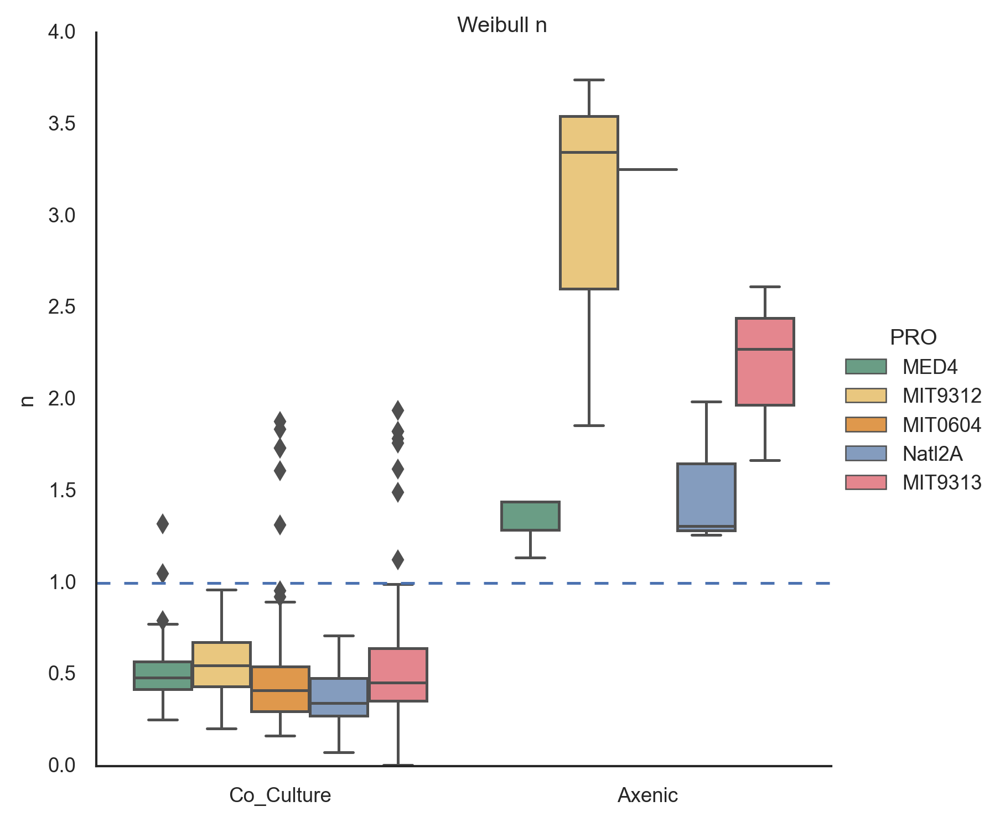

In [152]:
sns.catplot(data = dfscore
            , y='weibull_n', x='culture', #element="step",
             kind="box", 
            hue='PRO', hue_order=porder, palette=ppallete,
            #col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 0.98, 'Weibull n')

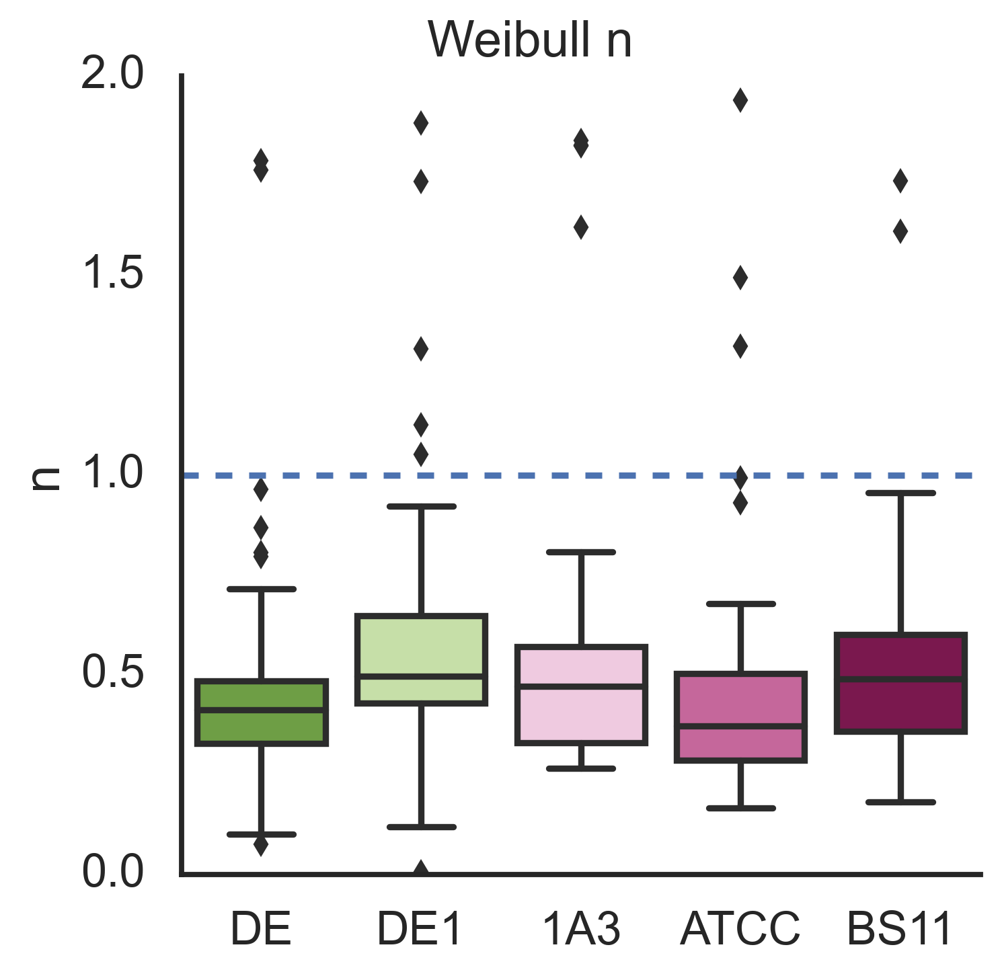

In [116]:
sns.set_context('talk')
sns.catplot(data = dfscore
            , y='weibull_n', 
             kind="box", 
            x='ALT', order=aorder, palette=apallete,
            #col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 0.98, 'Weibull n')

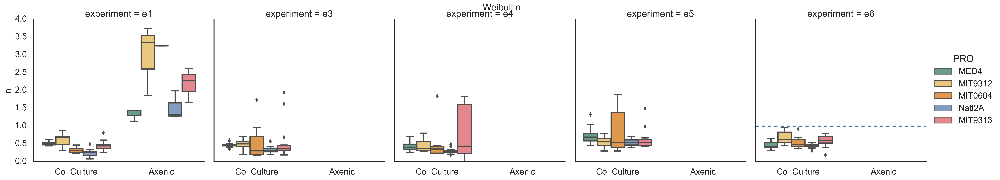

In [117]:
g=sns.catplot(data = dfscore
            , y='weibull_n', x='culture', #element="step",
             kind="box", 
            hue='PRO', hue_order=porder, palette=ppallete,
            col='experiment'

       ).set_axis_labels('','n') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
plt.axhline(1, ls='--')
plt.suptitle('Weibull n')

Text(0.5, 1.0, 'Weibull a')

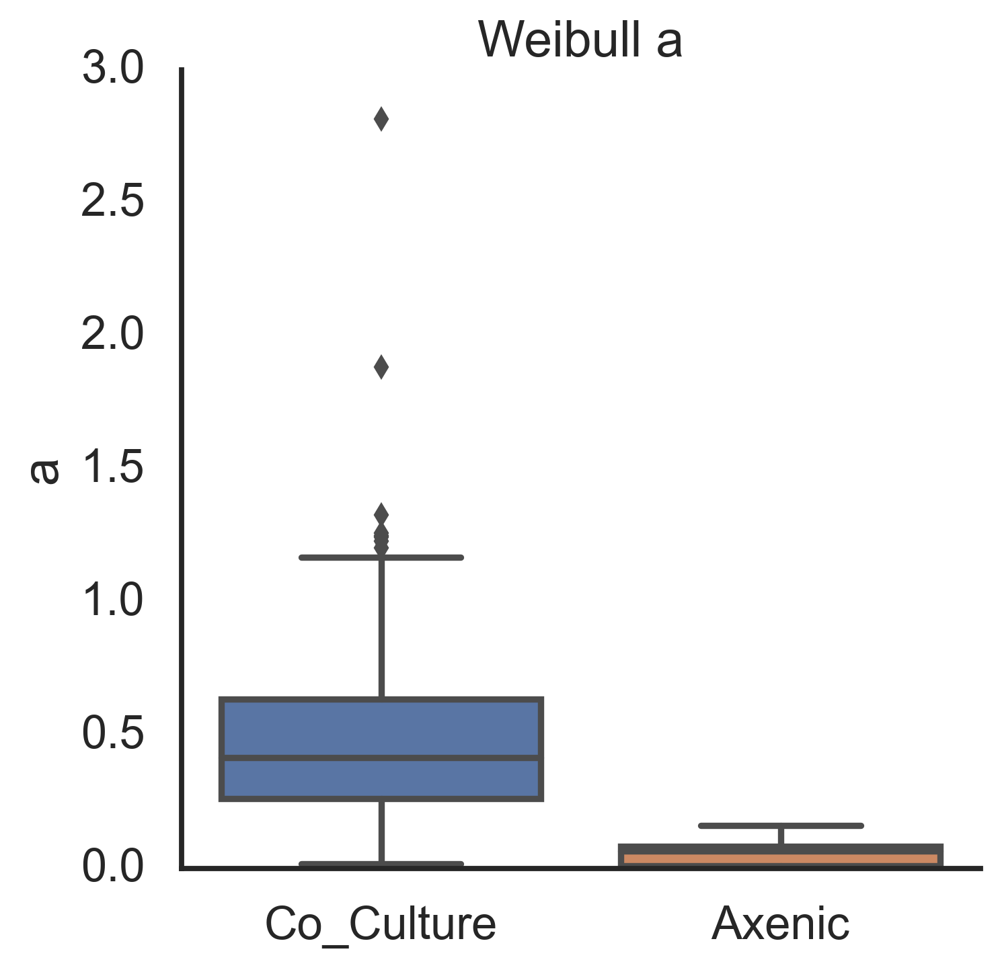

In [118]:
sns.catplot(data = dfscore
            , y='weibull_a', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','a') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('Weibull a')

Text(0.5, 1.0, 'Weibull td')

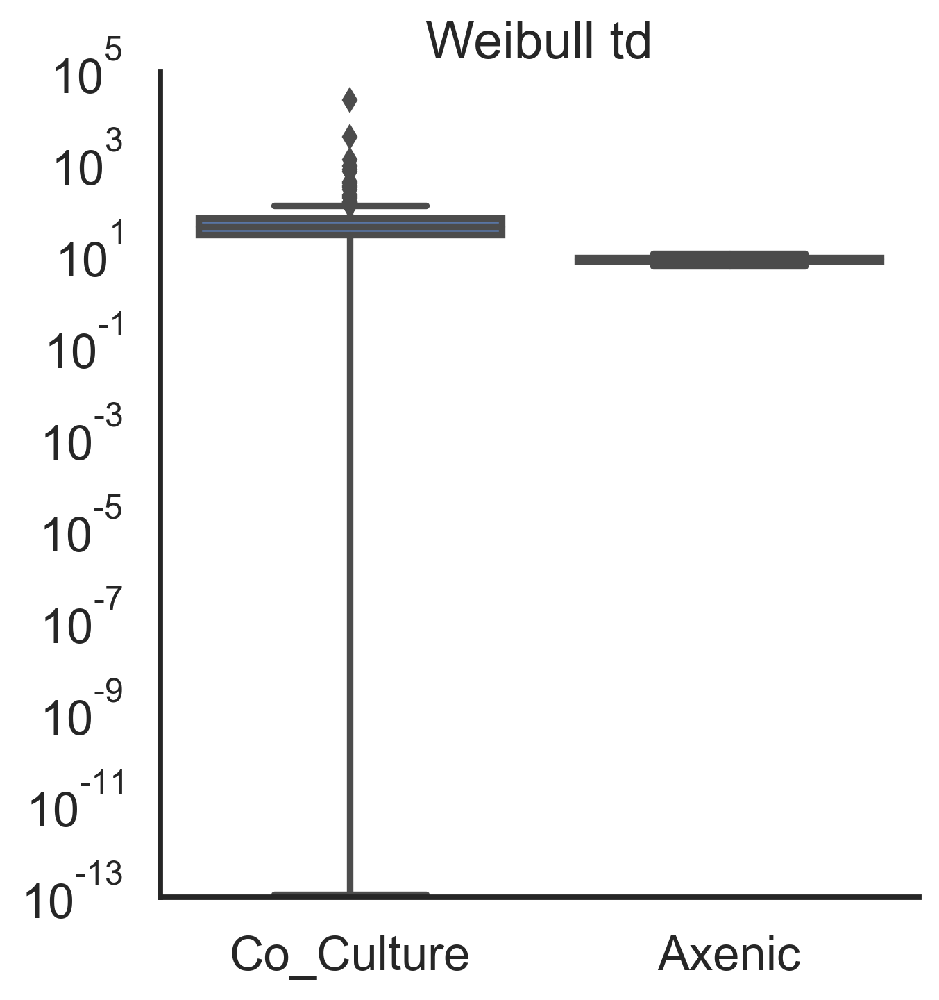

In [119]:
sns.catplot(data = dfscore
            , y='weibull_td', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.yscale('log')
plt.title('Weibull td')

Text(0.5, 1.1, 'Weibull td (co-cultures)')

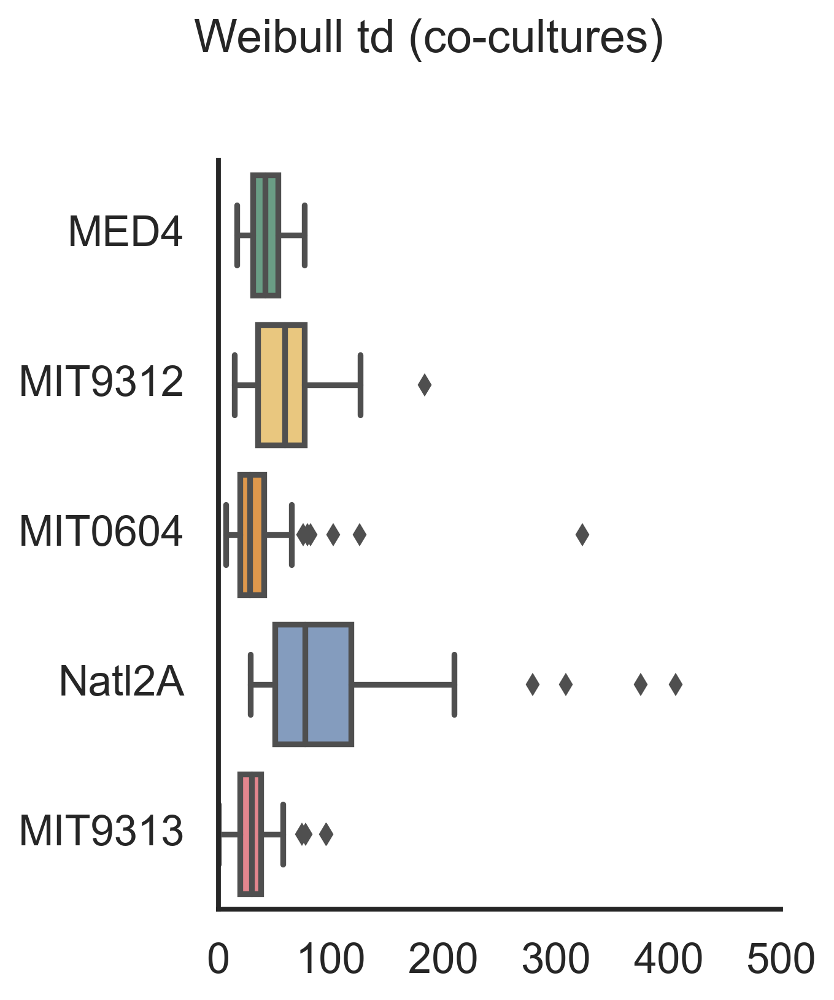

In [120]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td', #col='culture', #element="step",
            y='PRO', order=porder, palette=ppallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,500))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (99% decline)')

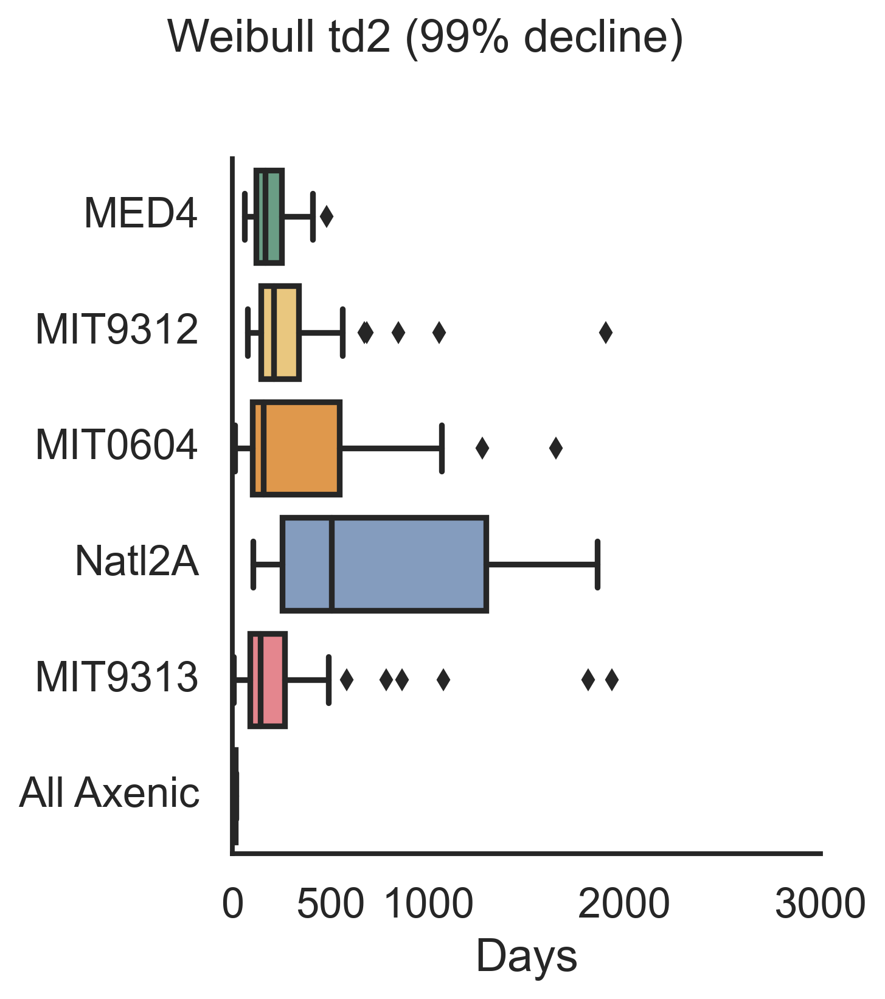

In [189]:
sns.set_context('talk')
dfscore['PRO2'] =dfscore['PRO']
dfscore.loc[dfscore.culture.isin(['Axenic']), 'PRO2'] = 'All Axenic'
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                            ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO2', order=porder + ['All Axenic'], palette=ppallete + ['purple'],
             kind="box", #multiple='stack'
       ).set_axis_labels('Days','') .set_titles('{col_name}').set(xticks=[0,500, 1000,2000,3000])
#.set(xscale='log',xlim=(0,1e5))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
plt.xlim((0,3e3))
#plt.xscale('log')
plt.suptitle('Weibull td2 (99% decline)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (99% decline) e1')

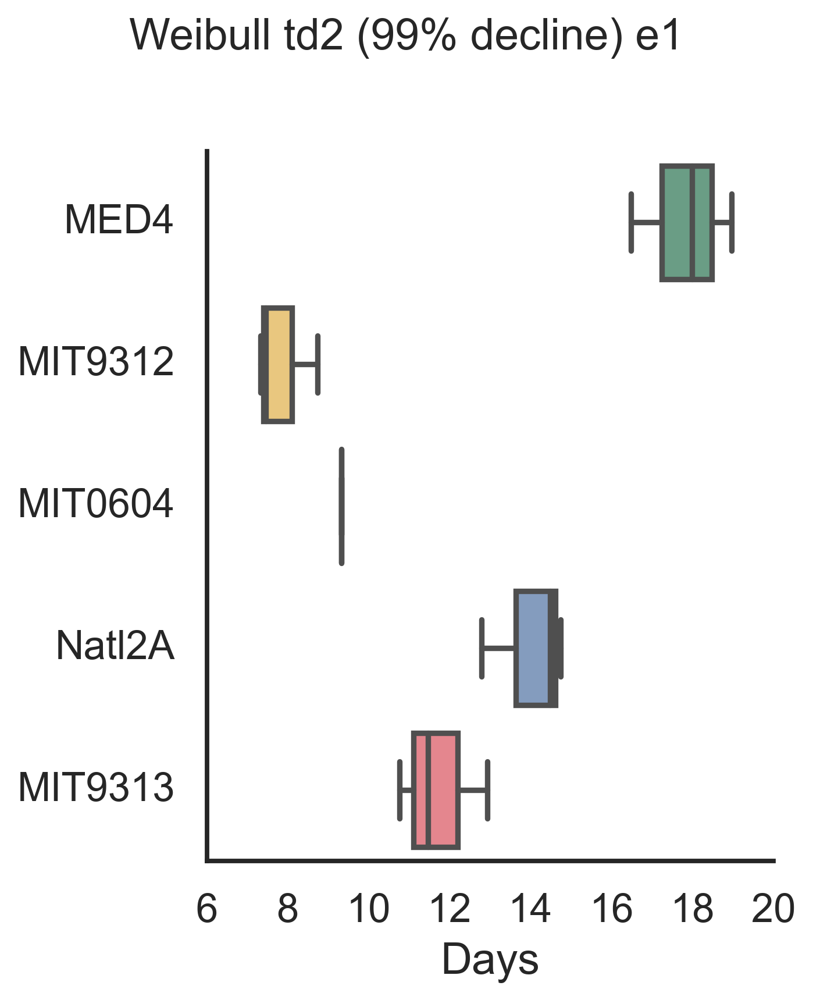

In [193]:
sns.set_context('talk')
dfscore['PRO2'] =dfscore['PRO']
dfscore.loc[dfscore.culture.isin(['Axenic']), 'PRO2'] = 'All Axenic'
sns.catplot(data = dfscore.loc[dfscore.experiment.isin(['e1']) &
                               dfscore.culture.isin(['Axenic'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                            ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO', order=porder , palette=ppallete ,
             kind="box", #multiple='stack'
       ).set_axis_labels('Days','') .set_titles('{col_name}')#.set(xticks=[0,500, 1000,2000,3000])
#.set(xscale='log',xlim=(0,1e4))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xlim((0,3e3))
#plt.xscale('log')
plt.suptitle('Weibull td2 (99% decline) e1', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (99% decline)')

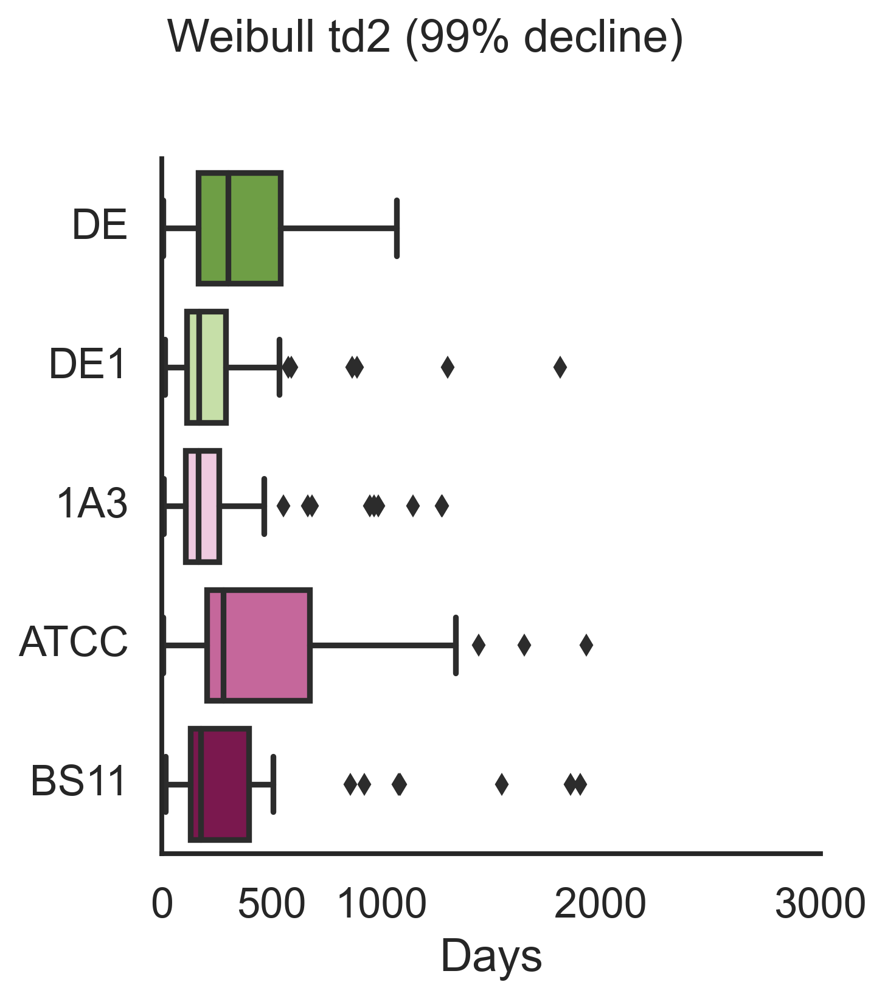

In [155]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            y='ALT', order=aorder,
             palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('Days','') .set_titles('{col_name}').set(xlim=(0,3000),xticks=[0,500, 1000,2000,3000])

#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (99% decline)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (co-cultures)')

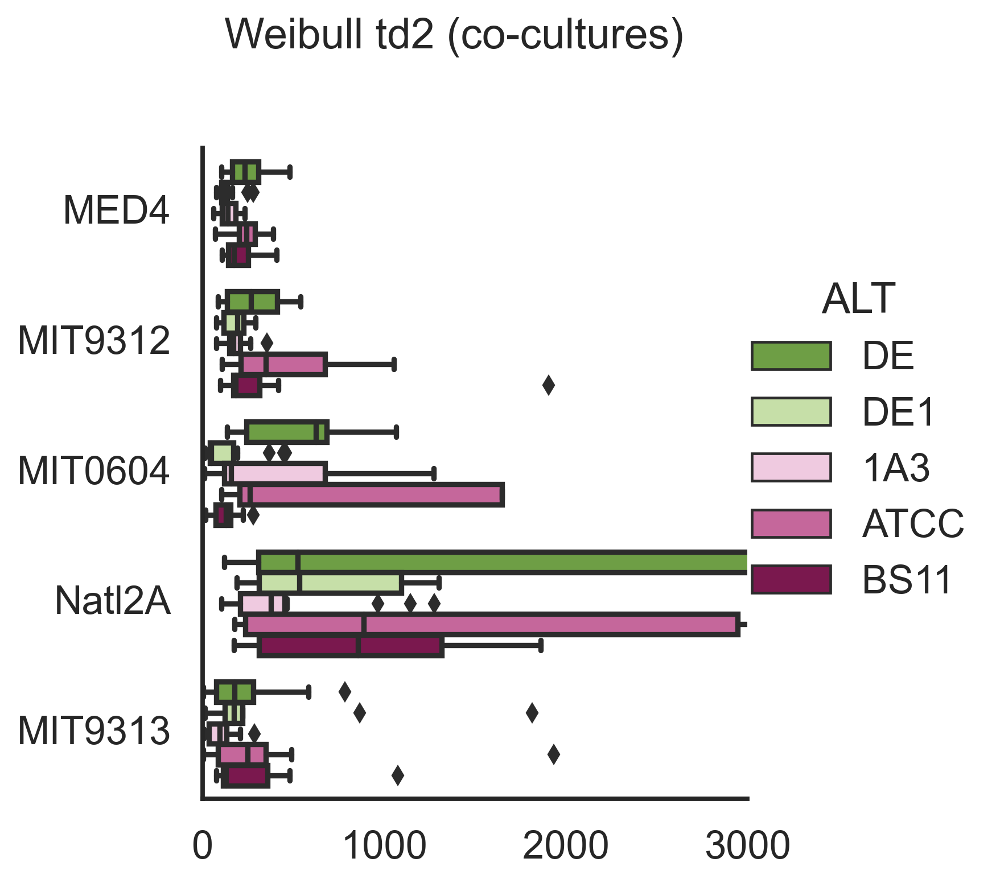

In [123]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO', order=porder,
            hue='ALT', hue_order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,3000), xticks=[0,1000,2000,3000])# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (co-cultures)')

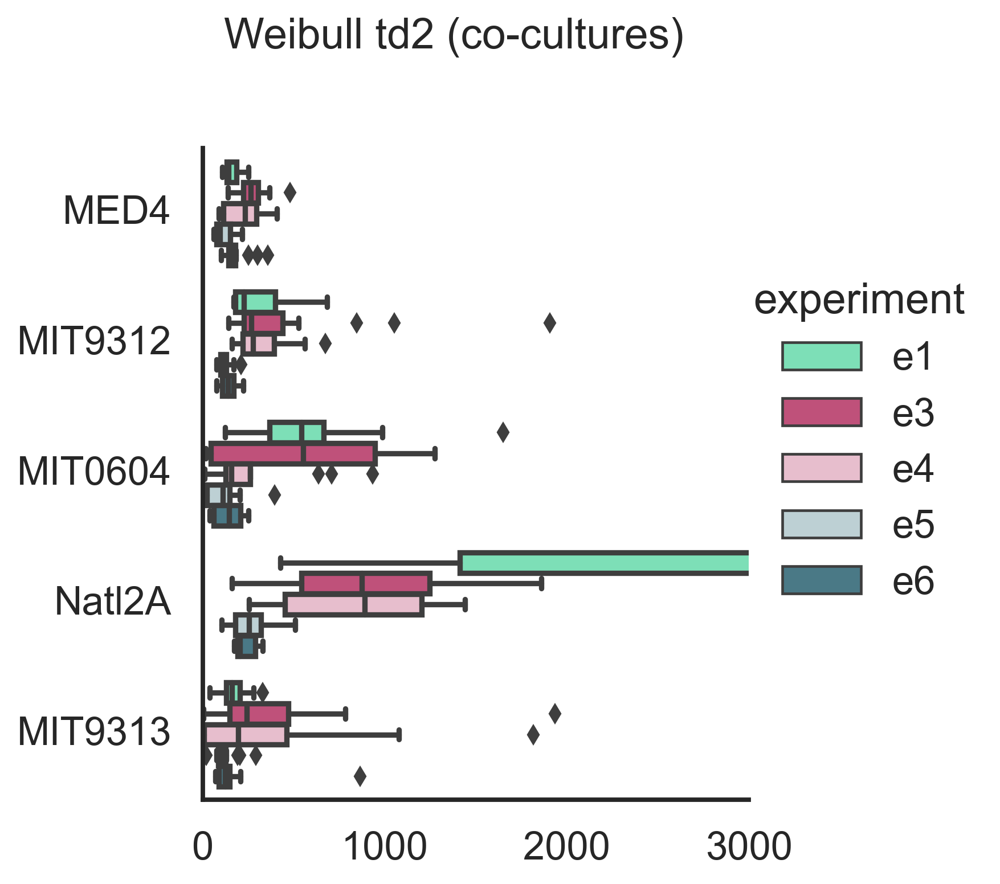

In [159]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture'])  
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            y='PRO', order=porder,
            hue='experiment', hue_order=eorder, palette=epallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,3000), xticks=[0,1000,2000,3000])# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td (Natl2A co-cultures)')

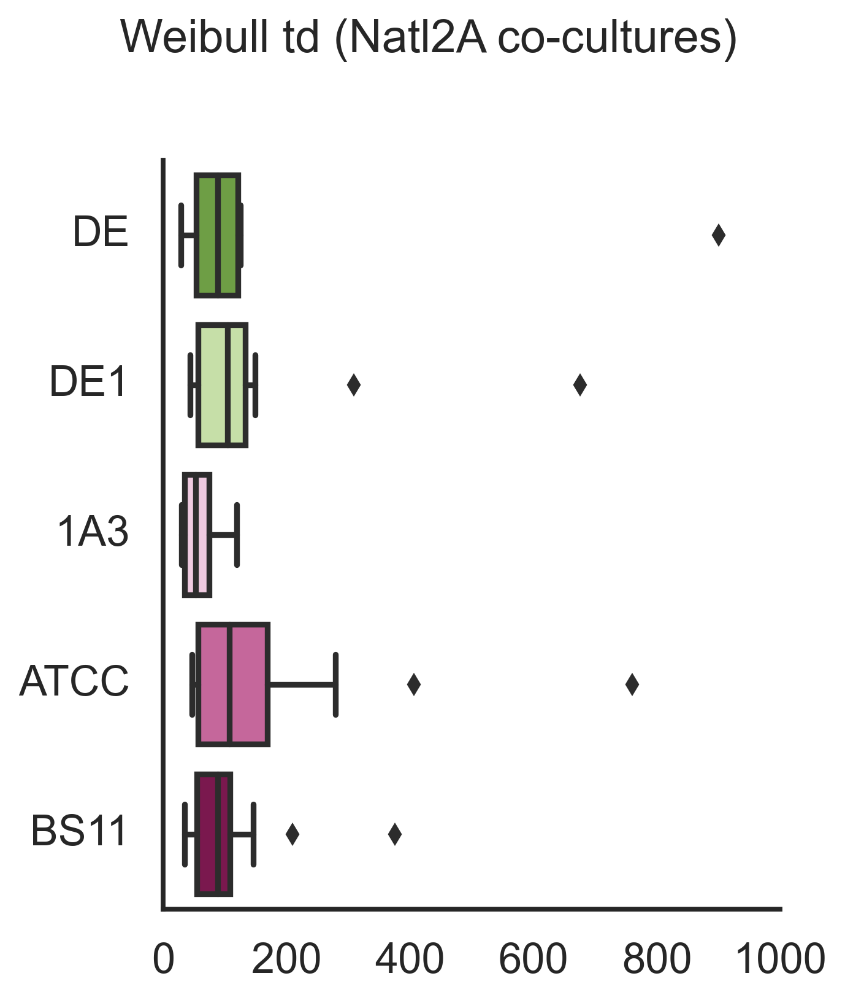

In [124]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture']) & 
                               dfscore.PRO.isin(['Natl2A']) 
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td', #col='culture', #element="step",
            #y='PRO', order=porder,
            y='ALT', order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,1000))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td (Natl2A co-cultures)', y=1.1)

Text(0.5, 1.1, 'Weibull td2 (Natl2A co-cultures)')

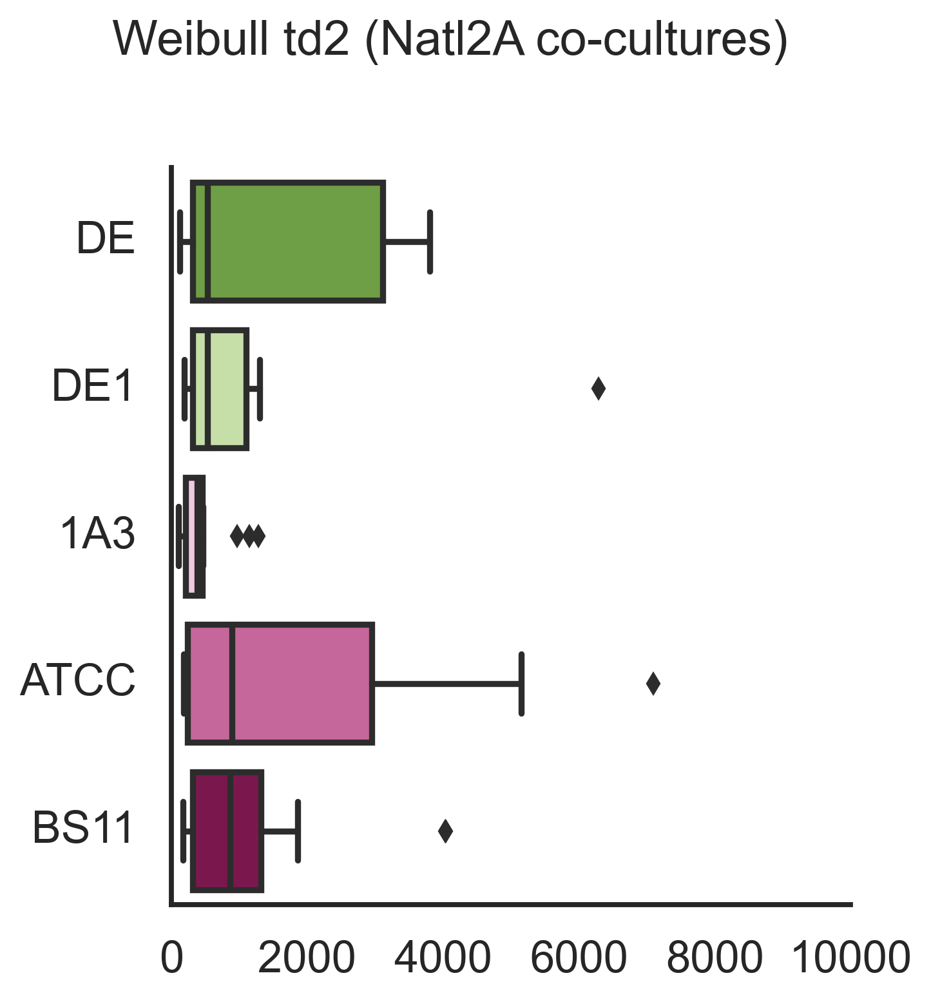

In [125]:
sns.set_context('talk')
sns.catplot(data = dfscore.loc[dfscore.culture.isin(['Co_Culture']) & 
                               dfscore.PRO.isin(['Natl2A']) 
                               #(dfscore.weibull_td >1e-10) #&
                               #(dfscore.weibull_td <1e4) 
                              ]
            , x='weibull_td2', #col='culture', #element="step",
            #y='PRO', order=porder,
            y='ALT', order=aorder, palette=apallete,
             kind="box", #multiple='stack'
       ).set_axis_labels('','') .set_titles('{col_name}').set(xlim=(0,10000))# .set(font_scale=2)
#.set(yticks=[0,5,10], xticks=[])
#plt.axhline(1)
#plt.xscale('log')
plt.suptitle('Weibull td2 (Natl2A co-cultures)', y=1.1)

In [173]:
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', 'Axenic']) & 
                   dfscore.experiment.isin(['e1'])
                  ]

stats.ttest_ind(
    dfdata.loc[dfdata.culture.isin(['Axenic']), 'weibull_n'],
    dfdata.loc[dfdata.culture.isin(['Co_Culture']), 'weibull_n'],
    equal_var = False
)

Ttest_indResult(statistic=6.834729874509021, pvalue=1.6904020902572607e-05)

In [174]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Axenic', ]) & 
                   dfscore.experiment.isin(['e1'])
                  ]

mod = ols('weibull_td2 ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'weibull_td2 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'weibull_td2 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:            weibull_td2   R-squared:                       0.949
Model:                            OLS   Adj. R-squared:                  0.924
Method:                 Least Squares   F-statistic:                     37.35
Date:                Wed, 17 Mar 2021   Prob (F-statistic):           3.20e-05
Time:                        23:26:12   Log-Likelihood:                -16.069
No. Observations:                  13   AIC:                             42.14
Df Residuals:                       8   BIC:                             44.96
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept            17.8143      0.61

C:\Users\wosnat\Anaconda3\lib\site-packages\scipy\stats\stats.py:1604: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=13
  "anyway, n=%i" % int(n))


In [191]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])
                  ]

mod = ols('weibull_td2 ~ C(PRO)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'weibull_td2 as function of PRO strain')
pair_t = mod.t_test_pairwise("C(PRO)", method='b')
print(pair_t.result_frame)
print(f'weibull_td2 as function of PRO strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:            weibull_td2   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.9979
Date:                Wed, 17 Mar 2021   Prob (F-statistic):              0.415
Time:                        23:38:27   Log-Likelihood:                -1354.7
No. Observations:                  73   AIC:                             2719.
Df Residuals:                      68   BIC:                             2731.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
Intercept           161.9148   7.43e+0

In [166]:
from statsmodels.formula.api import ols
dfdata=dfscore.loc[dfscore.culture.isin(['Co_Culture', ]) & 
                   dfscore.experiment.isin(['e1'])
                  ]

mod = ols('weibull_td2 ~ C(ALT)',
                data=dfdata).fit()
#print (f'++++++++++++++++++ day = {d} +++++++++++++++++++++++')
print(mod.summary())
print(sm.stats.anova_lm(mod))
print(f'weibull_td2 as function of ALT strain')
pair_t = mod.t_test_pairwise("C(ALT)", method='b')
print(pair_t.result_frame)
print(f'weibull_td2 as function of ALT strain')
print(pair_t.result_frame.loc[pair_t.result_frame['reject-b'], 'pvalue-b'])
#aov_table = sm.stats.anova_lm(mod, typ=2)
#print(aov_table)

                            OLS Regression Results                            
Dep. Variable:            weibull_td2   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.9959
Date:                Wed, 17 Mar 2021   Prob (F-statistic):              0.416
Time:                        23:13:13   Log-Likelihood:                -1354.7
No. Observations:                  73   AIC:                             2719.
Df Residuals:                      68   BIC:                             2731.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept        467.6051   7.43e+06    6.3e

Text(0.5, 1.0, 'harmonic a')

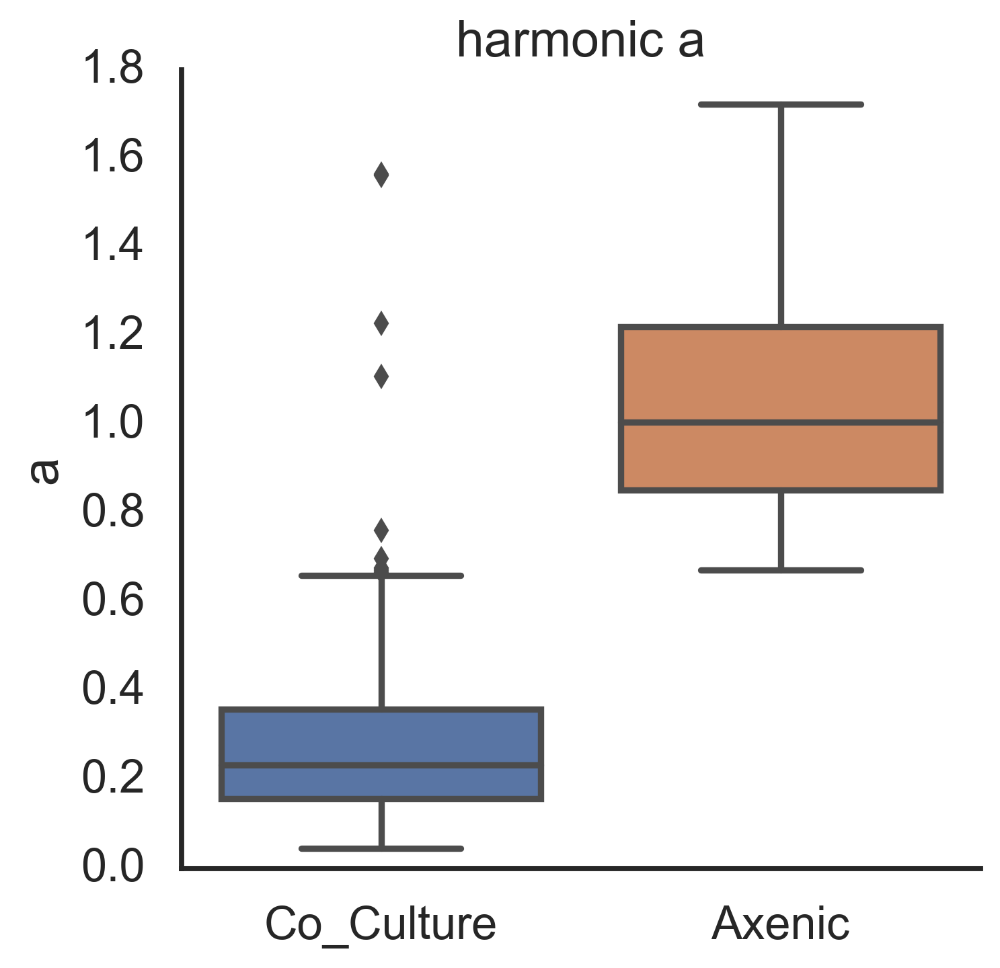

In [126]:
sns.catplot(data = dfscore
            , y='harmonic_popt_0', x='culture', #element="step",
             kind="box", #multiple='stack'
       ).set_axis_labels('','a') #.set(yticks=[0,5,10], xticks=[]).set_titles('{col_name}')# .set(font_scale=2)
#plt.axhline(1)
plt.title('harmonic a')

In [127]:
best_model_df.loc[best_model_df.model.isin(['aic_weibull']) & best_model_df.PRO.isin(['Natl2A']) & 
                   best_model_df.experiment.isin(['e1']) 
                 ].nsmallest(30,'RMSE')

,experiment_sample,experiment,sample,PRO,ALT,culture,model,RMSE,s,e,p
2188,"e1, 27C",e1,27C,Natl2A,Ax_Pro,Axenic,aic_weibull,-303.453895,"27C, Ax_Pro","e1, Axenic",Natl2A_axenic
2186,"e1, 27A",e1,27A,Natl2A,Ax_Pro,Axenic,aic_weibull,-231.781226,"27A, Ax_Pro","e1, Axenic",Natl2A_axenic
2187,"e1, 27B",e1,27B,Natl2A,Ax_Pro,Axenic,aic_weibull,-223.040134,"27B, Ax_Pro","e1, Axenic",Natl2A_axenic
2183,"e1, 24C",e1,24C,Natl2A,ATCC,Co_Culture,aic_weibull,-196.043897,"24C, ATCC","e1, Co_Culture",Natl2A


In [128]:
# natl2a
sample_list = ['e1, 14A', 'e1, 27A', #'e1, 4A', 'e1, 4C','e3, 4A', 'e1, 27A','e4, 24B', 'e3, 24B', 'e3, 14B'
              ]
# mit9312
#sample_list = ['e1, 13C', 'e1, 28A', 'e1, 13A', 'e1, 3A']

dfscore.loc[dfscore.experiment_sample.isin(sample_list)]
            #, x='weibull_popt_2', hue='PRO', #element="step",


,experiment_sample,experiment,sample,PRO,ALT,culture,exponential_popt_0,exponential_popt_1,exponential_popt_2,rmse_exponential,...,aic_harmonic,f,a1,a2,weibull_n,weibull_a,weibull_td,weibull_td2,p,PRO2
12,"e1, 14A",e1,14A,Natl2A,DE1,Co_Culture,0.030155,0.5,0.5,0.803114,...,-133.585116,0.700497,0.320191,0.005709,0.230076,0.615633,309.040866,6286.479559,Natl2A,Natl2A
50,"e1, 27A",e1,27A,Natl2A,Ax_Pro,Axenic,0.250002,0.5,0.5,0.271268,...,-112.486521,0.500000,0.250002,0.250002,1.311162,0.135190,8.690969,14.745465,Natl2A_Axenic,All Axenic


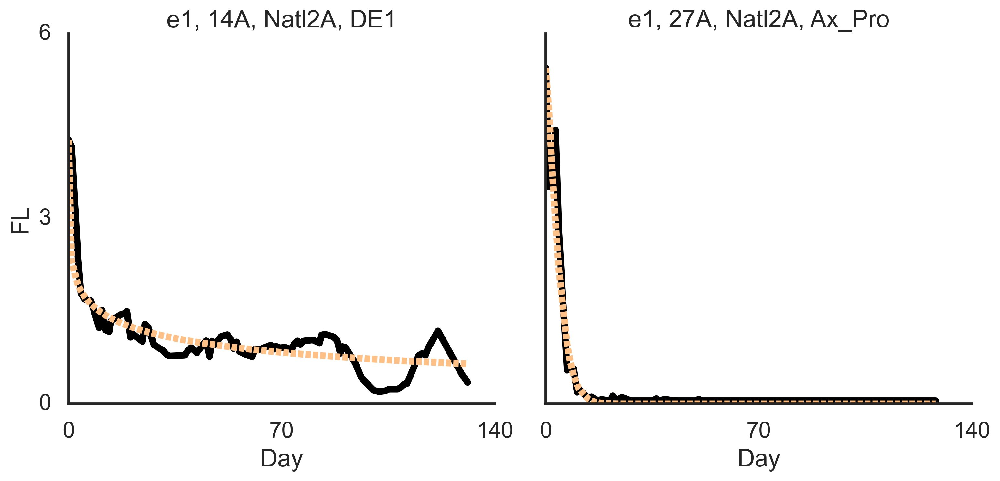

In [129]:
order_list = ['FL', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(yticks=[0,3,6], xticks=[0,70,140]).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

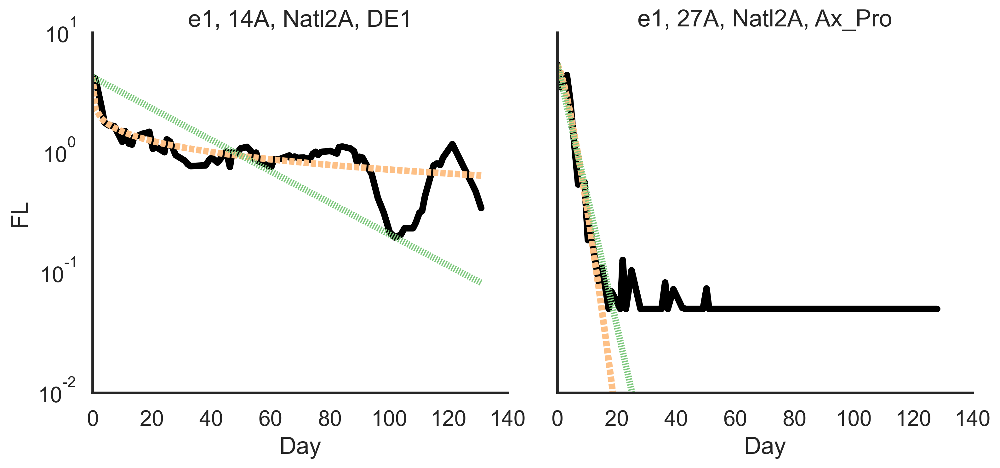

In [130]:
order_list = ['FL', 'weibull', 'exponential', ]

#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            palette=['black', mpalette[3], mpalette[0]] ,
            legend=False
       ).set_axis_labels('Day','FL').set(#yticks=[0,3,6], 
                                        #xticks=[0,70,140], 
    ylim=(1e-2,10),
                                         yscale='log',
                                        ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [131]:
# weibull derivative:
# an t^(n−1) e^(−at^n)
def compute_weibull_derivative(es, t):
    #print(es)
    a = dfscore.loc[dfscore.experiment_sample.isin([es]), 'weibull_popt_0'].values[0]
    n = dfscore.loc[dfscore.experiment_sample.isin([es]), 'weibull_popt_2'].values[0]
    res = a * n * np.power(t, n-1)* np.exp(-a* np.power(t,n))
    #print(es, a, n, t, res)
    
    return res

In [132]:
dfresm['weibull_distribution'] = dfresm.apply(
    lambda x: compute_weibull_derivative(x['experiment_sample'], x['day']), axis=1)

C:\Users\wosnat\Anaconda3\lib\site-packages\ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in power
  import sys


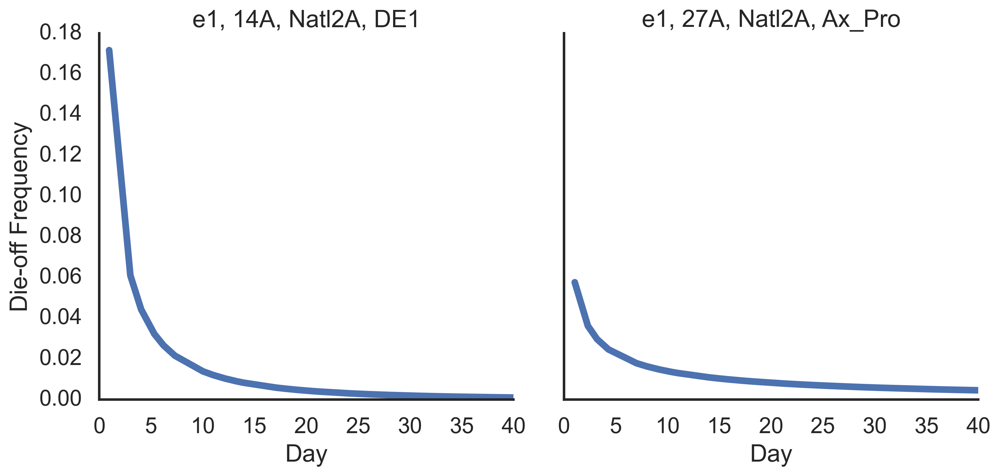

In [133]:
order_list = ['FL', 'exponential', 'weibull',]
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(sample_list) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='weibull_distribution',
        #hue='weibull_distribution',
        #    style='weibull_distribution',
        col='a',
            col_wrap=4,
            #col_order=porder,
        kind='line',
            linewidth=5,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            #palette=['black', mpalette[0], mpalette[3]] ,
            legend=False
       ).set_axis_labels('Day','Die-off Frequency').set(xlim=(0,40),#yticks=[0,3,6], 
                                        #xticks=[0,70,140], 
    #ylim=(1e-2,10),
     #                                    yscale='log'
                                        ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [134]:
dfscore.columns

Index(['experiment_sample', 'experiment', 'sample', 'PRO', 'ALT', 'culture',
       'exponential_popt_0', 'exponential_popt_1', 'exponential_popt_2',
       'rmse_exponential', 'bic_exponential', 'aic_exponential',
       'biexponential_popt_0', 'biexponential_popt_1', 'biexponential_popt_2',
       'rmse_biexponential', 'bic_biexponential', 'aic_biexponential',
       'weibull_popt_0', 'weibull_popt_1', 'weibull_popt_2', 'rmse_weibull',
       'bic_weibull', 'aic_weibull', 'harmonic_popt_0', 'harmonic_popt_1',
       'harmonic_popt_2', 'rmse_harmonic', 'bic_harmonic', 'aic_harmonic', 'f',
       'a1', 'a2', 'weibull_n', 'weibull_a', 'weibull_td', 'weibull_td2', 'p',
       'PRO2'],
      dtype='object')

In [135]:
dfresm.variable.value_counts()

weibull          21514
biexponential    21514
harmonic         21514
FL               21514
exponential      21514
Name: variable, dtype: int64

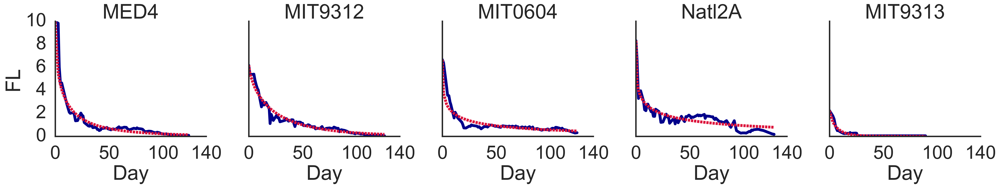

In [136]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3'])) &
                            (dfresm['sample'].str.endswith('B')) &
                            (dfresm['variable'].isin(['FL', 'weibull'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
            style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            #hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=5,
            hue_order=['FL','weibull'],
            style_order=['FL','weibull'],
            aspect=1,
            palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False,
       ).set_titles('{col_name}').set_axis_labels('Day','FL').set(
    xticks=[0,50, 100, 140], #yticks=[-2, 0, 2, 4]
)
    
plt.show()

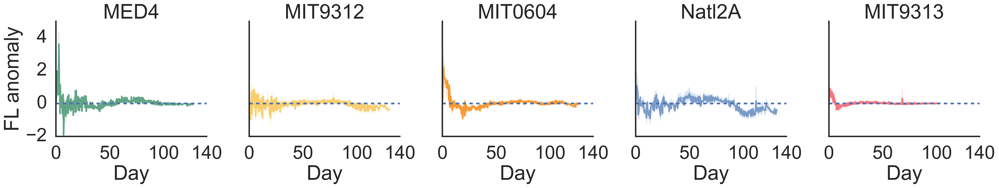

In [137]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dferrm.loc[(dferrm.experiment == 'e1') & (~dferrm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False,
       ).set_titles('{col_name}').set_axis_labels('Day','FL anomaly').set(
    xticks=[0,50, 100, 140], yticks=[-2, 0, 2, 4])
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

In [138]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dferrm.loc[(dferrm.experiment == 'e1') & #(~dferrm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            row='ALT',
            row_order=aorder + ['Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False,
       ).set_titles('{col_name}').set_axis_labels('Day','FL anomaly').set(
    xticks=[0,50, 100, 140], yticks=[-2, 0, 2, 4])
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

In [139]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dferrm.loc[#(dferrm.experiment == 'e1') & (~dferrm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='PRO',
            row='ALT',
            row_order=aorder + ['Ax_Pro'],
            col_order=porder,
            #col_wrap=2,
            hue='PRO', hue_order=porder, palette=ppallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False,
       ).set_titles('{col_name}').set_axis_labels('Day','FL anomaly').set(
    xticks=[0,50, 100, 140], yticks=[-2, 0, 2, 4])
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

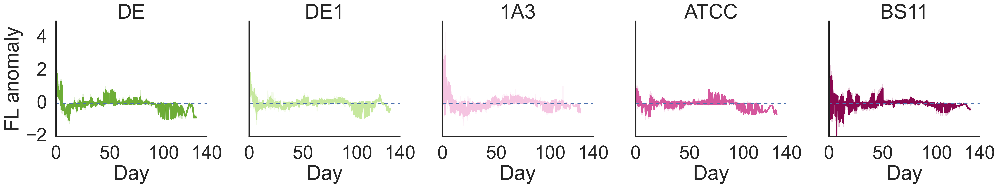

In [140]:
sns.set_context('poster')
sns.set(font_scale=1.5, style='white', context='poster')

g = sns.relplot(data=dferrm.loc[(dferrm.experiment == 'e1') & (~dferrm.ALT.isin(['Ax_Pro'])) &
                            #(dfresm['sample'].str.endswith('B')) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        #hue='variable',
        #    style='variable',
        col='ALT',
            #row='ALT',
            #row_order=['1A3','Ax_Pro'],
            col_order=aorder,
            #col_wrap=2,
            hue='ALT', hue_order=aorder, palette=apallete,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            #facet_kws=dict(margin_titles=True),
            linewidth=3,
            #hue_order=['FL','exponential'],
            #style_order=['FL','exponential'],
            aspect=1,
            #palette=['DarkBlue','Crimson'],
            #col_wrap=3,
                legend=False,
       ).set_titles('{col_name}').set_axis_labels('Day','FL anomaly').set(
    xticks=[0,50, 100, 140], yticks=[-2, 0, 2, 4])
axes = g.fig.axes
for ax in axes:
    ax.axhline(0, ls='--', lw=3)
    
plt.show()

In [141]:
df1 = dferrm.loc[(dferrm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dferrm.culture.isin(['Co_Culture', 'Axenic'])) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)

Variance percent explained
 [0.50365292 0.29646803]


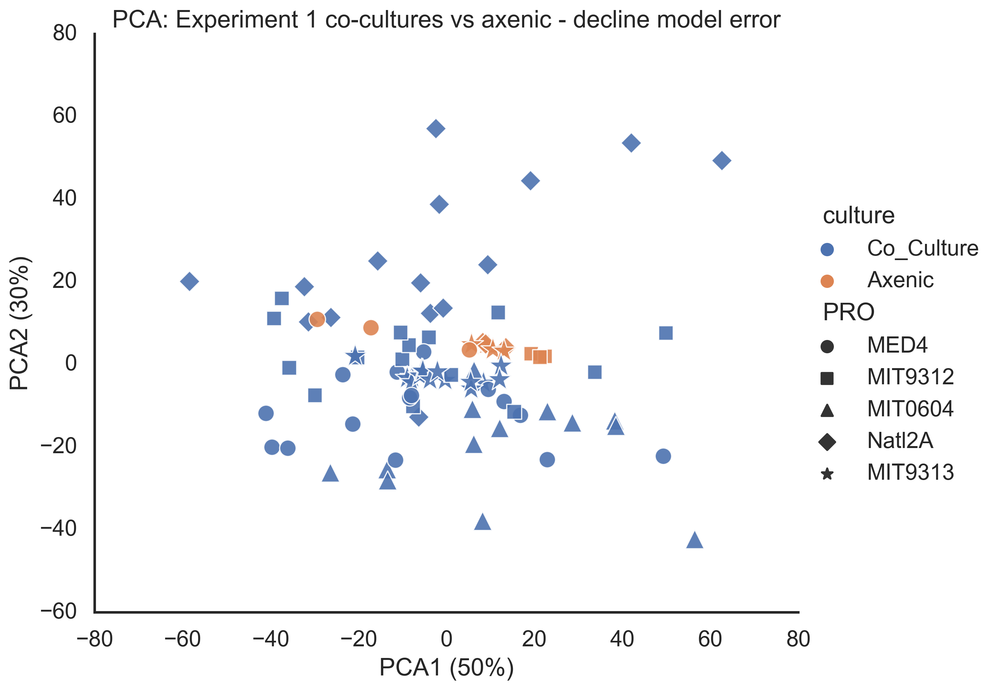

In [142]:
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', #hue='PRO', 
        hue='culture', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            size='PRO', size_order=porder,
                 sizes=psizes, 
            #     s=150,
                 alpha=0.9, height=7, aspect=1.2,
            #palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (50%)')
plt.ylabel('PCA2 (30%)')
plt.title('PCA: Experiment 1 co-cultures vs axenic - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.56471005 0.20991271]


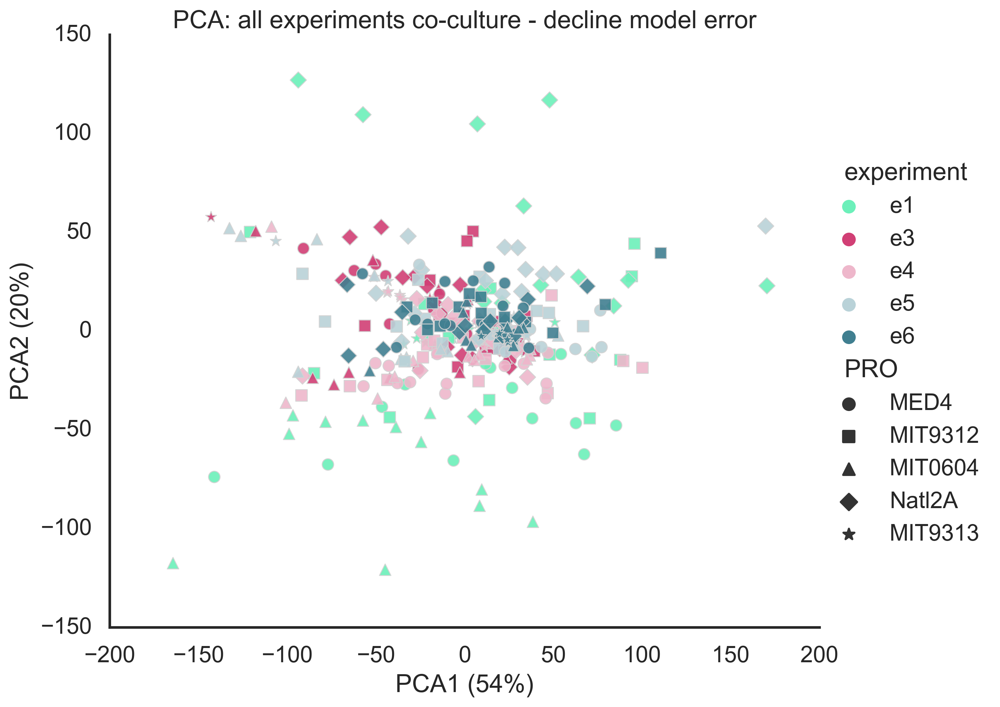

In [143]:
df1 = dferrm.loc[#(dfresm.experiment == 'e1') & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dferrm.culture.isin(['Co_Culture',])) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (54%)')
plt.ylabel('PCA2 (20%)')
plt.title('PCA: all experiments co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.50273342 0.31016304]


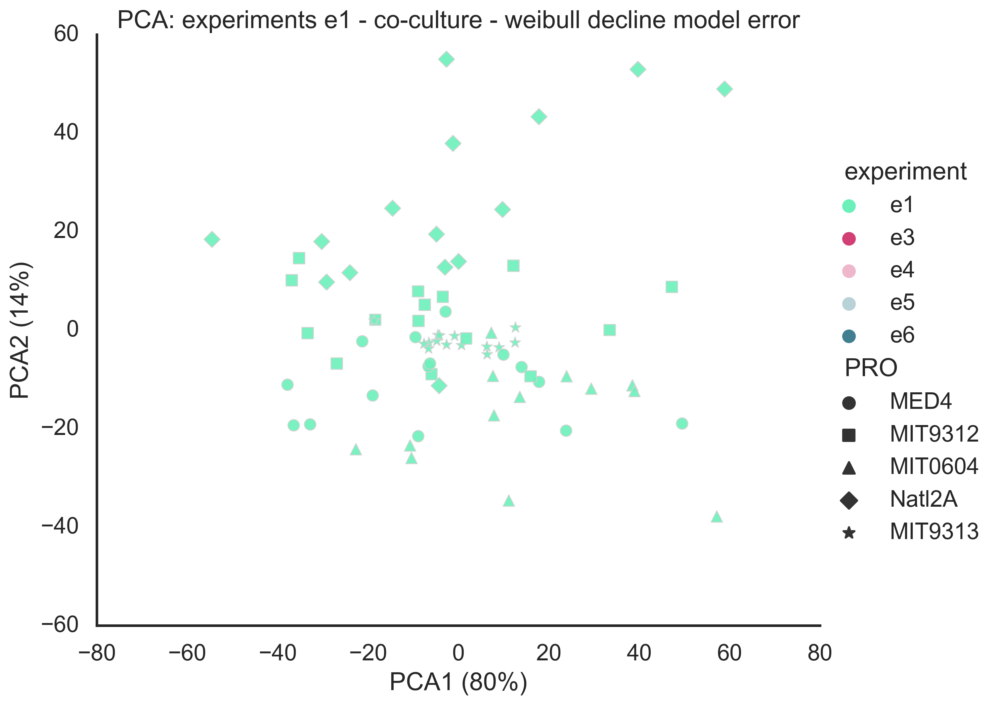

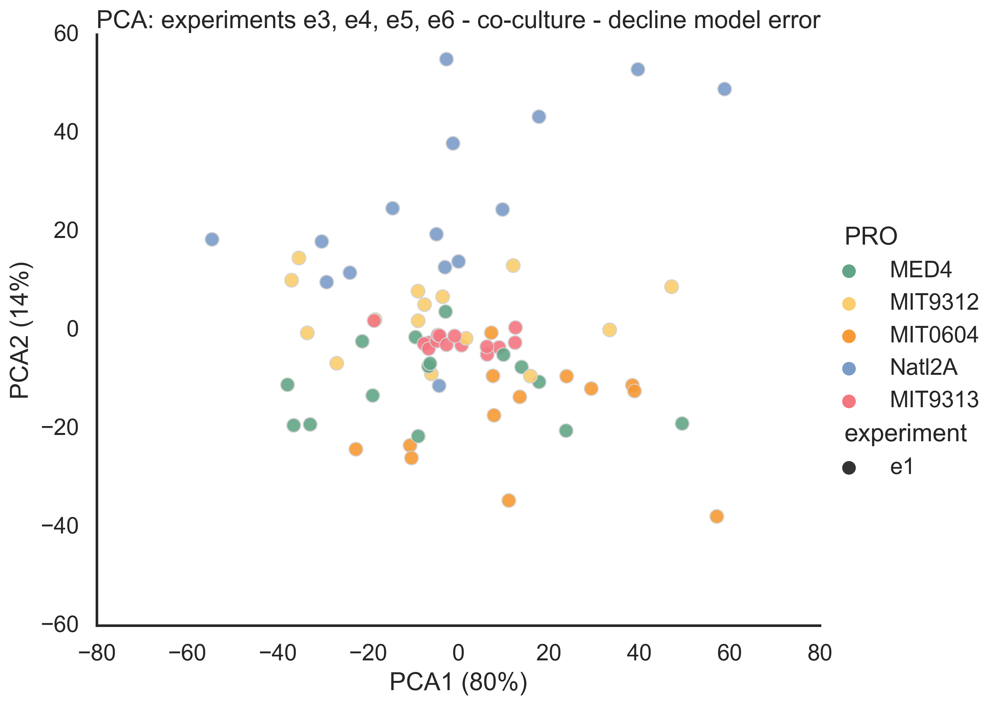

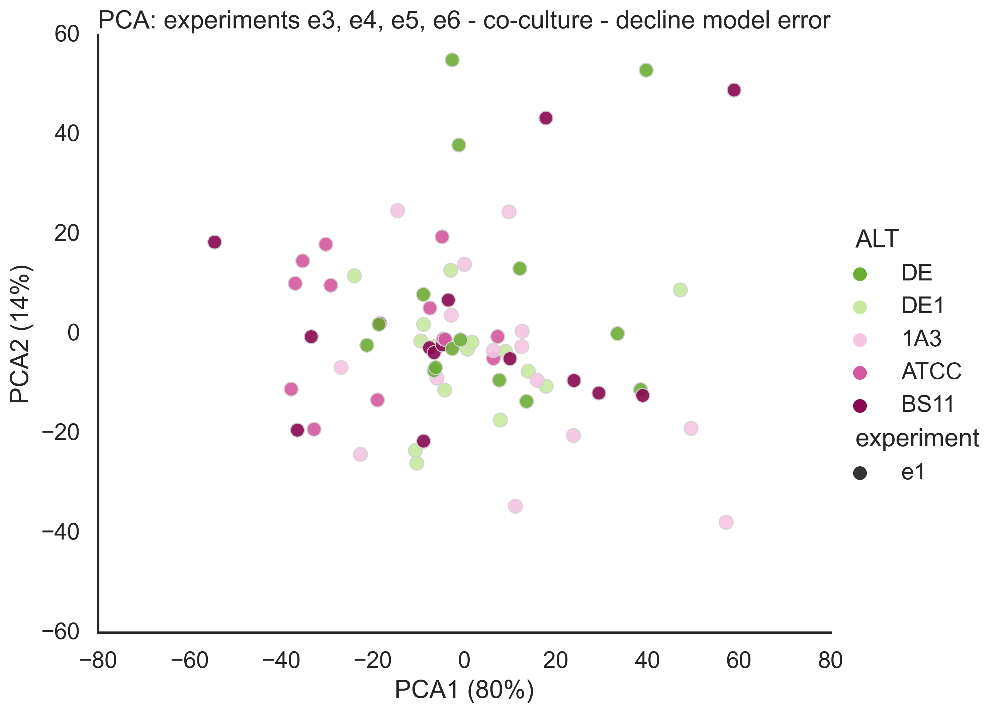

In [144]:
df1 = dferrm.loc[(dferrm.experiment.isin(['e1'])) & 
                                #(~dfresm.ALT.isin(['Ax_Pro'])) &
                 (dferrm.culture.isin(['Co_Culture',])) &
                            (dferrm['variable'].isin(['weibull_error'])) 
                           ]
sample_col = 'experiment_sample'
#dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
X = cp.experiments2X(df1, value_col='value', cumsummode=True)
metadf = cp.get_meta(df1, value_col='value')
#metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
sns.set_context('talk')
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='experiment', 
            style='PRO',
            style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=70,
                 alpha=0.9, height=7, aspect=1.2,
            palette=epallete, hue_order=eorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e1 - co-culture - weibull decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])
plt.show()
ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='ALT', 
            style='experiment',
            #style_order=porder, markers=pmarkers,
            #size='PRO', size_order=porder,
            #     sizes=psizes, 
                 s=100,
                 alpha=0.9, height=7, aspect=1.2,
            palette=apallete, hue_order=aorder ,edgecolor='lightgrey', 
           )
plt.xlabel('PCA1 (80%)')
plt.ylabel('PCA2 (14%)')
plt.title('PCA: experiments e3, e4, e5, e6 - co-culture - decline model error')
for lh in ax._legend.legendHandles: 
    lh.set_sizes([70])

Variance percent explained
 [0.50273342 0.31016304]


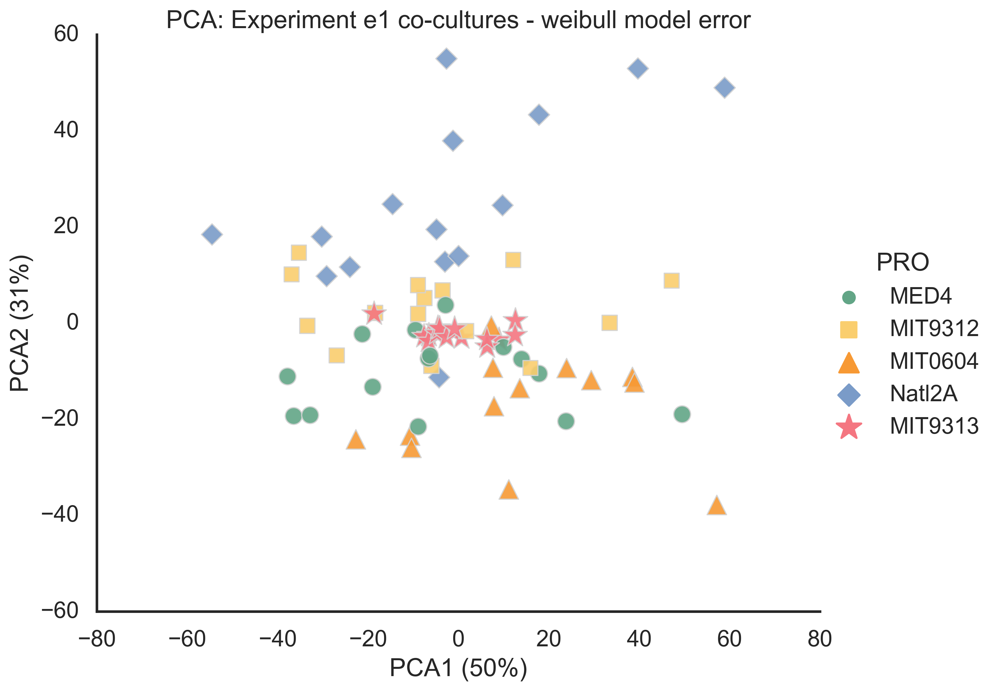

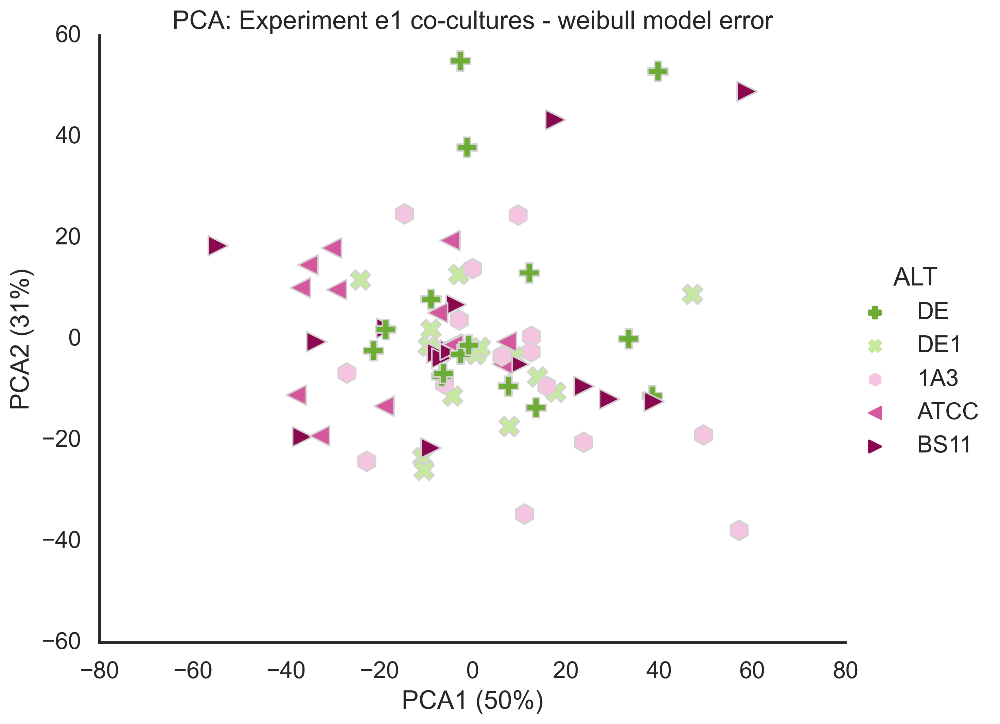

Variance percent explained
 [0.56438197 0.19032367]


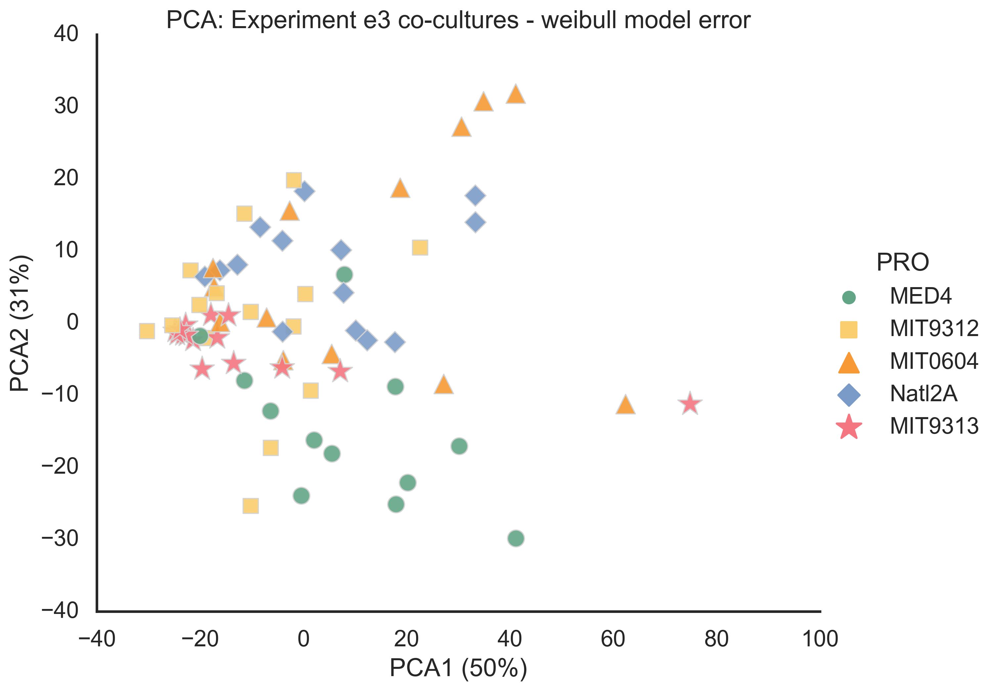

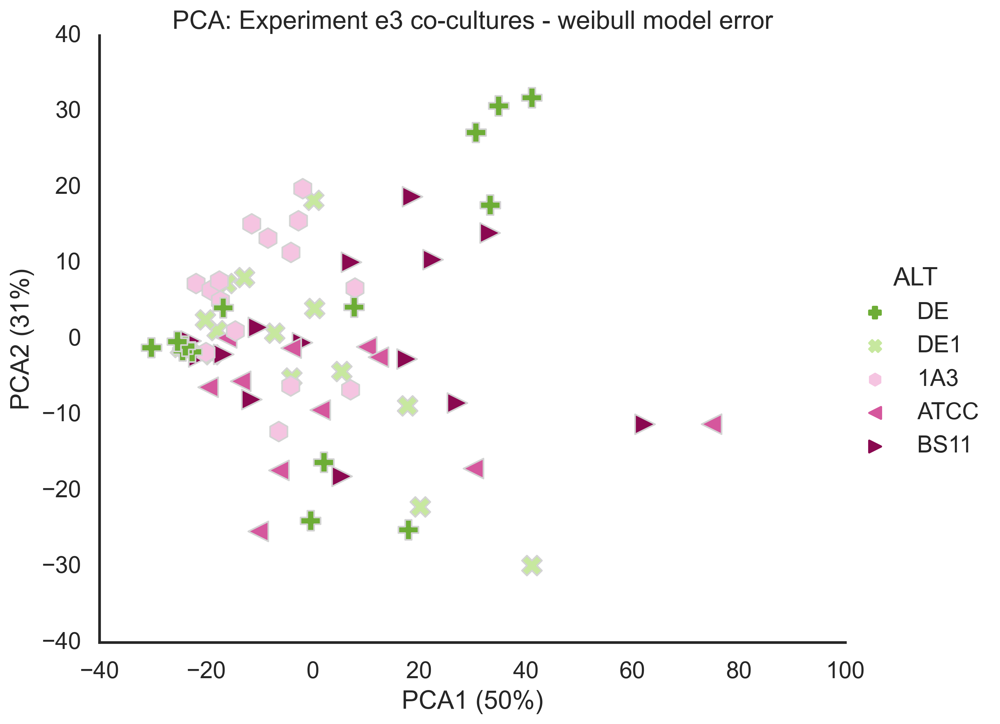

Variance percent explained
 [0.74832129 0.13042928]


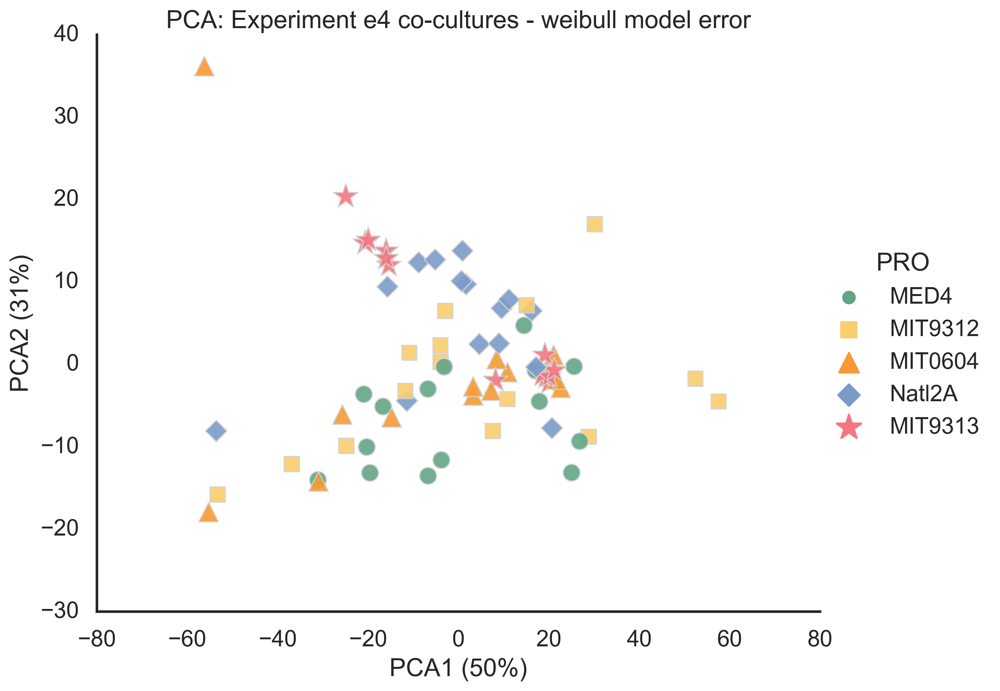

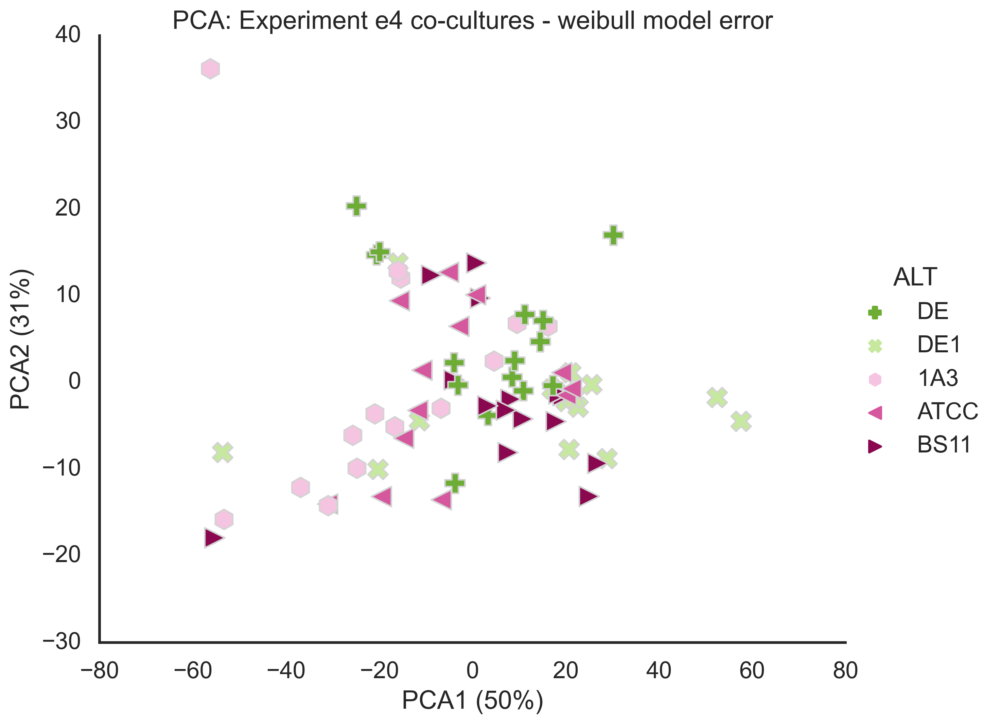

Variance percent explained
 [0.67953546 0.17125992]


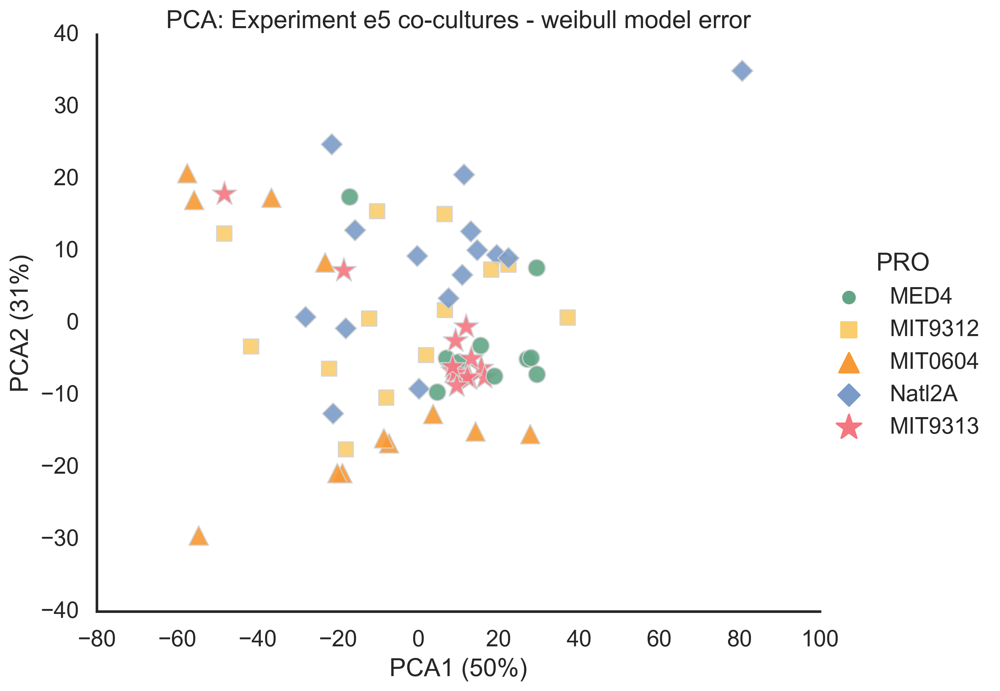

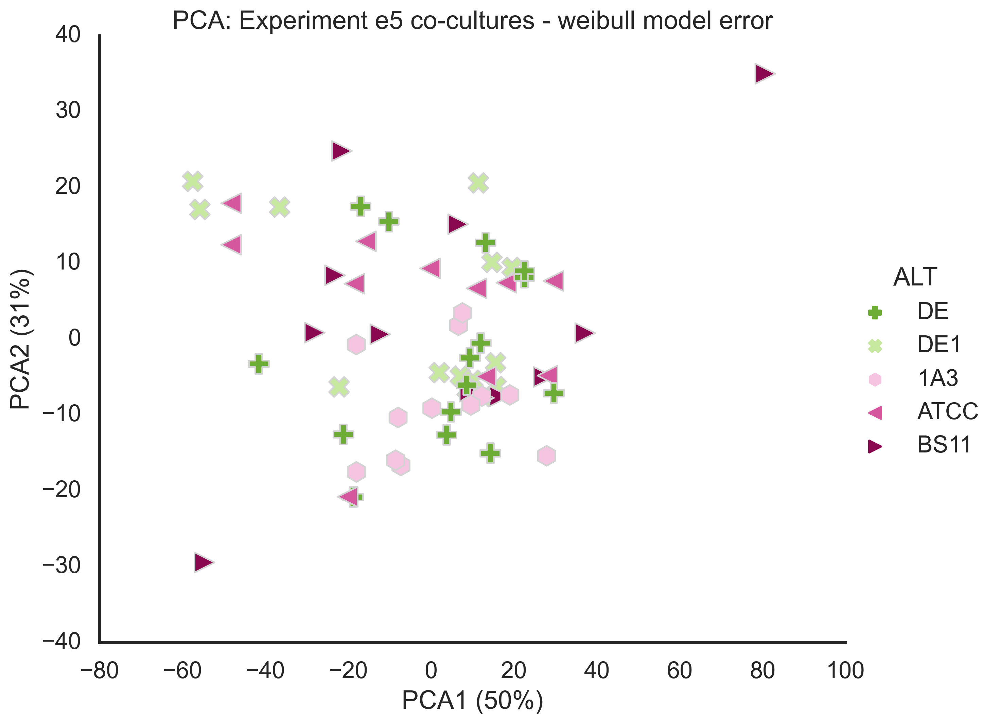

Variance percent explained
 [0.67550058 0.14279682]


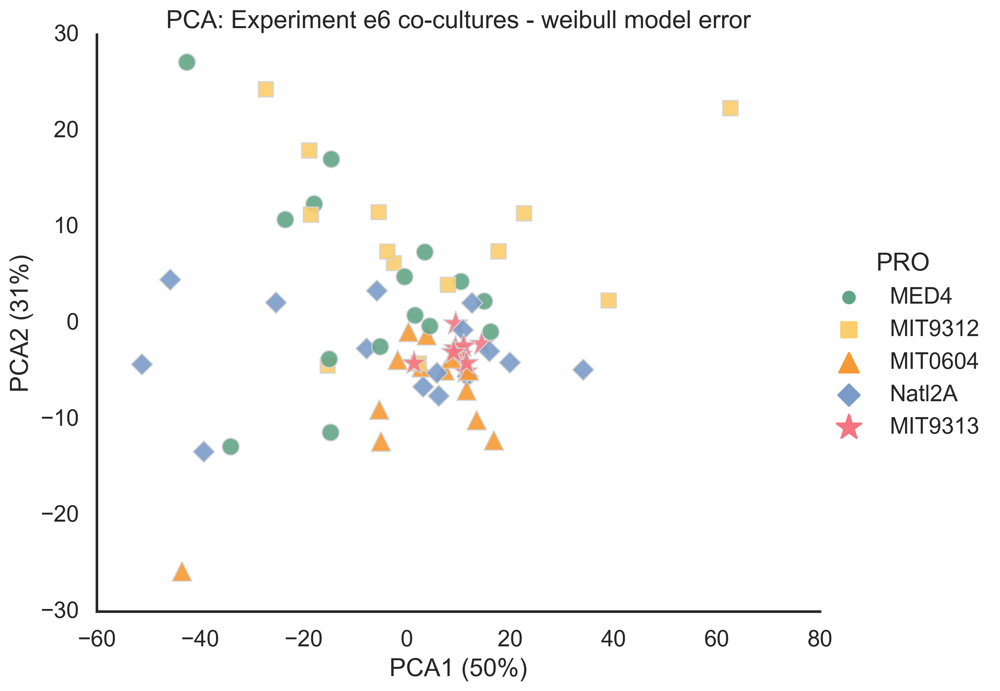

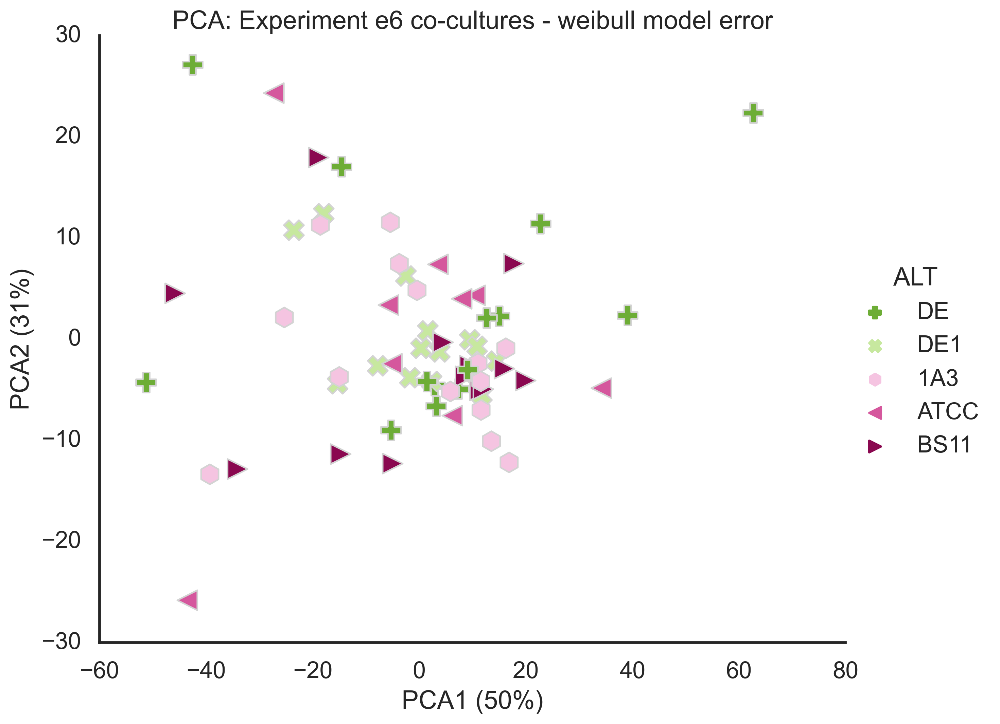

In [145]:
for e in eorder:
    df1 = dferrm.loc[(dferrm.experiment == e) & 
                                    #(~dfresm.ALT.isin(['Ax_Pro'])) &
                     (dferrm.culture.isin(['Co_Culture'])) &
                                (dferrm['variable'].isin(['weibull_error'])) 
                               ]
    sample_col = 'experiment_sample'
    #dfe_resample3 = cp.resample_df(dfe, value_col=value_col, period='5d')
    X = cp.experiments2X(df1, value_col='value', cumsummode=True)
    metadf = cp.get_meta(df1, value_col='value')
    #metadf['sample_experiment'] = metadf['sample']+ ','+ metadf['experiment']
    dfpca = cp.run_pca(X=X, metadf=metadf, sample_col=sample_col)
    sns.set_context('talk')
    ax = sns.relplot(data=dfpca, x='PCA1', y='PCA2', hue='PRO', 
            #style='culture', 
                style='PRO',
                style_order=porder, markers=pmarkers,
                size='PRO', size_order=porder,
                     sizes=psizes, 
                     alpha=0.9, height=7, aspect=1.2,
                palette=ppallete, hue_order=porder ,edgecolor='lightgrey', 
                     col='culture',
               )
    plt.xlabel('PCA1 (50%)')
    plt.ylabel('PCA2 (31%)')
    plt.title(f'PCA: Experiment {e} co-cultures - weibull model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
        plt.show()
    
    ax = sns.relplot(data=dfpca.loc[dfpca.culture.isin(['Co_Culture'])], x='PCA1', y='PCA2', hue='ALT', 
                #style='culture', 
                style='ALT',
                style_order=aorder, #markers=['p','h','<','v','>'],
                     markers=amarkers,
                s=200, #alpha=0.9, 
                     height=7, aspect=1.2,
                palette=apallete, 
                     hue_order=aorder ,edgecolor='lightgrey', 

                     #facet_kws=dict(subplot_kws=dict(fillstyle='none')) #fillstyle='none',
                     #facecolors= 'none'
               )
    plt.xlabel('PCA1 (50%)')
    plt.ylabel('PCA2 (31%)')
    plt.title(f'PCA: Experiment {e} co-cultures - weibull model error')
    for lh in ax._legend.legendHandles: 
        lh.set_sizes([70])
    plt.show()
    

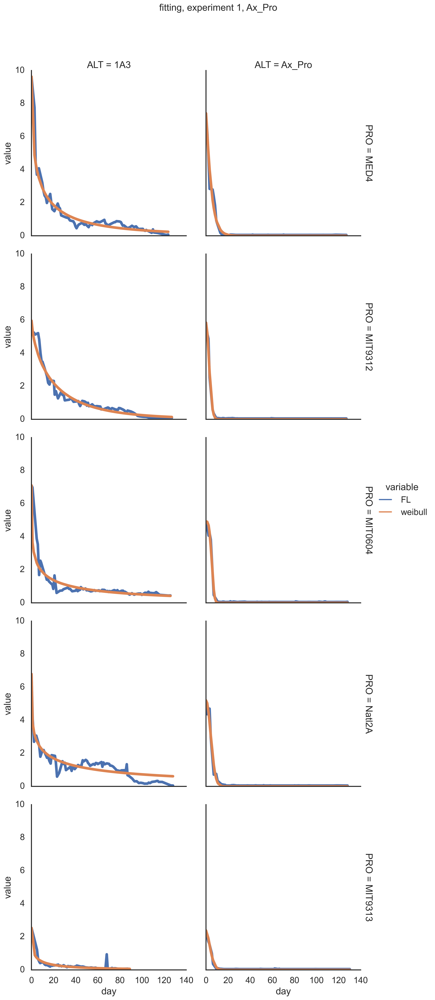

In [146]:
sns.set_context('talk')
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']

#for a in ['Ax_Pro', '1A3']:
#    for e in ['e1']:
sns.relplot(data=dfresm.loc[(dfresm.experiment == 'e1') & (dfresm.ALT.isin(['1A3', 'Ax_Pro'])) &
                            (dfresm['sample'].str.endswith('C')) &
                            (dfresm['variable'].isin(['FL', 'weibull'])) 
                            
                           #(dfresm['sample'].isin(['21C', '30C']))
                           ], 
        x='day',
        y='value',
        hue='variable',
        row='PRO',
            col='ALT',
            col_order=['1A3','Ax_Pro'],
            row_order=porder ,
        #col_wrap=5,
        kind='line',
            #aspect=1.4
            facet_kws=dict(margin_titles=True),
            linewidth=5,
       )
plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()

In [147]:
dfresm['alt'] = dfresm['sample'] +', '+dfresm['ALT']
for p in dfresm.PRO.unique():
    for e in dfresm.experiment.unique():
        sns.relplot(data=dfresm.loc[(dfresm.experiment == e) & (dfresm.PRO == p)], 
                x='day',
                y='value',
                hue='variable',
                    order = models,
                    palette=mpalette,
                col='alt',
                col_wrap=6,
                kind='line',
               )
        plt.suptitle(f'fitting, experiment {e}, {p}', y=1)
        plt.show()

ValueError: The palette list has the wrong number of colors.

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
#    for e in dfresm.experiment.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'exponential', 'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'exponential fit', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[:16]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[(best_model_df.model == 'harmonic') & (best_model_df.experiment == 'e1'),
                                        'experiment_sample']
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples[-16:]) & 
                           (dfresm.experiment == 'e1')
                           ], 
                x='day',
                y='value',
                hue='variable',
                col='a',
                col_wrap=4,
                kind='line',
               )
plt.suptitle(f'harmonic fit e1', y=1)
plt.show()

In [ ]:
sns.set_context('talk')
dfresm['a'] = dfresm['experiment_sample'] +', '+dfresm['PRO']+', '+dfresm['ALT']
#for p in dfresm.PRO.unique():
exponential_samples = best_model_df.loc[best_model_df.model == 'harmonic', 'experiment_sample']
for e in dfresm.experiment.unique():
    sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(exponential_samples) & 
                               (dfresm.experiment == e)
                               ], 
                    x='day',
                    y='value',
                    hue='variable',
                    col='a',
                    col_wrap=8,
                    kind='line',
                   )
    plt.suptitle(f'harmonic fit {e}', y=1)
    plt.show()

In [ ]:
exponential_samples

In [ ]:
dfresm.columns

In [ ]:
dfscore.columns

In [ ]:
dfscore['f'].describe()

In [ ]:
dfscore.loc[(dfscore.f > 0.45) &(dfscore.f < 0.55) & (np.abs(dfscore.a1 - dfscore.a2) > 0.2
                                ), ['experiment_sample','PRO', 'ALT',   'a1', 'a2','f','rmse_biexponential',]
           ].nsmallest(10, 'rmse_biexponential',)

In [ ]:
dfscore.loc[dfscore.experiment_sample.isin(['e5, 13B']), #['harmonic_popt_0',]
           ]

In [ ]:
s = ['e6, 1A', 'e5, 13B']
order_list = ['FL', 'exponential', 'weibull',
              'biexponential']
order_list=models
#sns.set(font_scale=1.5, style='white', context='poster')
sns.relplot(data=dfresm.loc[dfresm.experiment_sample.isin(s) &
                            (dfresm['variable'].isin(order_list)) 
                           ], 
        x='day',
        y='value',
        hue='variable',
        style='variable',
            col='a',
           # col_wrap=3,
        kind='line',
            linewidth=3,
            hue_order=order_list,
            style_order=order_list,
            aspect=1,
            #palette=['black', mpalette[0], mpalette[3]] ,
            #legend=False
       ).set_axis_labels('Day','FL' #).set(xlim=(0,40),#yticks=[0,3,6], 
                                        #xticks=[0,70,140], 
    #ylim=(1e-2,10),
     #                                    yscale='log'
                                        ).set_titles('{col_name}')# .set(font_scale=2)
#plt.suptitle(f'fitting, experiment 1, {a}', y=1.05)
plt.show()